# Import packages

In [1]:
# Reading/Writing Data
import os
import glob
import numpy as np
import math 
import matplotlib.pyplot as plt

# Pytorch
import torch 
from torch.utils.data import DataLoader, random_split

# Self-Defined Package
from SMAPDataset import SMAPDataset
from SMCNN import SMCNN
from SDLoss import self_defined_loss, ab_physics_loss
from Preprocessing import random_spatial_sequence, collate_fn, collate_insitu_validation

C:\Users\jianer\anaconda3\envs\datamining\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Some Utility Functions

In [2]:
def same_seed(seed): 
    '''Fixes random number generator seeds for reproducibility.'''
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

# Configurations
`config` contains hyper-parameters for training and the path to save your model.

In [3]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 11611801,      # Your seed number, you can pick your lucky number. :)
    'is_train': True,
    'test_ratio': 0.2,
    'valid_ratio': 0.1,   # validation_size = train_size * valid_ratio
    'n_epochs': 5000,     # Number of epochs.            
    'train_batch_size': 71*2, 
    'valid_batch_size': 78,
    'test_batch_size': 1,
    'sim_threshold': 0.8,
    'learning_rate': 5e-4,
    'step_size': 15,
    'gamma': 0.5,
    'momentum': 0.9,
    'early_stop': 200,    # If model has not improved for this many consecutive epochs, stop training.     
    'root': 'D:\\1GRADUATED\\paper\\downscaling_data\\Soil_moisture_downscale_czt\\DATASET\\AB',
    'model_save_dir': 'D:\\1GRADUATED\\paper\\downscaling_data\\Soil_moisture_downscale_czt\\DATASET\\AB\\OUTPUT\\MODELS\\CNN'
}

# Dataloader
Read data from files and set up training, validation, and testing sets.

In [4]:
# # Set seed for reproducibility
same_seed(config['seed'])

In [5]:
# 创建数据集
dataset = SMAPDataset(config['root'])

D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABEL\ATI\GRID
***************************Load data path******************************
valid day sequence: ['2015104', '2015106', '2015114', '2015115', '2015117', '2015128', '2015130', '2015131', '2015136', '2015138', '2015141', '2015149', '2015154', '2015157', '2015160', '2015162', '2015163', '2015165', '2015171', '2015176', '2015186', '2015187', '2015189', '2015194', '2015195', '2015197', '2015200', '2015202', '2015203', '2015205', '2015208', '2015211', '2015213', '2015216', '2015221', '2015226', '2015229', '2015232', '2015234', '2015235', '2015237', '2015242', '2015243', '2015258', '2015259', '2015261', '2015267', '2015272', '2015275', '2015277', '2015280', '2015282', '2015283', '2015285', '2015288', '2015290', '2015291', '2015296', '2015325', '2015330', '2015333']
_______________________________2015104_______________________________
_____________________________smap cell: 1_____________________________
D:\1

D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABEL\ATI\GRID\2015216\4.npy
_____________________________smap cell: 5_____________________________
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\INPUT\SMAP\2015216\5.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\INPUT\TEXTURE\5.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABEL\SMAP\2015216\5.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABEL\ATI\GRID\2015216\5.npy
_______________________________2015221_______________________________
_____________________________smap cell: 15_____________________________
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\INPUT\SMAP\2015221\15.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\INPUT\TEXTURE\15.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABE

D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\INPUT\TEXTURE\54.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABEL\SMAP\2015288\54.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABEL\ATI\GRID\2015288\54.npy
_____________________________smap cell: 55_____________________________
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\INPUT\SMAP\2015288\55.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\INPUT\TEXTURE\55.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABEL\SMAP\2015288\55.npy
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\LABEL\ATI\GRID\2015288\55.npy
_____________________________smap cell: 56_____________________________
D:\1GRADUATED\paper\downscaling_data\Soil_moisture_downscale_czt\DATASET\AB\INPUT\SMAP\2015288\56.npy
D:\1GRADUATED\paper\downscaling_data\Soil_

In [6]:
# 计算训练集和测试集的长度
train_len = int(len(dataset) * (1-config['test_ratio']))
test_len = len(dataset) - train_len

# 使用 random_split 函数进行划分
train_dataset, test_dataset = random_split(dataset, [train_len, test_len])

# 计算训练集和验证集的长度
valid_len = int(train_len * (config['valid_ratio']))
train_len = train_len - valid_len

# 使用 random_split 函数进行划分
train_dataset, valid_dataset = random_split(train_dataset, [train_len, valid_len])

# 创建数据加载器
train_loader = DataLoader(train_dataset, batch_size=config['train_batch_size'], shuffle=True, collate_fn=collate_fn)
valid_loader = DataLoader(valid_dataset, batch_size=config['valid_batch_size'], shuffle=True, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=config['test_batch_size'], shuffle=False, collate_fn=collate_fn)

print('training size', len(train_dataset))
print('validing size', len(valid_dataset))
print('testing size', len(test_dataset))

training size 710
validing size 78
testing size 197


# Training Loop

In [7]:
def trainer(train_loader, valid_loader, model, config, device):
    relu = torch.nn.ReLU(inplace=True)
    criterion = self_defined_loss 
    optimizer = torch.optim.SGD(model.parameters(), weight_decay=0.01, lr=config['learning_rate'], momentum=config['momentum']) 
    
    # learning rate decay
    RLRP = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=config['gamma'], patience=config['step_size'], threshold=0.03)

    n_epochs, best_loss, step, early_stop_count = config['n_epochs'], math.inf, 0, 0

    for epoch in range(n_epochs):
        if epoch==200:
            config['sim_threshold'] = 0.93
        model.train() # Set your model to train mode.
        
        loss_record = []
        physical_loss_record = []
        sim_loss_record = []
        for data_pkg in train_loader:
            x = data_pkg['processed_data']
            optimizer.zero_grad()               
            pred = model(x)
            relu(pred[:, 0])
#             print(pred)
#             x, pred = x.to(device), pred.to(device)  
            physical_loss, sim_loss = criterion(pred, data_pkg['label_data'], 'Training', config['sim_threshold'])
            loss = physical_loss + sim_loss
            loss.backward()                     
            optimizer.step()                   
            step += 1
            
            physical_loss_record.append(physical_loss.detach().item())
            sim_loss_record.append(sim_loss.detach().item())
            loss_record.append(loss.detach().item())
         
        mean_train_physical_loss = sum(physical_loss_record)/len(physical_loss_record)
        mean_train_sim_loss = sum(sim_loss_record)/len(sim_loss_record)
        mean_train_loss = sum(loss_record)/len(loss_record)

        model.eval() 
        loss_record = []
        physical_loss_record = []
        sim_loss_record = []
        for data_pkg in valid_loader:
            x = data_pkg['processed_data']
            with torch.no_grad():
                pred = model(x)
                relu(pred[:, 0])
#             x, pred = x.to(device), pred.to(device)  
                physical_loss, sim_loss = criterion(pred, data_pkg['label_data'], 'Validing', config['sim_threshold'])
                loss = physical_loss + sim_loss
            
            physical_loss_record.append(physical_loss.item())
            sim_loss_record.append(sim_loss.item())
            loss_record.append(loss.item())

        mean_valid_physical_loss = sum(physical_loss_record)/len(physical_loss_record)
        mean_valid_sim_loss = sum(sim_loss_record)/len(sim_loss_record)
        mean_valid_loss = sum(loss_record)/len(loss_record)
        
        current_lr = (optimizer.param_groups[0])['lr']
        print(f'Epoch [{epoch+1}/{n_epochs}] (LR: {current_lr}):')
        print(f'Train loss: {mean_train_loss:.4f} || Train physical loss: {mean_train_physical_loss:.4f} || Train similarity loss: {mean_train_sim_loss:.4f}')
        print(f'Valid loss: {mean_valid_loss:.4f} || Valid physical loss: {mean_valid_physical_loss:.4f} || Valid similarity loss: {mean_valid_sim_loss:.4f}')
            
        if mean_valid_loss < best_loss:
            best_loss = mean_valid_loss
            _name = str(best_loss)
            _name = 'first'
            torch.save(model.state_dict(), os.path.join(config['model_save_dir'], _name + '.ckpt')) # Save your best model
            print('Saving model with loss {:.3f}...'.format(best_loss))
            early_stop_count = 0
        else: 
            early_stop_count += 1

        if early_stop_count >= config['early_stop']:
            print('\nModel is not improving, so we halt the training session.')
            _name = str(best_loss)
            _name = 'last'
            torch.save(model.state_dict(), os.path.join(config['model_save_dir'], _name + '.ckpt')) # Save your best model
            return
        #         StepLR.step()
        RLRP.step(mean_valid_loss)

# Start training!

(11, 11, 19)
SMCNN(
  (cnn): Sequential(
    (0): Conv2d(19, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
  )
  (fc): Sequential(
    (0): Linear(in_features=3872, out_features=4, bias=True)
    (1): ReLU()
    (2): Linear(in_features=4, out_features=2, bias=True)
  )
)


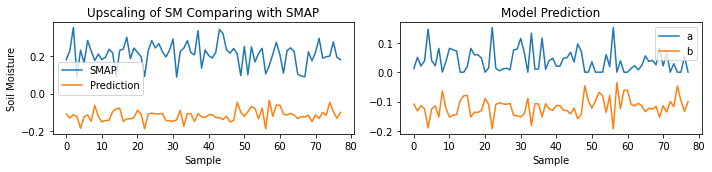

Epoch [1/5000] (LR: 0.0005):
Train loss: 1.0030 || Train physical loss: 0.1270 || Train similarity loss: 0.8760
Valid loss: 1.0562 || Valid physical loss: 0.1099 || Valid similarity loss: 0.9463
Saving model with loss 1.056...


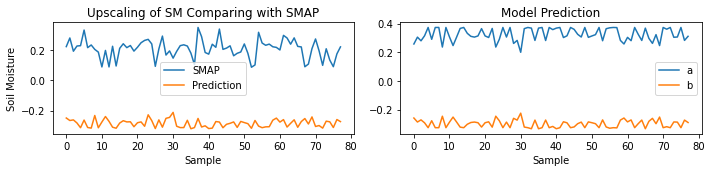

Epoch [2/5000] (LR: 0.0005):
Train loss: 0.4576 || Train physical loss: 0.1330 || Train similarity loss: 0.3246
Valid loss: 1.1911 || Valid physical loss: 0.2463 || Valid similarity loss: 0.9448


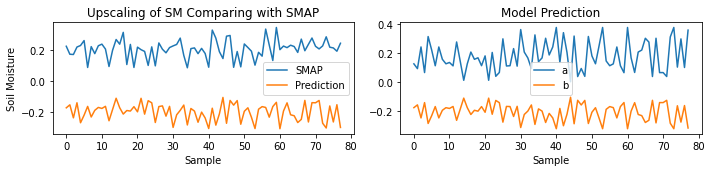

Epoch [3/5000] (LR: 0.0005):
Train loss: 0.4364 || Train physical loss: 0.1130 || Train similarity loss: 0.3234
Valid loss: 1.0541 || Valid physical loss: 0.1748 || Valid similarity loss: 0.8794
Saving model with loss 1.054...


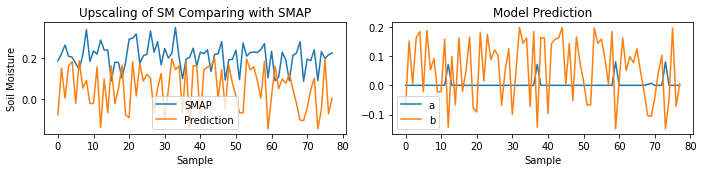

Epoch [4/5000] (LR: 0.0005):
Train loss: 0.2324 || Train physical loss: 0.0703 || Train similarity loss: 0.1621
Valid loss: 0.9278 || Valid physical loss: 0.0376 || Valid similarity loss: 0.8902
Saving model with loss 0.928...


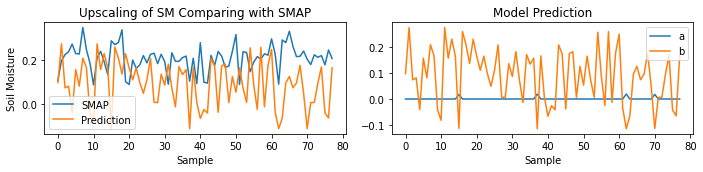

Epoch [5/5000] (LR: 0.0005):
Train loss: 0.5517 || Train physical loss: 0.0527 || Train similarity loss: 0.4990
Valid loss: 0.9187 || Valid physical loss: 0.0277 || Valid similarity loss: 0.8910
Saving model with loss 0.919...


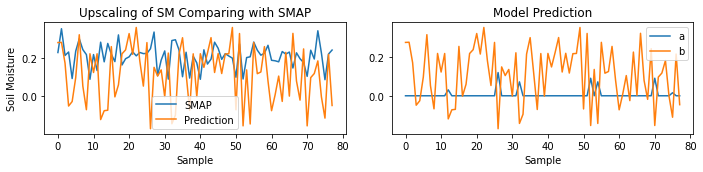

Epoch [6/5000] (LR: 0.0005):
Train loss: 0.8753 || Train physical loss: 0.0316 || Train similarity loss: 0.8436
Valid loss: 0.8866 || Valid physical loss: 0.0320 || Valid similarity loss: 0.8545
Saving model with loss 0.887...


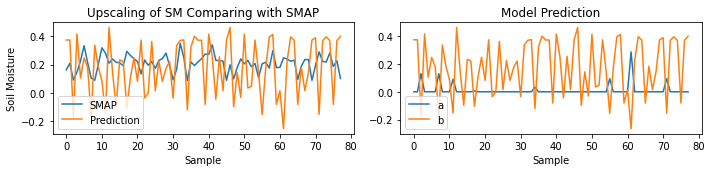

Epoch [7/5000] (LR: 0.0005):
Train loss: 0.3745 || Train physical loss: 0.0499 || Train similarity loss: 0.3246
Valid loss: 0.8530 || Valid physical loss: 0.0425 || Valid similarity loss: 0.8106
Saving model with loss 0.853...


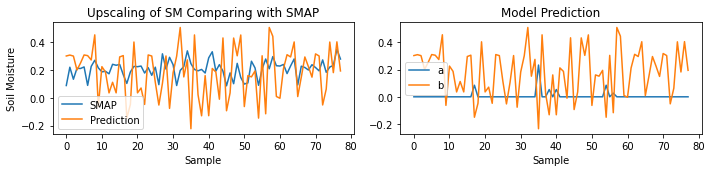

Epoch [8/5000] (LR: 0.0005):
Train loss: 0.2161 || Train physical loss: 0.0531 || Train similarity loss: 0.1630
Valid loss: 0.8602 || Valid physical loss: 0.0352 || Valid similarity loss: 0.8251


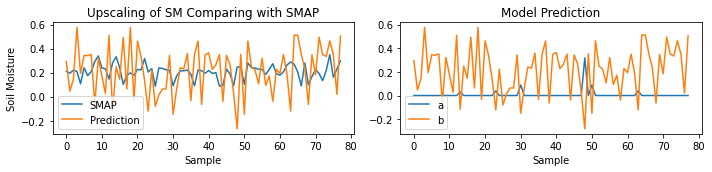

Epoch [9/5000] (LR: 0.0005):
Train loss: 0.6956 || Train physical loss: 0.0455 || Train similarity loss: 0.6501
Valid loss: 0.8518 || Valid physical loss: 0.0410 || Valid similarity loss: 0.8108
Saving model with loss 0.852...


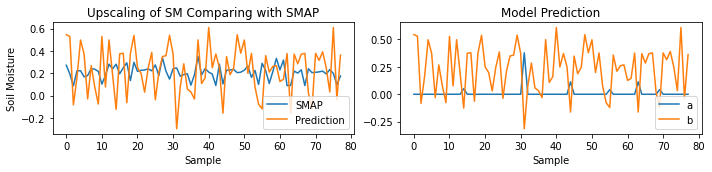

Epoch [10/5000] (LR: 0.0005):
Train loss: 0.3735 || Train physical loss: 0.0521 || Train similarity loss: 0.3214
Valid loss: 0.8472 || Valid physical loss: 0.0464 || Valid similarity loss: 0.8008
Saving model with loss 0.847...


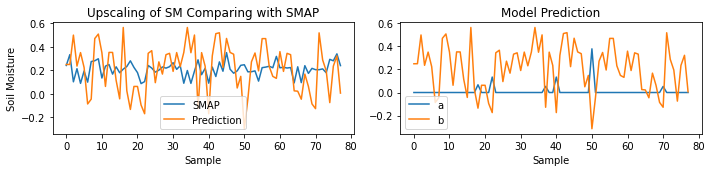

Epoch [11/5000] (LR: 0.0005):
Train loss: 0.3747 || Train physical loss: 0.0524 || Train similarity loss: 0.3223
Valid loss: 0.8491 || Valid physical loss: 0.0426 || Valid similarity loss: 0.8064


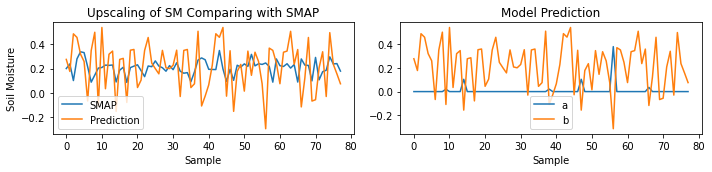

Epoch [12/5000] (LR: 0.0005):
Train loss: 0.5349 || Train physical loss: 0.0487 || Train similarity loss: 0.4862
Valid loss: 0.8533 || Valid physical loss: 0.0395 || Valid similarity loss: 0.8138


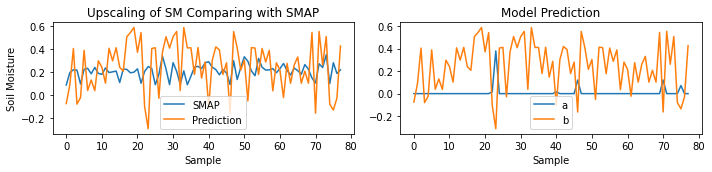

Epoch [13/5000] (LR: 0.0005):
Train loss: 0.6932 || Train physical loss: 0.0496 || Train similarity loss: 0.6436
Valid loss: 0.0490 || Valid physical loss: 0.0490 || Valid similarity loss: 0.0000
Saving model with loss 0.049...


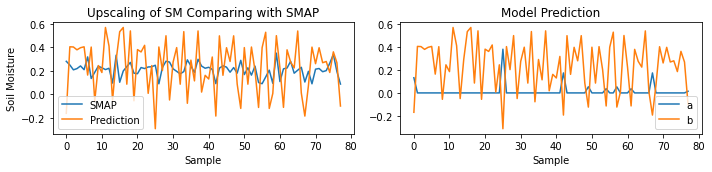

Epoch [14/5000] (LR: 0.0005):
Train loss: 0.3792 || Train physical loss: 0.0560 || Train similarity loss: 0.3232
Valid loss: 0.0498 || Valid physical loss: 0.0498 || Valid similarity loss: 0.0000


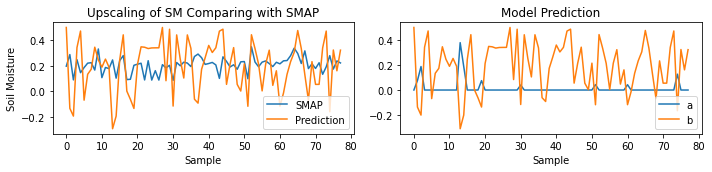

Epoch [15/5000] (LR: 0.0005):
Train loss: 0.2137 || Train physical loss: 0.0533 || Train similarity loss: 0.1603
Valid loss: 0.8487 || Valid physical loss: 0.0417 || Valid similarity loss: 0.8070


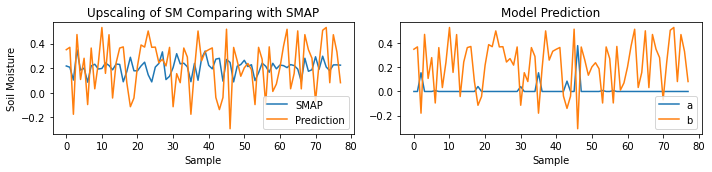

Epoch [16/5000] (LR: 0.0005):
Train loss: 0.5329 || Train physical loss: 0.0501 || Train similarity loss: 0.4827
Valid loss: 0.8492 || Valid physical loss: 0.0428 || Valid similarity loss: 0.8064


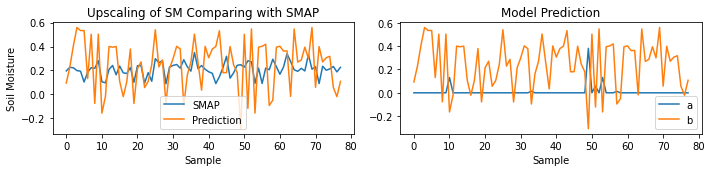

Epoch [17/5000] (LR: 0.0005):
Train loss: 0.5353 || Train physical loss: 0.0504 || Train similarity loss: 0.4849
Valid loss: 0.8498 || Valid physical loss: 0.0461 || Valid similarity loss: 0.8037


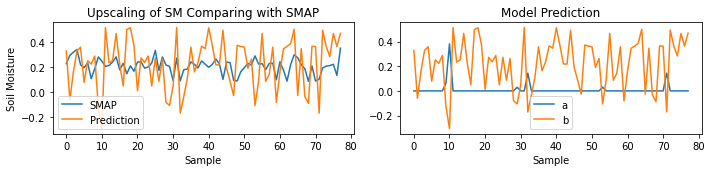

Epoch [18/5000] (LR: 0.0005):
Train loss: 0.2115 || Train physical loss: 0.0502 || Train similarity loss: 0.1613
Valid loss: 0.8521 || Valid physical loss: 0.0403 || Valid similarity loss: 0.8118


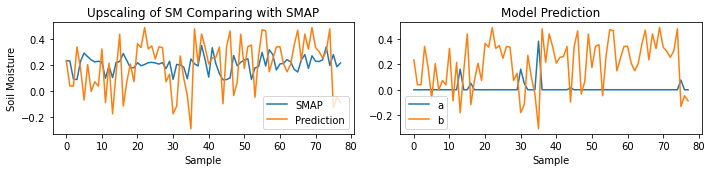

Epoch [19/5000] (LR: 0.0005):
Train loss: 0.5350 || Train physical loss: 0.0463 || Train similarity loss: 0.4886
Valid loss: 0.8541 || Valid physical loss: 0.0375 || Valid similarity loss: 0.8166


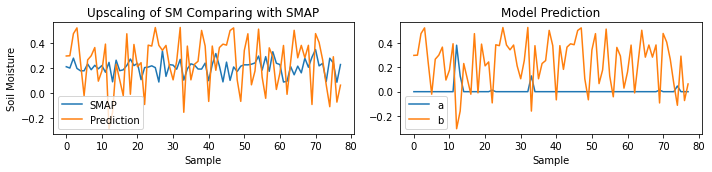

Epoch [20/5000] (LR: 0.0005):
Train loss: 0.5336 || Train physical loss: 0.0458 || Train similarity loss: 0.4878
Valid loss: 0.8533 || Valid physical loss: 0.0414 || Valid similarity loss: 0.8119


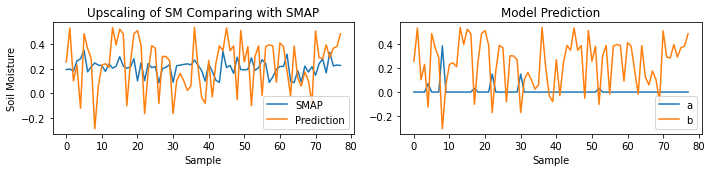

Epoch [21/5000] (LR: 0.0005):
Train loss: 0.3736 || Train physical loss: 0.0484 || Train similarity loss: 0.3251
Valid loss: 0.8510 || Valid physical loss: 0.0430 || Valid similarity loss: 0.8080


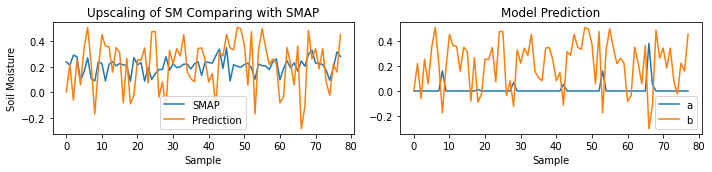

Epoch [22/5000] (LR: 0.0005):
Train loss: 0.3716 || Train physical loss: 0.0473 || Train similarity loss: 0.3243
Valid loss: 0.8533 || Valid physical loss: 0.0384 || Valid similarity loss: 0.8149


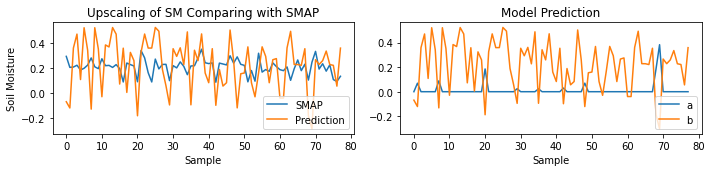

Epoch [23/5000] (LR: 0.0005):
Train loss: 0.6926 || Train physical loss: 0.0459 || Train similarity loss: 0.6468
Valid loss: 0.8501 || Valid physical loss: 0.0411 || Valid similarity loss: 0.8089


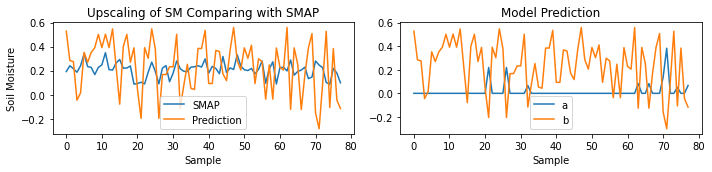

Epoch [24/5000] (LR: 0.0005):
Train loss: 0.3736 || Train physical loss: 0.0503 || Train similarity loss: 0.3233
Valid loss: 0.0475 || Valid physical loss: 0.0475 || Valid similarity loss: 0.0000
Saving model with loss 0.048...


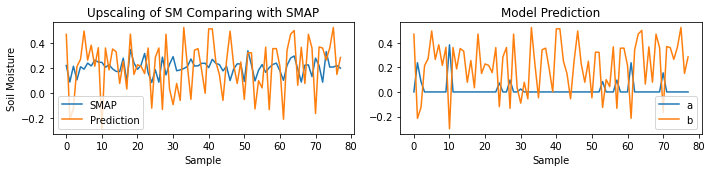

Epoch [25/5000] (LR: 0.0005):
Train loss: 0.2129 || Train physical loss: 0.0524 || Train similarity loss: 0.1605
Valid loss: 0.8459 || Valid physical loss: 0.0434 || Valid similarity loss: 0.8025


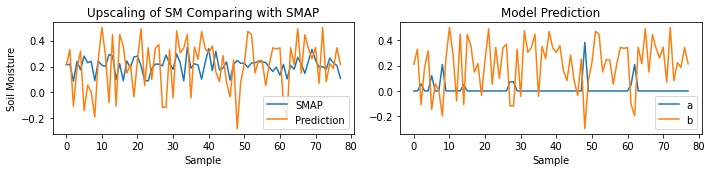

Epoch [26/5000] (LR: 0.0005):
Train loss: 0.5343 || Train physical loss: 0.0474 || Train similarity loss: 0.4868
Valid loss: 0.8518 || Valid physical loss: 0.0385 || Valid similarity loss: 0.8133


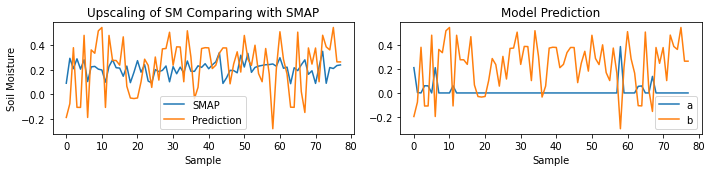

Epoch [27/5000] (LR: 0.0005):
Train loss: 0.6906 || Train physical loss: 0.0461 || Train similarity loss: 0.6445
Valid loss: 0.8487 || Valid physical loss: 0.0430 || Valid similarity loss: 0.8058


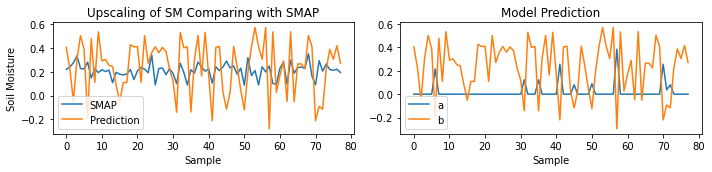

Epoch [28/5000] (LR: 0.0005):
Train loss: 0.3756 || Train physical loss: 0.0523 || Train similarity loss: 0.3233
Valid loss: 0.0503 || Valid physical loss: 0.0503 || Valid similarity loss: 0.0000


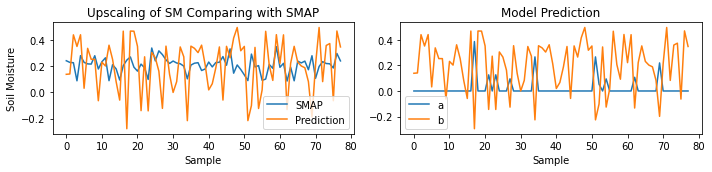

Epoch [29/5000] (LR: 0.0005):
Train loss: 0.0529 || Train physical loss: 0.0529 || Train similarity loss: 0.0000
Valid loss: 0.8470 || Valid physical loss: 0.0410 || Valid similarity loss: 0.8060


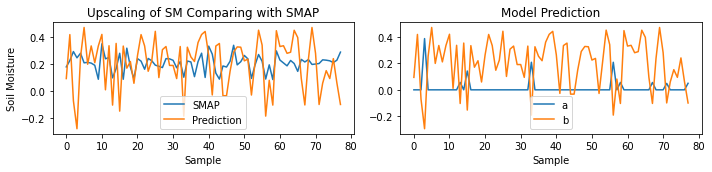

Epoch [30/5000] (LR: 0.0005):
Train loss: 0.5340 || Train physical loss: 0.0448 || Train similarity loss: 0.4892
Valid loss: 0.8571 || Valid physical loss: 0.0344 || Valid similarity loss: 0.8228


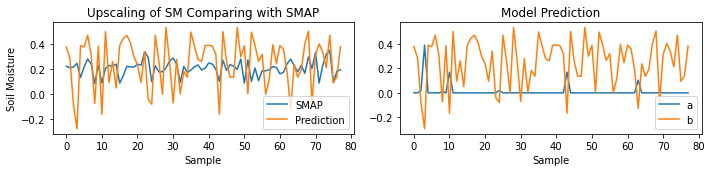

Epoch [31/5000] (LR: 0.0005):
Train loss: 0.6957 || Train physical loss: 0.0418 || Train similarity loss: 0.6538
Valid loss: 0.8563 || Valid physical loss: 0.0395 || Valid similarity loss: 0.8168


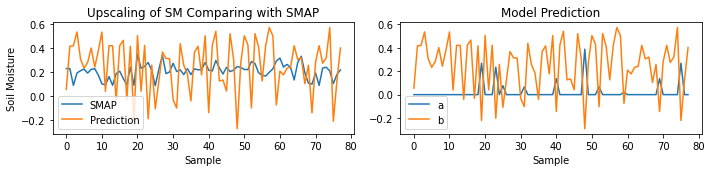

Epoch [32/5000] (LR: 0.0005):
Train loss: 0.6910 || Train physical loss: 0.0485 || Train similarity loss: 0.6425
Valid loss: 0.0503 || Valid physical loss: 0.0503 || Valid similarity loss: 0.0000


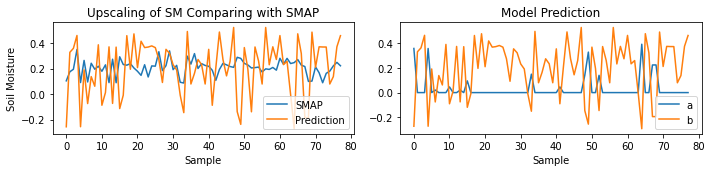

Epoch [33/5000] (LR: 0.0005):
Train loss: 0.0548 || Train physical loss: 0.0548 || Train similarity loss: 0.0000
Valid loss: 0.0471 || Valid physical loss: 0.0471 || Valid similarity loss: 0.0000
Saving model with loss 0.047...


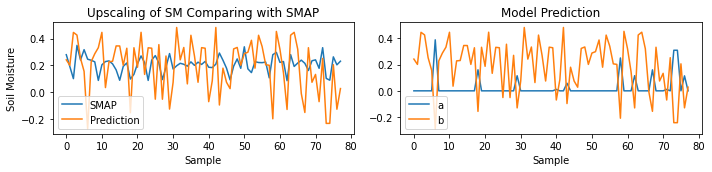

Epoch [34/5000] (LR: 0.0005):
Train loss: 0.2147 || Train physical loss: 0.0507 || Train similarity loss: 0.1639
Valid loss: 0.8477 || Valid physical loss: 0.0390 || Valid similarity loss: 0.8087


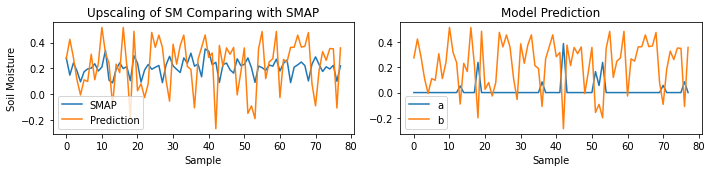

Epoch [35/5000] (LR: 0.0005):
Train loss: 0.6921 || Train physical loss: 0.0438 || Train similarity loss: 0.6483
Valid loss: 0.8524 || Valid physical loss: 0.0384 || Valid similarity loss: 0.8140


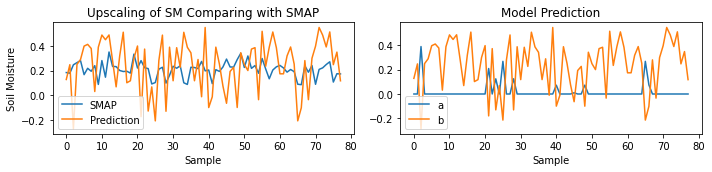

Epoch [36/5000] (LR: 0.0005):
Train loss: 0.5311 || Train physical loss: 0.0458 || Train similarity loss: 0.4853
Valid loss: 0.8470 || Valid physical loss: 0.0440 || Valid similarity loss: 0.8030


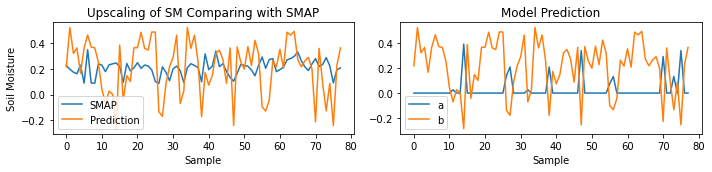

Epoch [37/5000] (LR: 0.0005):
Train loss: 0.2117 || Train physical loss: 0.0490 || Train similarity loss: 0.1628
Valid loss: 0.0443 || Valid physical loss: 0.0443 || Valid similarity loss: 0.0000
Saving model with loss 0.044...


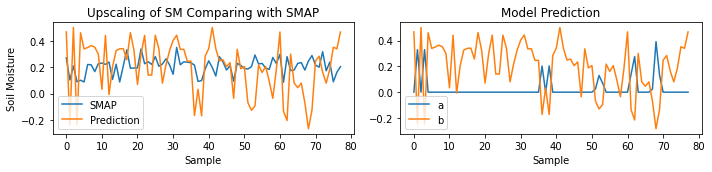

Epoch [38/5000] (LR: 0.0005):
Train loss: 0.2109 || Train physical loss: 0.0497 || Train similarity loss: 0.1612
Valid loss: 0.8444 || Valid physical loss: 0.0404 || Valid similarity loss: 0.8040


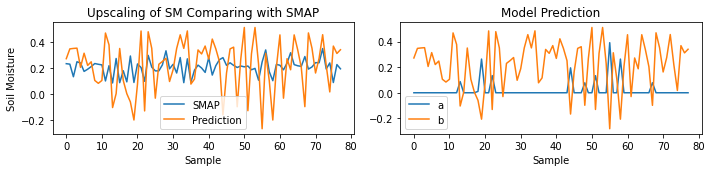

Epoch [39/5000] (LR: 0.0005):
Train loss: 0.5297 || Train physical loss: 0.0452 || Train similarity loss: 0.4845
Valid loss: 0.8513 || Valid physical loss: 0.0376 || Valid similarity loss: 0.8137


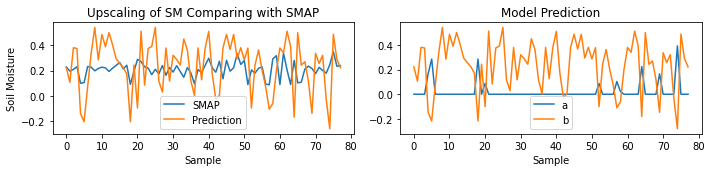

Epoch [40/5000] (LR: 0.0005):
Train loss: 0.6899 || Train physical loss: 0.0442 || Train similarity loss: 0.6457
Valid loss: 0.8464 || Valid physical loss: 0.0429 || Valid similarity loss: 0.8035


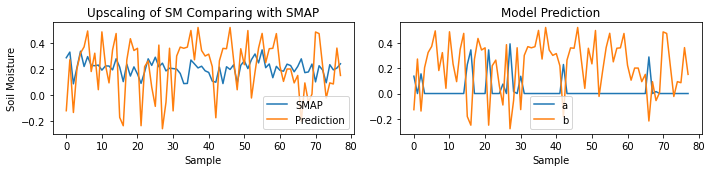

Epoch [41/5000] (LR: 0.0005):
Train loss: 0.2083 || Train physical loss: 0.0481 || Train similarity loss: 0.1603
Valid loss: 0.0436 || Valid physical loss: 0.0436 || Valid similarity loss: 0.0000
Saving model with loss 0.044...


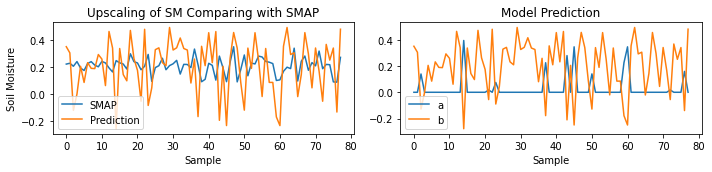

Epoch [42/5000] (LR: 0.0005):
Train loss: 0.3733 || Train physical loss: 0.0472 || Train similarity loss: 0.3262
Valid loss: 0.8437 || Valid physical loss: 0.0401 || Valid similarity loss: 0.8037


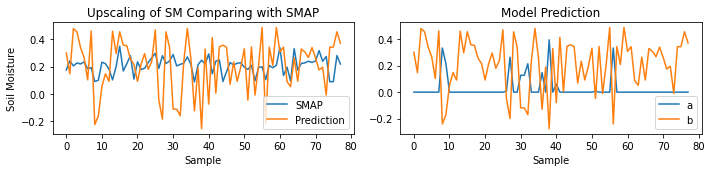

Epoch [43/5000] (LR: 0.0005):
Train loss: 0.3712 || Train physical loss: 0.0451 || Train similarity loss: 0.3261
Valid loss: 0.8455 || Valid physical loss: 0.0390 || Valid similarity loss: 0.8065


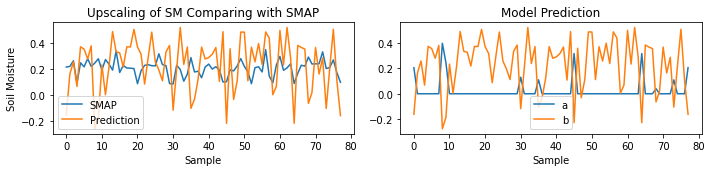

Epoch [44/5000] (LR: 0.0005):
Train loss: 0.3682 || Train physical loss: 0.0457 || Train similarity loss: 0.3225
Valid loss: 0.8453 || Valid physical loss: 0.0415 || Valid similarity loss: 0.8037


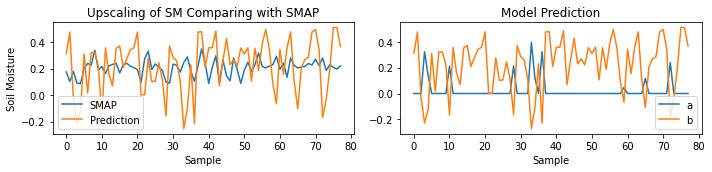

Epoch [45/5000] (LR: 0.0005):
Train loss: 0.3666 || Train physical loss: 0.0456 || Train similarity loss: 0.3210
Valid loss: 0.8456 || Valid physical loss: 0.0400 || Valid similarity loss: 0.8056


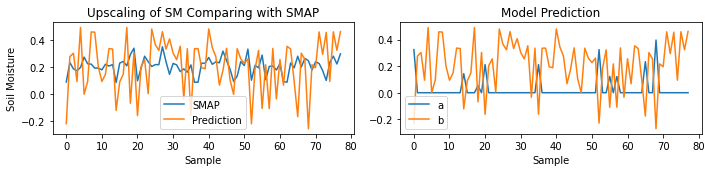

Epoch [46/5000] (LR: 0.0005):
Train loss: 0.3700 || Train physical loss: 0.0435 || Train similarity loss: 0.3266
Valid loss: 0.8476 || Valid physical loss: 0.0372 || Valid similarity loss: 0.8104


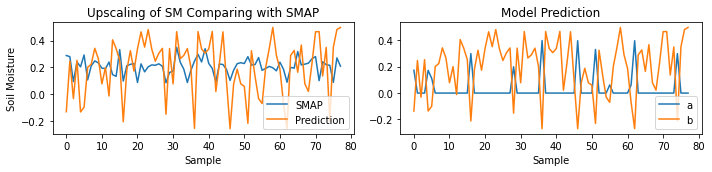

Epoch [47/5000] (LR: 0.0005):
Train loss: 0.6873 || Train physical loss: 0.0440 || Train similarity loss: 0.6433
Valid loss: 0.0421 || Valid physical loss: 0.0421 || Valid similarity loss: 0.0000
Saving model with loss 0.042...


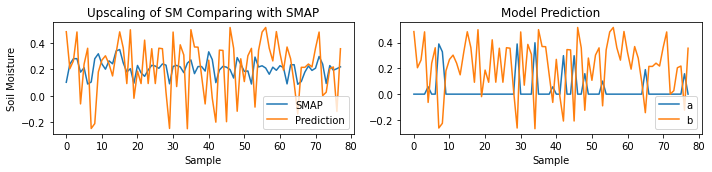

Epoch [48/5000] (LR: 0.0005):
Train loss: 0.3690 || Train physical loss: 0.0482 || Train similarity loss: 0.3208
Valid loss: 0.0438 || Valid physical loss: 0.0438 || Valid similarity loss: 0.0000


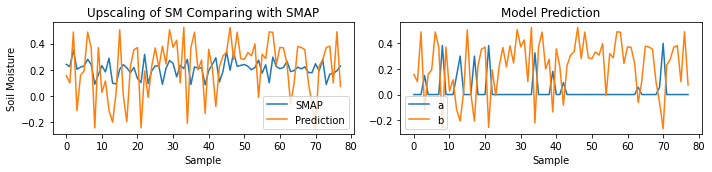

Epoch [49/5000] (LR: 0.0005):
Train loss: 0.2092 || Train physical loss: 0.0489 || Train similarity loss: 0.1603
Valid loss: 0.0443 || Valid physical loss: 0.0443 || Valid similarity loss: 0.0000


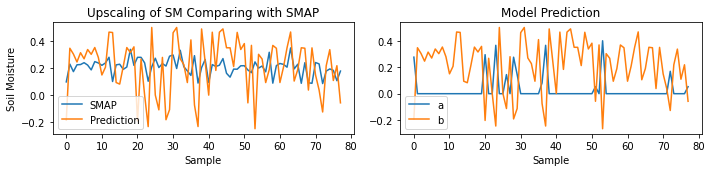

Epoch [50/5000] (LR: 0.0005):
Train loss: 0.3684 || Train physical loss: 0.0474 || Train similarity loss: 0.3210
Valid loss: 0.8421 || Valid physical loss: 0.0401 || Valid similarity loss: 0.8020


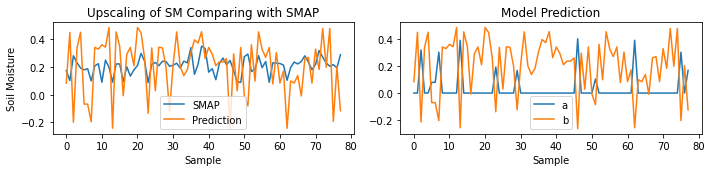

Epoch [51/5000] (LR: 0.0005):
Train loss: 0.5273 || Train physical loss: 0.0444 || Train similarity loss: 0.4830
Valid loss: 0.8408 || Valid physical loss: 0.0397 || Valid similarity loss: 0.8011


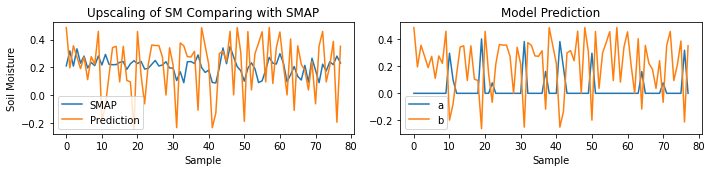

Epoch [52/5000] (LR: 0.0005):
Train loss: 0.3676 || Train physical loss: 0.0455 || Train similarity loss: 0.3222
Valid loss: 0.8409 || Valid physical loss: 0.0403 || Valid similarity loss: 0.8006


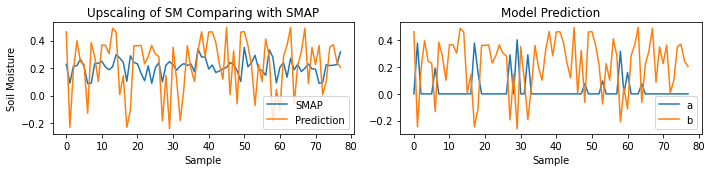

Epoch [53/5000] (LR: 0.0005):
Train loss: 0.3669 || Train physical loss: 0.0456 || Train similarity loss: 0.3213
Valid loss: 0.0411 || Valid physical loss: 0.0411 || Valid similarity loss: 0.0000
Saving model with loss 0.041...


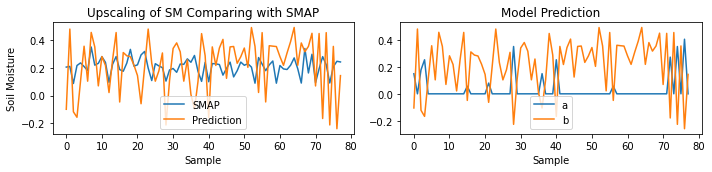

Epoch [54/5000] (LR: 0.0005):
Train loss: 0.3691 || Train physical loss: 0.0441 || Train similarity loss: 0.3250
Valid loss: 0.8459 || Valid physical loss: 0.0376 || Valid similarity loss: 0.8082


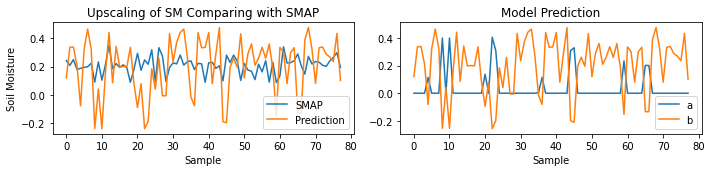

Epoch [55/5000] (LR: 0.0005):
Train loss: 0.3657 || Train physical loss: 0.0433 || Train similarity loss: 0.3224
Valid loss: 0.8404 || Valid physical loss: 0.0387 || Valid similarity loss: 0.8016


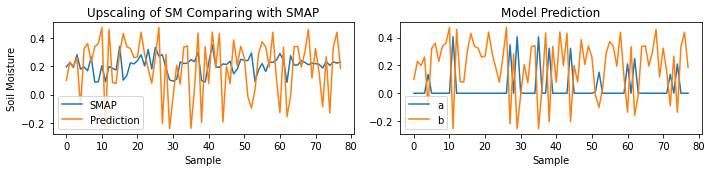

Epoch [56/5000] (LR: 0.0005):
Train loss: 0.5272 || Train physical loss: 0.0437 || Train similarity loss: 0.4835
Valid loss: 0.0393 || Valid physical loss: 0.0393 || Valid similarity loss: 0.0000
Saving model with loss 0.039...


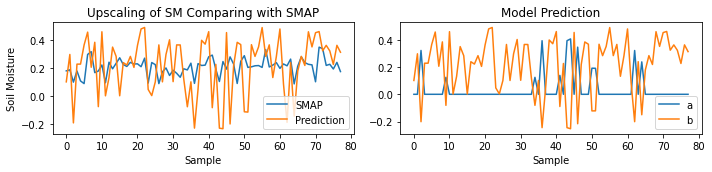

Epoch [57/5000] (LR: 0.0005):
Train loss: 0.2065 || Train physical loss: 0.0457 || Train similarity loss: 0.1608
Valid loss: 0.0413 || Valid physical loss: 0.0413 || Valid similarity loss: 0.0000


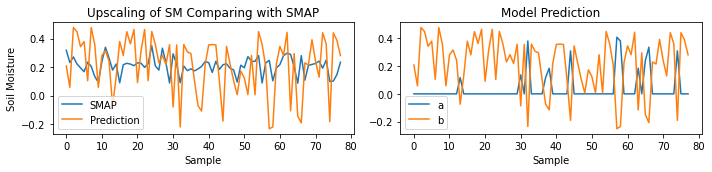

Epoch [58/5000] (LR: 0.0005):
Train loss: 0.3668 || Train physical loss: 0.0450 || Train similarity loss: 0.3217
Valid loss: 0.8414 || Valid physical loss: 0.0389 || Valid similarity loss: 0.8025


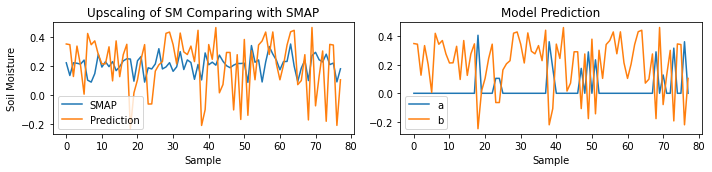

Epoch [59/5000] (LR: 0.0005):
Train loss: 0.3635 || Train physical loss: 0.0426 || Train similarity loss: 0.3209
Valid loss: 0.8456 || Valid physical loss: 0.0358 || Valid similarity loss: 0.8098


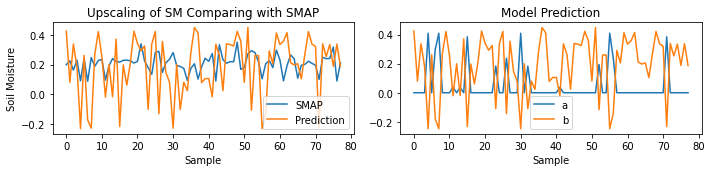

Epoch [60/5000] (LR: 0.0005):
Train loss: 0.6861 || Train physical loss: 0.0424 || Train similarity loss: 0.6437
Valid loss: 0.0392 || Valid physical loss: 0.0392 || Valid similarity loss: 0.0000
Saving model with loss 0.039...


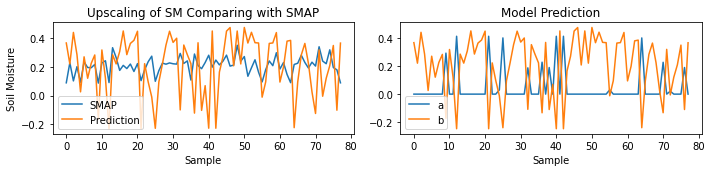

Epoch [61/5000] (LR: 0.0005):
Train loss: 0.2066 || Train physical loss: 0.0461 || Train similarity loss: 0.1606
Valid loss: 0.0420 || Valid physical loss: 0.0420 || Valid similarity loss: 0.0000


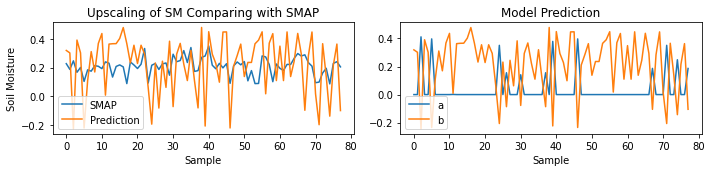

Epoch [62/5000] (LR: 0.0005):
Train loss: 0.2069 || Train physical loss: 0.0461 || Train similarity loss: 0.1607
Valid loss: 0.8402 || Valid physical loss: 0.0392 || Valid similarity loss: 0.8010


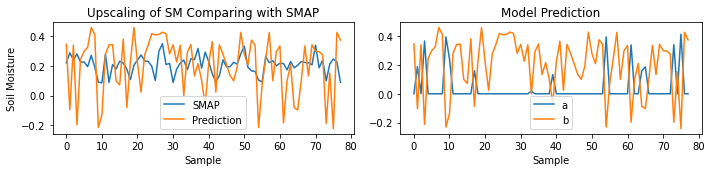

Epoch [63/5000] (LR: 0.0005):
Train loss: 0.2038 || Train physical loss: 0.0432 || Train similarity loss: 0.1606
Valid loss: 0.8439 || Valid physical loss: 0.0354 || Valid similarity loss: 0.8086


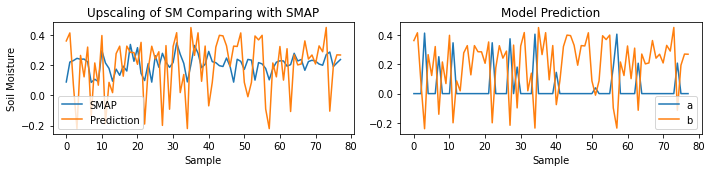

Epoch [64/5000] (LR: 0.0005):
Train loss: 0.6881 || Train physical loss: 0.0387 || Train similarity loss: 0.6495
Valid loss: 0.8435 || Valid physical loss: 0.0346 || Valid similarity loss: 0.8089


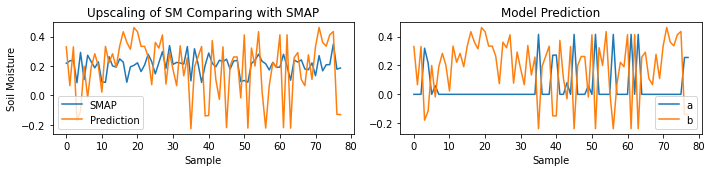

Epoch [65/5000] (LR: 0.0005):
Train loss: 0.3672 || Train physical loss: 0.0424 || Train similarity loss: 0.3248
Valid loss: 0.0396 || Valid physical loss: 0.0396 || Valid similarity loss: 0.0000


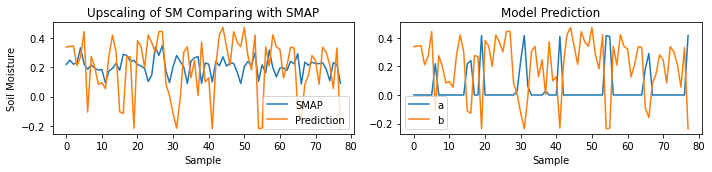

Epoch [66/5000] (LR: 0.0005):
Train loss: 0.0446 || Train physical loss: 0.0446 || Train similarity loss: 0.0000
Valid loss: 0.0384 || Valid physical loss: 0.0384 || Valid similarity loss: 0.0000
Saving model with loss 0.038...


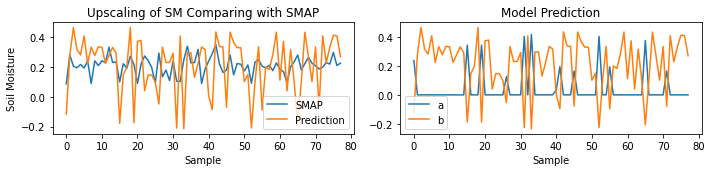

Epoch [67/5000] (LR: 0.0005):
Train loss: 0.3652 || Train physical loss: 0.0410 || Train similarity loss: 0.3243
Valid loss: 0.8452 || Valid physical loss: 0.0338 || Valid similarity loss: 0.8114


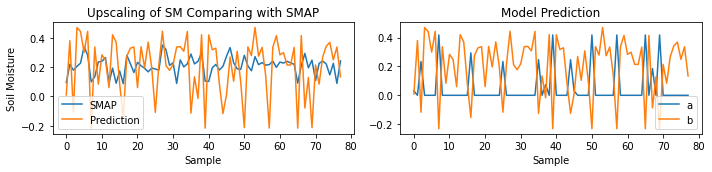

Epoch [68/5000] (LR: 0.0005):
Train loss: 0.6861 || Train physical loss: 0.0395 || Train similarity loss: 0.6466
Valid loss: 0.0377 || Valid physical loss: 0.0377 || Valid similarity loss: 0.0000
Saving model with loss 0.038...


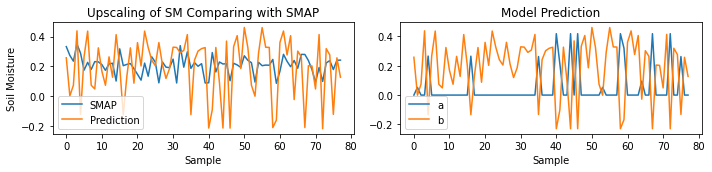

Epoch [69/5000] (LR: 0.0005):
Train loss: 0.2028 || Train physical loss: 0.0427 || Train similarity loss: 0.1601
Valid loss: 0.0375 || Valid physical loss: 0.0375 || Valid similarity loss: 0.0000
Saving model with loss 0.037...


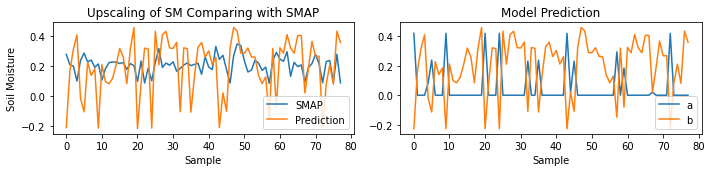

Epoch [70/5000] (LR: 0.0005):
Train loss: 0.0420 || Train physical loss: 0.0420 || Train similarity loss: 0.0000
Valid loss: 0.8386 || Valid physical loss: 0.0354 || Valid similarity loss: 0.8033


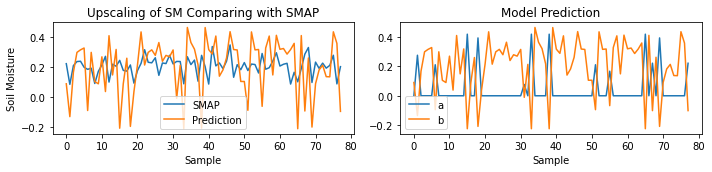

Epoch [71/5000] (LR: 0.0005):
Train loss: 0.5225 || Train physical loss: 0.0393 || Train similarity loss: 0.4832
Valid loss: 0.8409 || Valid physical loss: 0.0342 || Valid similarity loss: 0.8067


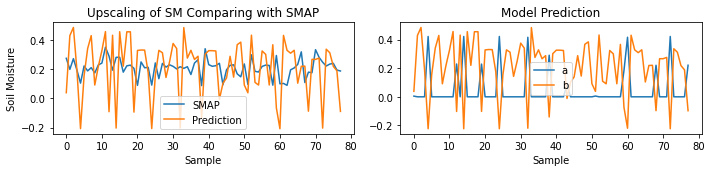

Epoch [72/5000] (LR: 0.0005):
Train loss: 0.3629 || Train physical loss: 0.0391 || Train similarity loss: 0.3237
Valid loss: 0.8377 || Valid physical loss: 0.0363 || Valid similarity loss: 0.8014


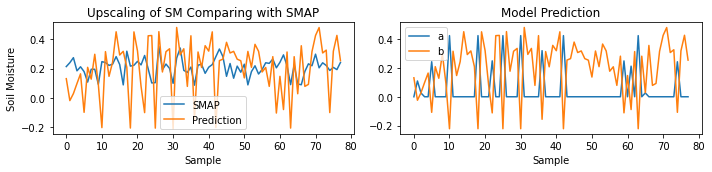

Epoch [73/5000] (LR: 0.0005):
Train loss: 0.3625 || Train physical loss: 0.0401 || Train similarity loss: 0.3224
Valid loss: 0.8360 || Valid physical loss: 0.0360 || Valid similarity loss: 0.8001


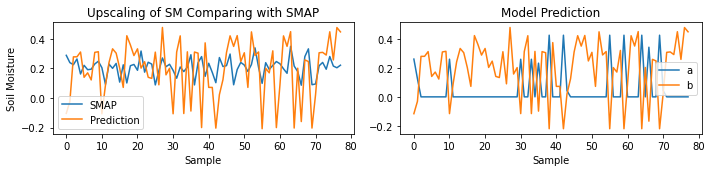

Epoch [74/5000] (LR: 0.0005):
Train loss: 0.5221 || Train physical loss: 0.0398 || Train similarity loss: 0.4823
Valid loss: 0.0359 || Valid physical loss: 0.0359 || Valid similarity loss: 0.0000
Saving model with loss 0.036...


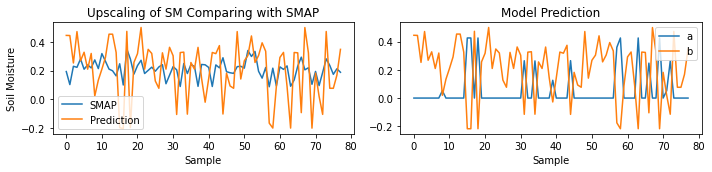

Epoch [75/5000] (LR: 0.0005):
Train loss: 0.2036 || Train physical loss: 0.0417 || Train similarity loss: 0.1619
Valid loss: 0.0384 || Valid physical loss: 0.0384 || Valid similarity loss: 0.0000


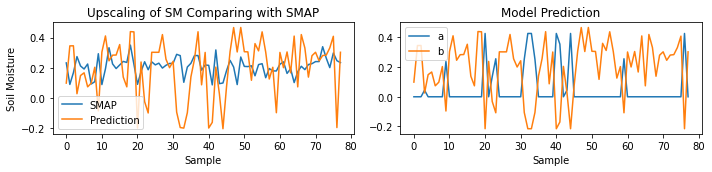

Epoch [76/5000] (LR: 0.0005):
Train loss: 0.2017 || Train physical loss: 0.0410 || Train similarity loss: 0.1607
Valid loss: 0.8363 || Valid physical loss: 0.0344 || Valid similarity loss: 0.8019


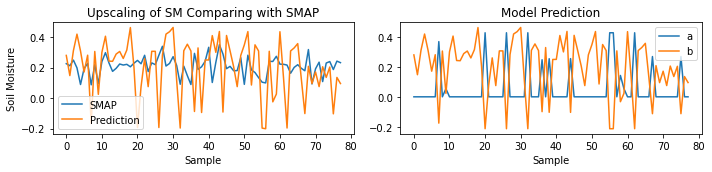

Epoch [77/5000] (LR: 0.0005):
Train loss: 0.5211 || Train physical loss: 0.0384 || Train similarity loss: 0.4827
Valid loss: 0.8357 || Valid physical loss: 0.0344 || Valid similarity loss: 0.8014


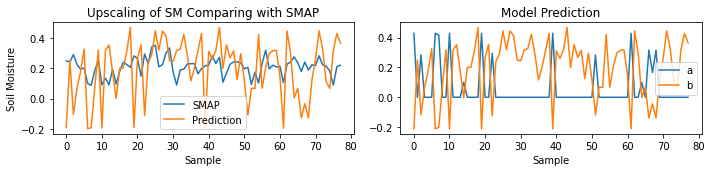

Epoch [78/5000] (LR: 0.0005):
Train loss: 0.5220 || Train physical loss: 0.0399 || Train similarity loss: 0.4821
Valid loss: 0.0368 || Valid physical loss: 0.0368 || Valid similarity loss: 0.0000


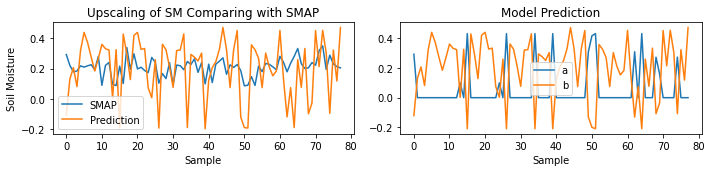

Epoch [79/5000] (LR: 0.0005):
Train loss: 0.0421 || Train physical loss: 0.0421 || Train similarity loss: 0.0000
Valid loss: 0.0369 || Valid physical loss: 0.0369 || Valid similarity loss: 0.0000


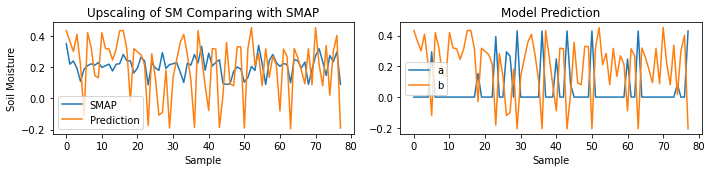

Epoch [80/5000] (LR: 0.0005):
Train loss: 0.2005 || Train physical loss: 0.0404 || Train similarity loss: 0.1601
Valid loss: 0.8348 || Valid physical loss: 0.0342 || Valid similarity loss: 0.8007


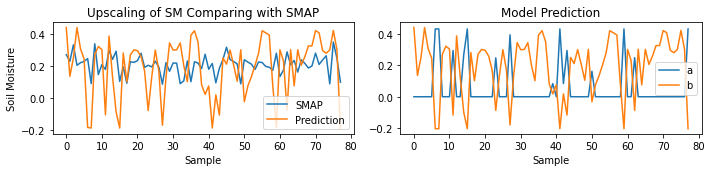

Epoch [81/5000] (LR: 0.0005):
Train loss: 0.3615 || Train physical loss: 0.0378 || Train similarity loss: 0.3237
Valid loss: 0.8365 || Valid physical loss: 0.0324 || Valid similarity loss: 0.8042


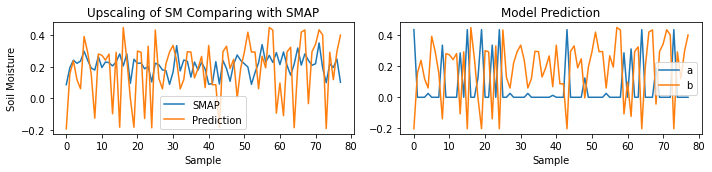

Epoch [82/5000] (LR: 0.0005):
Train loss: 0.5200 || Train physical loss: 0.0376 || Train similarity loss: 0.4825
Valid loss: 0.0339 || Valid physical loss: 0.0339 || Valid similarity loss: 0.0000
Saving model with loss 0.034...


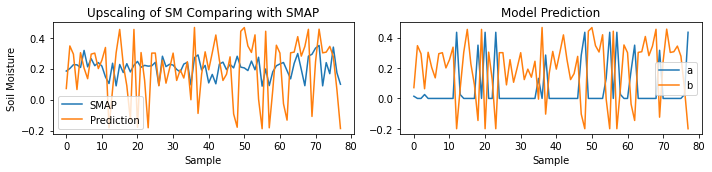

Epoch [83/5000] (LR: 0.0005):
Train loss: 0.2015 || Train physical loss: 0.0395 || Train similarity loss: 0.1619
Valid loss: 0.0354 || Valid physical loss: 0.0354 || Valid similarity loss: 0.0000


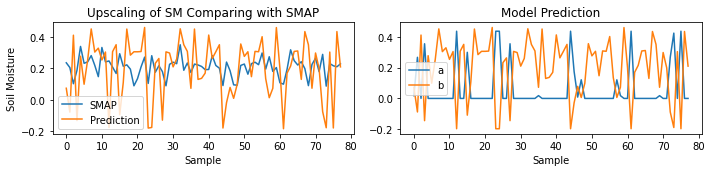

Epoch [84/5000] (LR: 0.0005):
Train loss: 0.1995 || Train physical loss: 0.0390 || Train similarity loss: 0.1605
Valid loss: 0.0343 || Valid physical loss: 0.0343 || Valid similarity loss: 0.0000


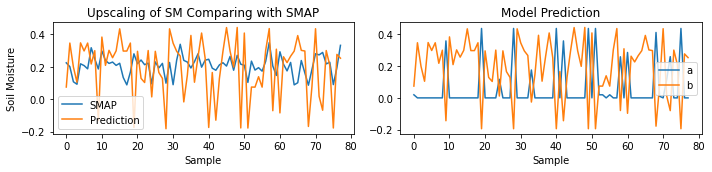

Epoch [85/5000] (LR: 0.0005):
Train loss: 0.3602 || Train physical loss: 0.0373 || Train similarity loss: 0.3229
Valid loss: 0.8337 || Valid physical loss: 0.0322 || Valid similarity loss: 0.8015


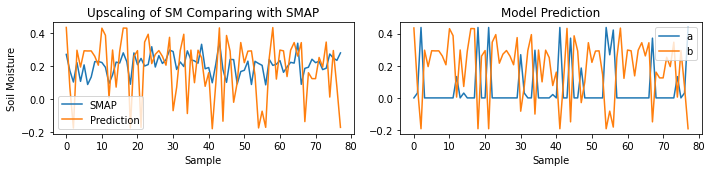

Epoch [86/5000] (LR: 0.0005):
Train loss: 0.3568 || Train physical loss: 0.0359 || Train similarity loss: 0.3209
Valid loss: 0.8334 || Valid physical loss: 0.0317 || Valid similarity loss: 0.8016


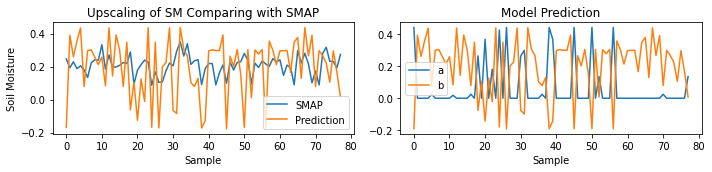

Epoch [87/5000] (LR: 0.0005):
Train loss: 0.3580 || Train physical loss: 0.0355 || Train similarity loss: 0.3224
Valid loss: 0.8335 || Valid physical loss: 0.0315 || Valid similarity loss: 0.8020


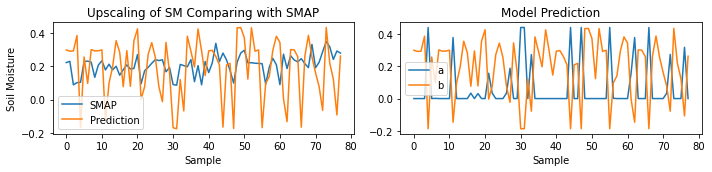

Epoch [88/5000] (LR: 0.0005):
Train loss: 0.1967 || Train physical loss: 0.0354 || Train similarity loss: 0.1614
Valid loss: 0.8325 || Valid physical loss: 0.0313 || Valid similarity loss: 0.8012


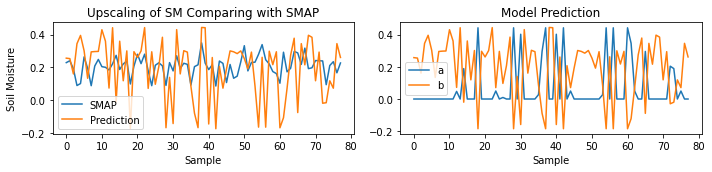

Epoch [89/5000] (LR: 0.0005):
Train loss: 0.3577 || Train physical loss: 0.0356 || Train similarity loss: 0.3221
Valid loss: 0.0325 || Valid physical loss: 0.0325 || Valid similarity loss: 0.0000
Saving model with loss 0.032...


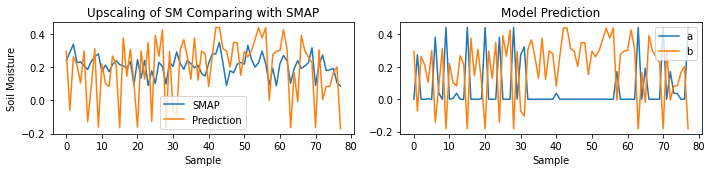

Epoch [90/5000] (LR: 0.0005):
Train loss: 0.1959 || Train physical loss: 0.0358 || Train similarity loss: 0.1601
Valid loss: 0.8318 || Valid physical loss: 0.0312 || Valid similarity loss: 0.8007


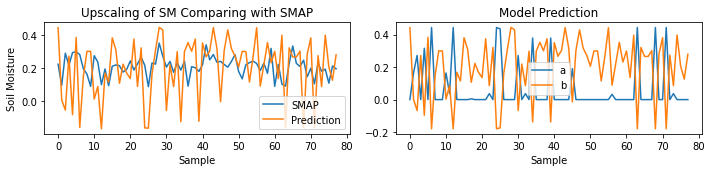

Epoch [91/5000] (LR: 0.0005):
Train loss: 0.3569 || Train physical loss: 0.0341 || Train similarity loss: 0.3227
Valid loss: 0.8320 || Valid physical loss: 0.0310 || Valid similarity loss: 0.8010


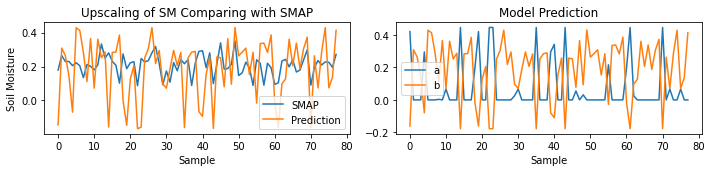

Epoch [92/5000] (LR: 0.0005):
Train loss: 0.3584 || Train physical loss: 0.0342 || Train similarity loss: 0.3241
Valid loss: 0.8305 || Valid physical loss: 0.0304 || Valid similarity loss: 0.8001


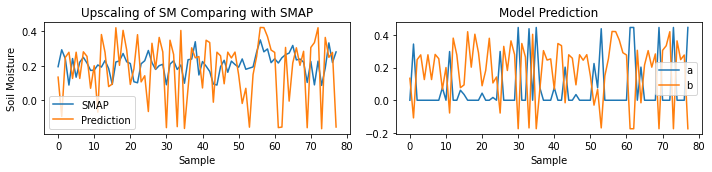

Epoch [93/5000] (LR: 0.0005):
Train loss: 0.1961 || Train physical loss: 0.0343 || Train similarity loss: 0.1618
Valid loss: 0.8304 || Valid physical loss: 0.0299 || Valid similarity loss: 0.8005


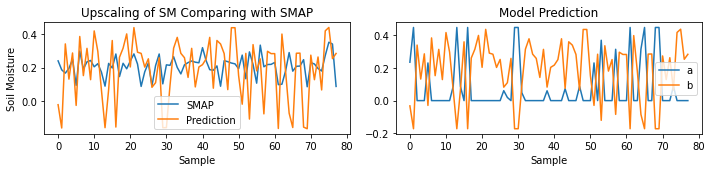

Epoch [94/5000] (LR: 0.0005):
Train loss: 0.3571 || Train physical loss: 0.0346 || Train similarity loss: 0.3225
Valid loss: 0.0313 || Valid physical loss: 0.0313 || Valid similarity loss: 0.0000
Saving model with loss 0.031...


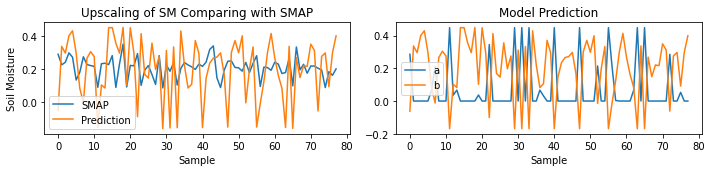

Epoch [95/5000] (LR: 0.0005):
Train loss: 0.1954 || Train physical loss: 0.0350 || Train similarity loss: 0.1604
Valid loss: 0.0315 || Valid physical loss: 0.0315 || Valid similarity loss: 0.0000


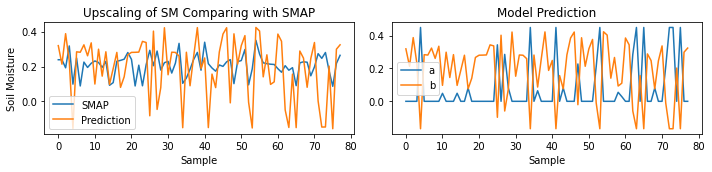

Epoch [96/5000] (LR: 0.0005):
Train loss: 0.1963 || Train physical loss: 0.0337 || Train similarity loss: 0.1626
Valid loss: 0.8298 || Valid physical loss: 0.0291 || Valid similarity loss: 0.8007


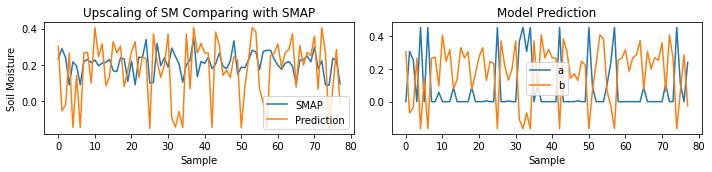

Epoch [97/5000] (LR: 0.0005):
Train loss: 0.3556 || Train physical loss: 0.0329 || Train similarity loss: 0.3226
Valid loss: 0.8295 || Valid physical loss: 0.0281 || Valid similarity loss: 0.8014


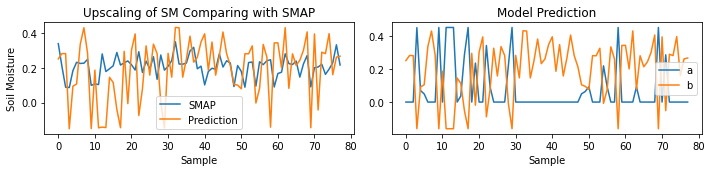

Epoch [98/5000] (LR: 0.0005):
Train loss: 0.1927 || Train physical loss: 0.0326 || Train similarity loss: 0.1601
Valid loss: 0.0290 || Valid physical loss: 0.0290 || Valid similarity loss: 0.0000
Saving model with loss 0.029...


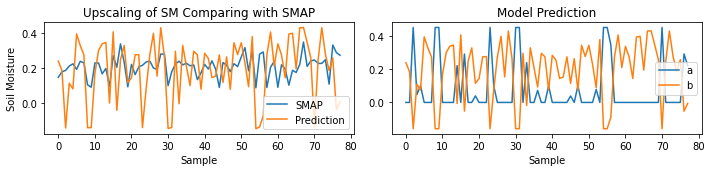

Epoch [99/5000] (LR: 0.0005):
Train loss: 0.3522 || Train physical loss: 0.0318 || Train similarity loss: 0.3204
Valid loss: 0.0287 || Valid physical loss: 0.0287 || Valid similarity loss: 0.0000
Saving model with loss 0.029...


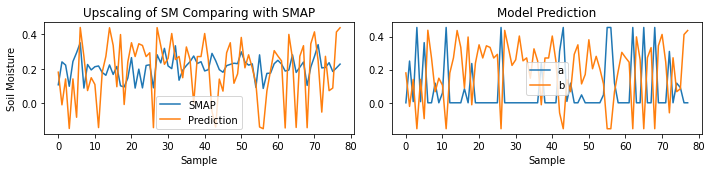

Epoch [100/5000] (LR: 0.0005):
Train loss: 0.1923 || Train physical loss: 0.0321 || Train similarity loss: 0.1602
Valid loss: 0.0289 || Valid physical loss: 0.0289 || Valid similarity loss: 0.0000


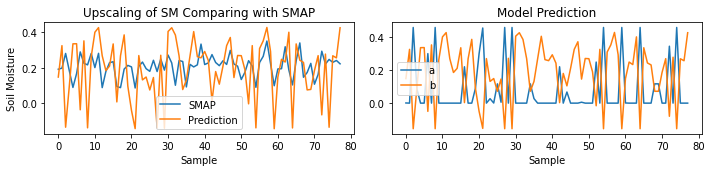

Epoch [101/5000] (LR: 0.0005):
Train loss: 0.1926 || Train physical loss: 0.0312 || Train similarity loss: 0.1614
Valid loss: 0.8285 || Valid physical loss: 0.0273 || Valid similarity loss: 0.8012


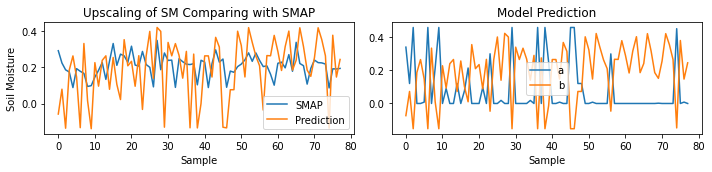

Epoch [102/5000] (LR: 0.0005):
Train loss: 0.1933 || Train physical loss: 0.0300 || Train similarity loss: 0.1633
Valid loss: 0.8290 || Valid physical loss: 0.0266 || Valid similarity loss: 0.8024


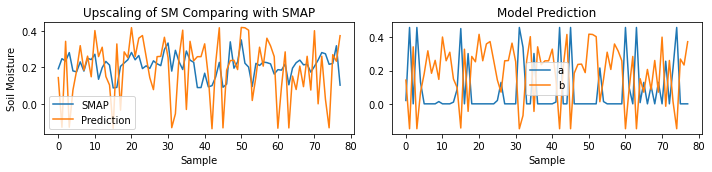

Epoch [103/5000] (LR: 0.0005):
Train loss: 0.5149 || Train physical loss: 0.0287 || Train similarity loss: 0.4862
Valid loss: 0.8289 || Valid physical loss: 0.0262 || Valid similarity loss: 0.8027


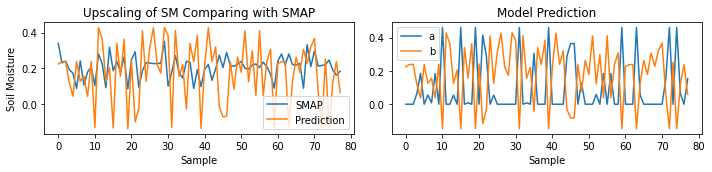

Epoch [104/5000] (LR: 0.0005):
Train loss: 0.3532 || Train physical loss: 0.0299 || Train similarity loss: 0.3233
Valid loss: 0.0284 || Valid physical loss: 0.0284 || Valid similarity loss: 0.0000
Saving model with loss 0.028...


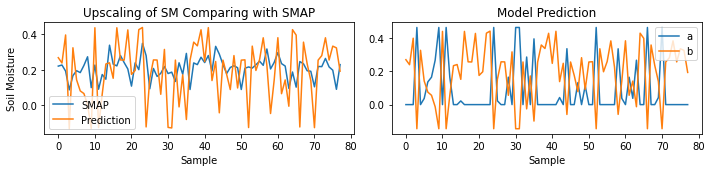

Epoch [105/5000] (LR: 0.0005):
Train loss: 0.0312 || Train physical loss: 0.0312 || Train similarity loss: 0.0000
Valid loss: 0.0283 || Valid physical loss: 0.0283 || Valid similarity loss: 0.0000
Saving model with loss 0.028...


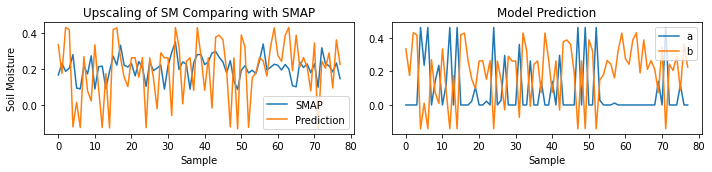

Epoch [106/5000] (LR: 0.0005):
Train loss: 0.1900 || Train physical loss: 0.0297 || Train similarity loss: 0.1602
Valid loss: 0.0268 || Valid physical loss: 0.0268 || Valid similarity loss: 0.0000
Saving model with loss 0.027...


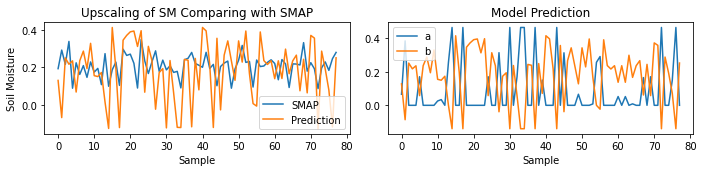

Epoch [107/5000] (LR: 0.0005):
Train loss: 0.1907 || Train physical loss: 0.0283 || Train similarity loss: 0.1624
Valid loss: 0.8261 || Valid physical loss: 0.0249 || Valid similarity loss: 0.8012


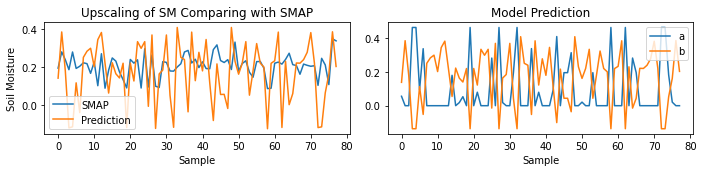

Epoch [108/5000] (LR: 0.0005):
Train loss: 0.5120 || Train physical loss: 0.0276 || Train similarity loss: 0.4845
Valid loss: 0.0251 || Valid physical loss: 0.0251 || Valid similarity loss: 0.0000
Saving model with loss 0.025...


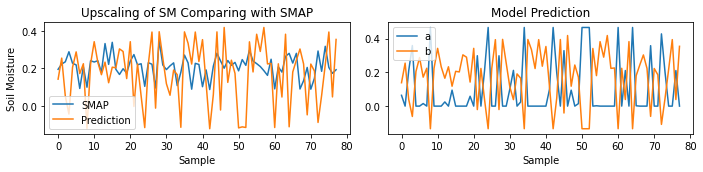

Epoch [109/5000] (LR: 0.0005):
Train loss: 0.1910 || Train physical loss: 0.0289 || Train similarity loss: 0.1621
Valid loss: 0.0259 || Valid physical loss: 0.0259 || Valid similarity loss: 0.0000


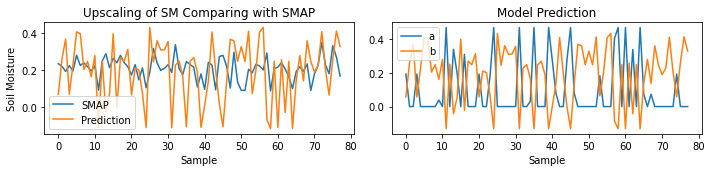

Epoch [110/5000] (LR: 0.0005):
Train loss: 0.3508 || Train physical loss: 0.0281 || Train similarity loss: 0.3227
Valid loss: 0.0260 || Valid physical loss: 0.0260 || Valid similarity loss: 0.0000


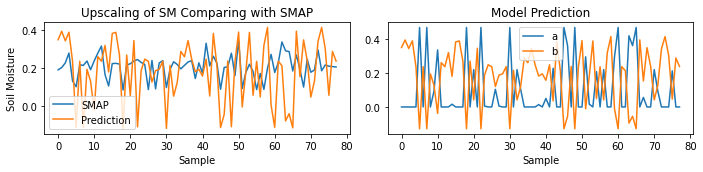

Epoch [111/5000] (LR: 0.0005):
Train loss: 0.1880 || Train physical loss: 0.0280 || Train similarity loss: 0.1601
Valid loss: 0.0253 || Valid physical loss: 0.0253 || Valid similarity loss: 0.0000


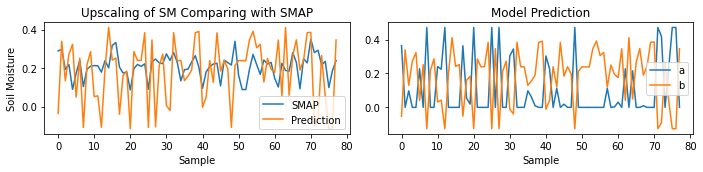

Epoch [112/5000] (LR: 0.0005):
Train loss: 0.1894 || Train physical loss: 0.0277 || Train similarity loss: 0.1617
Valid loss: 0.0249 || Valid physical loss: 0.0249 || Valid similarity loss: 0.0000
Saving model with loss 0.025...


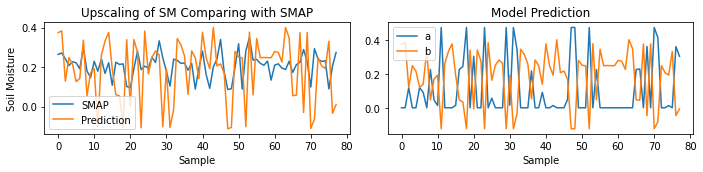

Epoch [113/5000] (LR: 0.0005):
Train loss: 0.3502 || Train physical loss: 0.0270 || Train similarity loss: 0.3232
Valid loss: 0.0242 || Valid physical loss: 0.0242 || Valid similarity loss: 0.0000
Saving model with loss 0.024...


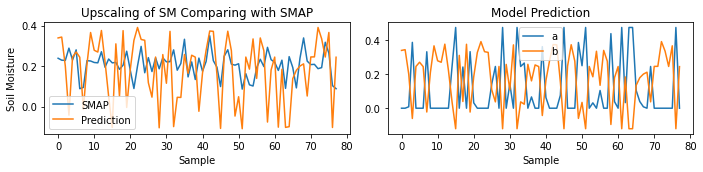

Epoch [114/5000] (LR: 0.0005):
Train loss: 0.1881 || Train physical loss: 0.0272 || Train similarity loss: 0.1609
Valid loss: 0.0244 || Valid physical loss: 0.0244 || Valid similarity loss: 0.0000


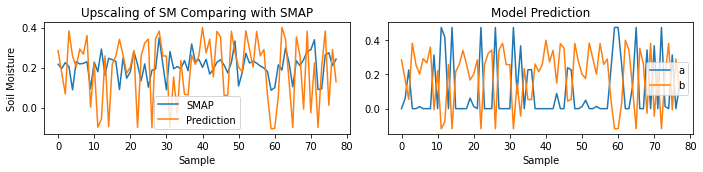

Epoch [115/5000] (LR: 0.0005):
Train loss: 0.1873 || Train physical loss: 0.0270 || Train similarity loss: 0.1604
Valid loss: 0.0242 || Valid physical loss: 0.0242 || Valid similarity loss: 0.0000


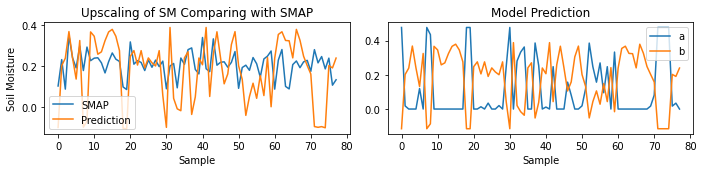

Epoch [116/5000] (LR: 0.0005):
Train loss: 0.3503 || Train physical loss: 0.0261 || Train similarity loss: 0.3242
Valid loss: 0.0235 || Valid physical loss: 0.0235 || Valid similarity loss: 0.0000
Saving model with loss 0.023...


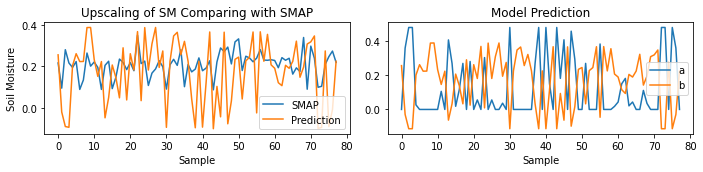

Epoch [117/5000] (LR: 0.0005):
Train loss: 0.1869 || Train physical loss: 0.0267 || Train similarity loss: 0.1602
Valid loss: 0.0238 || Valid physical loss: 0.0238 || Valid similarity loss: 0.0000


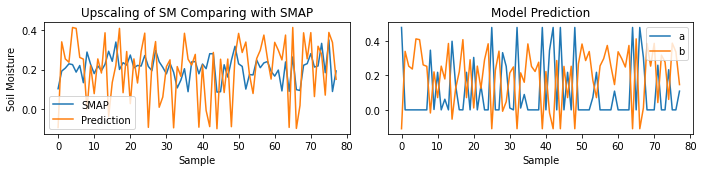

Epoch [118/5000] (LR: 0.0005):
Train loss: 0.0260 || Train physical loss: 0.0260 || Train similarity loss: 0.0000
Valid loss: 0.0232 || Valid physical loss: 0.0232 || Valid similarity loss: 0.0000
Saving model with loss 0.023...


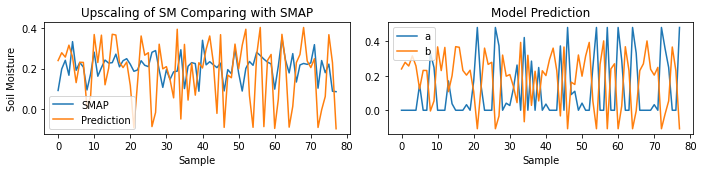

Epoch [119/5000] (LR: 0.0005):
Train loss: 0.3457 || Train physical loss: 0.0247 || Train similarity loss: 0.3210
Valid loss: 0.0223 || Valid physical loss: 0.0223 || Valid similarity loss: 0.0000
Saving model with loss 0.022...


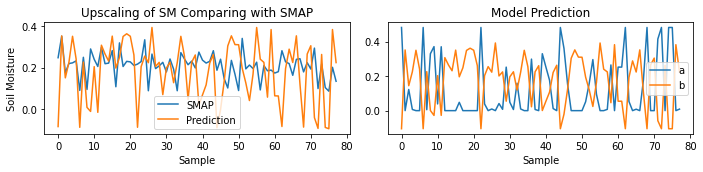

Epoch [120/5000] (LR: 0.0005):
Train loss: 0.0243 || Train physical loss: 0.0243 || Train similarity loss: 0.0000
Valid loss: 0.0212 || Valid physical loss: 0.0212 || Valid similarity loss: 0.0000
Saving model with loss 0.021...


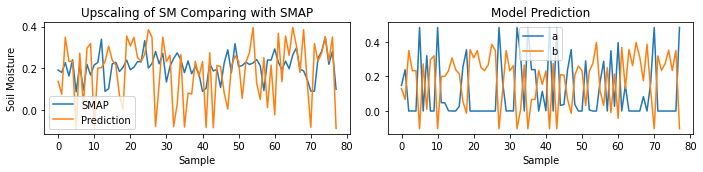

Epoch [121/5000] (LR: 0.0005):
Train loss: 0.3440 || Train physical loss: 0.0230 || Train similarity loss: 0.3210
Valid loss: 0.8212 || Valid physical loss: 0.0206 || Valid similarity loss: 0.8006


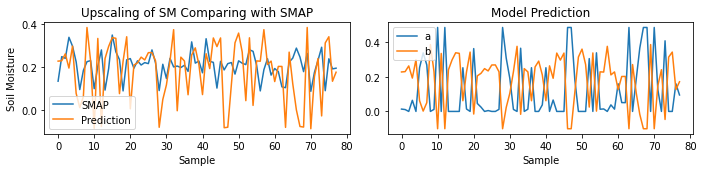

Epoch [122/5000] (LR: 0.0005):
Train loss: 0.3439 || Train physical loss: 0.0223 || Train similarity loss: 0.3216
Valid loss: 0.8212 || Valid physical loss: 0.0201 || Valid similarity loss: 0.8011


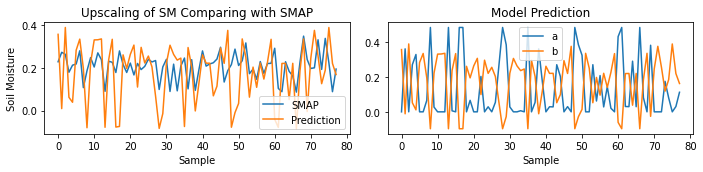

Epoch [123/5000] (LR: 0.0005):
Train loss: 0.1831 || Train physical loss: 0.0228 || Train similarity loss: 0.1603
Valid loss: 0.0205 || Valid physical loss: 0.0205 || Valid similarity loss: 0.0000
Saving model with loss 0.021...


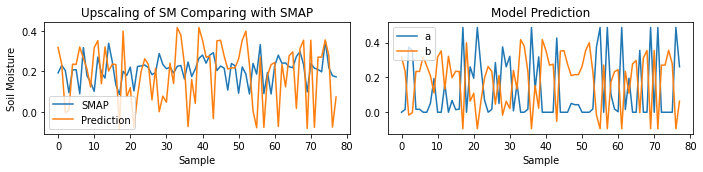

Epoch [124/5000] (LR: 0.0005):
Train loss: 0.3443 || Train physical loss: 0.0231 || Train similarity loss: 0.3212
Valid loss: 0.0212 || Valid physical loss: 0.0212 || Valid similarity loss: 0.0000


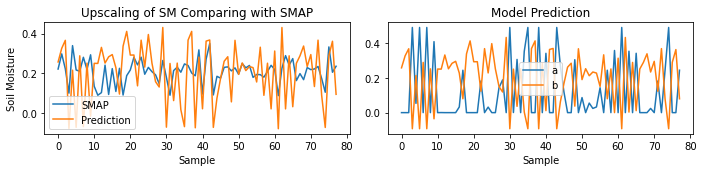

Epoch [125/5000] (LR: 0.0005):
Train loss: 0.0232 || Train physical loss: 0.0232 || Train similarity loss: 0.0000
Valid loss: 0.0215 || Valid physical loss: 0.0215 || Valid similarity loss: 0.0000


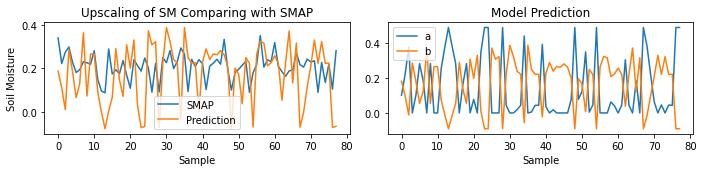

Epoch [126/5000] (LR: 0.0005):
Train loss: 0.1831 || Train physical loss: 0.0225 || Train similarity loss: 0.1606
Valid loss: 0.0197 || Valid physical loss: 0.0197 || Valid similarity loss: 0.0000
Saving model with loss 0.020...


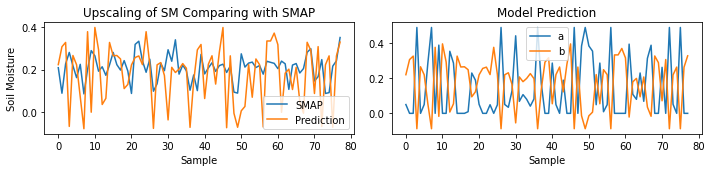

Epoch [127/5000] (LR: 0.0005):
Train loss: 0.3436 || Train physical loss: 0.0226 || Train similarity loss: 0.3210
Valid loss: 0.0199 || Valid physical loss: 0.0199 || Valid similarity loss: 0.0000


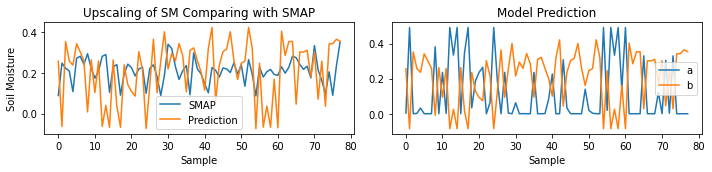

Epoch [128/5000] (LR: 0.0005):
Train loss: 0.0217 || Train physical loss: 0.0217 || Train similarity loss: 0.0000
Valid loss: 0.8205 || Valid physical loss: 0.0201 || Valid similarity loss: 0.8004


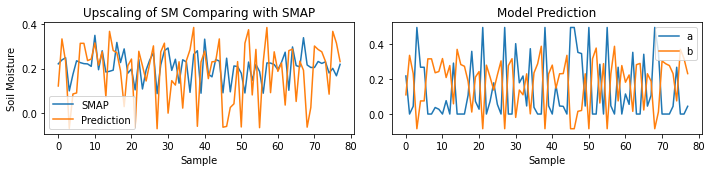

Epoch [129/5000] (LR: 0.0005):
Train loss: 0.1835 || Train physical loss: 0.0209 || Train similarity loss: 0.1626
Valid loss: 0.8216 || Valid physical loss: 0.0181 || Valid similarity loss: 0.8036


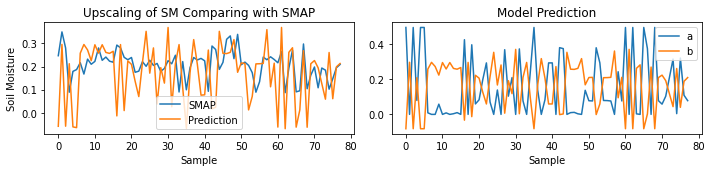

Epoch [130/5000] (LR: 0.0005):
Train loss: 0.3429 || Train physical loss: 0.0204 || Train similarity loss: 0.3225
Valid loss: 0.8209 || Valid physical loss: 0.0178 || Valid similarity loss: 0.8031


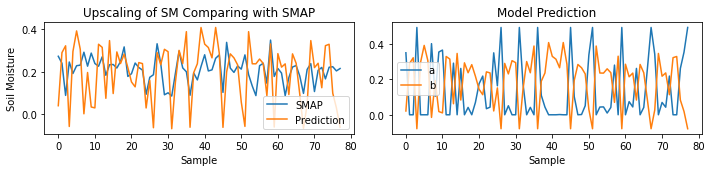

Epoch [131/5000] (LR: 0.0005):
Train loss: 0.3416 || Train physical loss: 0.0203 || Train similarity loss: 0.3213
Valid loss: 0.8192 || Valid physical loss: 0.0186 || Valid similarity loss: 0.8006


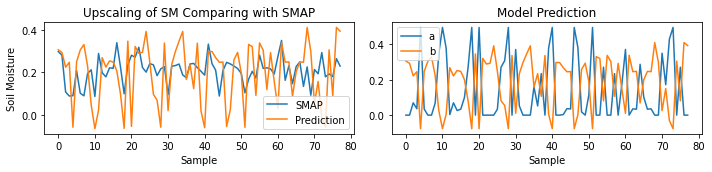

Epoch [132/5000] (LR: 0.0005):
Train loss: 0.1809 || Train physical loss: 0.0207 || Train similarity loss: 0.1602
Valid loss: 0.0194 || Valid physical loss: 0.0194 || Valid similarity loss: 0.0000
Saving model with loss 0.019...


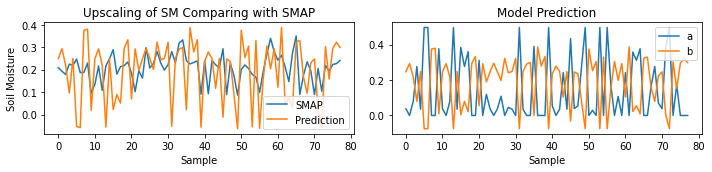

Epoch [133/5000] (LR: 0.0005):
Train loss: 0.0210 || Train physical loss: 0.0210 || Train similarity loss: 0.0000
Valid loss: 0.0185 || Valid physical loss: 0.0185 || Valid similarity loss: 0.0000
Saving model with loss 0.018...


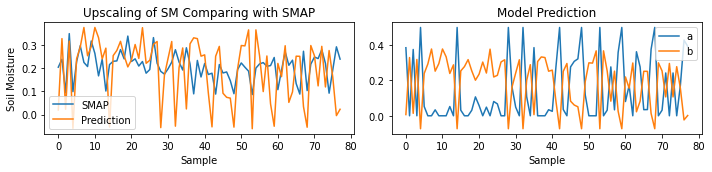

Epoch [134/5000] (LR: 0.0005):
Train loss: 0.1810 || Train physical loss: 0.0204 || Train similarity loss: 0.1606
Valid loss: 0.8189 || Valid physical loss: 0.0180 || Valid similarity loss: 0.8010


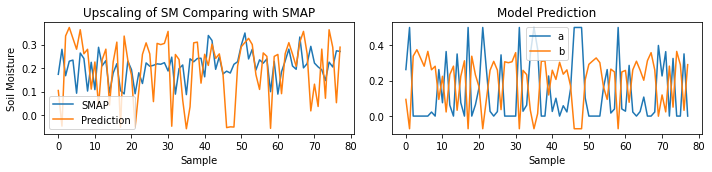

Epoch [135/5000] (LR: 0.0005):
Train loss: 0.0196 || Train physical loss: 0.0196 || Train similarity loss: 0.0000
Valid loss: 0.8220 || Valid physical loss: 0.0170 || Valid similarity loss: 0.8050


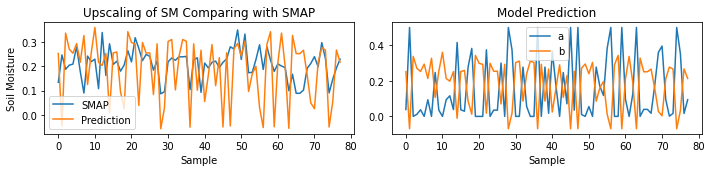

Epoch [136/5000] (LR: 0.0005):
Train loss: 0.5020 || Train physical loss: 0.0187 || Train similarity loss: 0.4832
Valid loss: 0.8216 || Valid physical loss: 0.0165 || Valid similarity loss: 0.8051


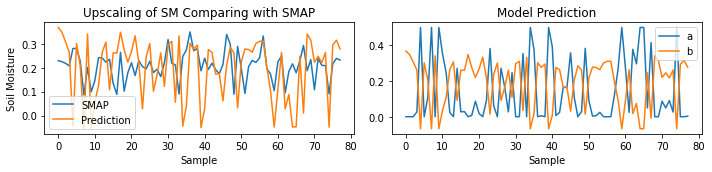

Epoch [137/5000] (LR: 0.0005):
Train loss: 0.1800 || Train physical loss: 0.0188 || Train similarity loss: 0.1611
Valid loss: 0.8206 || Valid physical loss: 0.0168 || Valid similarity loss: 0.8038


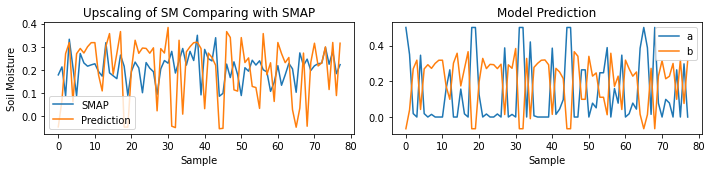

Epoch [138/5000] (LR: 0.0005):
Train loss: 0.1804 || Train physical loss: 0.0192 || Train similarity loss: 0.1612
Valid loss: 0.8190 || Valid physical loss: 0.0176 || Valid similarity loss: 0.8014


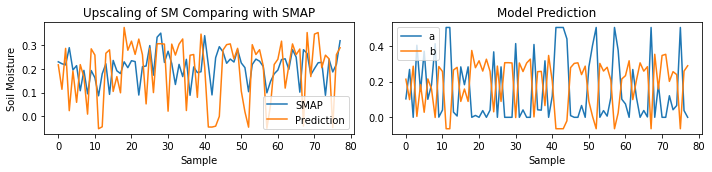

Epoch [139/5000] (LR: 0.0005):
Train loss: 0.1805 || Train physical loss: 0.0192 || Train similarity loss: 0.1613
Valid loss: 0.8177 || Valid physical loss: 0.0170 || Valid similarity loss: 0.8007


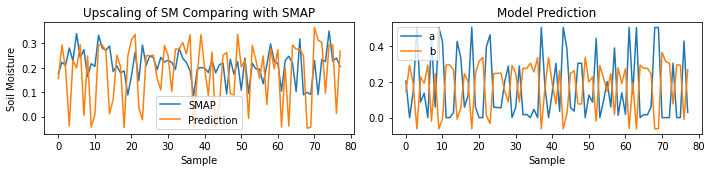

Epoch [140/5000] (LR: 0.0005):
Train loss: 0.1801 || Train physical loss: 0.0193 || Train similarity loss: 0.1608
Valid loss: 0.0169 || Valid physical loss: 0.0169 || Valid similarity loss: 0.0000
Saving model with loss 0.017...


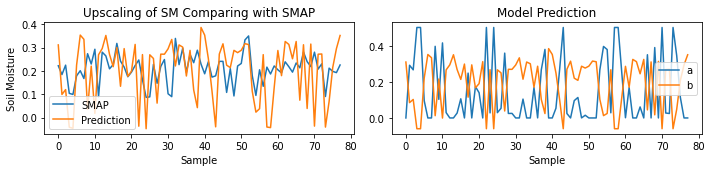

Epoch [141/5000] (LR: 0.0005):
Train loss: 0.0190 || Train physical loss: 0.0190 || Train similarity loss: 0.0000
Valid loss: 0.8191 || Valid physical loss: 0.0167 || Valid similarity loss: 0.8024


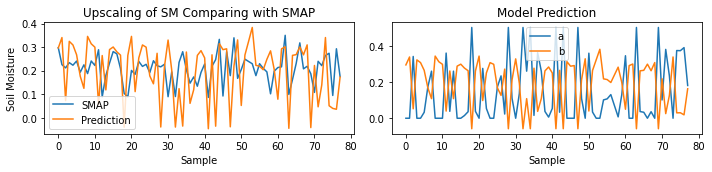

Epoch [142/5000] (LR: 0.0005):
Train loss: 0.0180 || Train physical loss: 0.0180 || Train similarity loss: 0.0000
Valid loss: 0.8221 || Valid physical loss: 0.0155 || Valid similarity loss: 0.8066


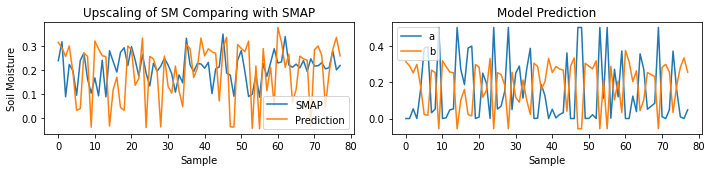

Epoch [143/5000] (LR: 0.0005):
Train loss: 0.4987 || Train physical loss: 0.0173 || Train similarity loss: 0.4814
Valid loss: 0.8214 || Valid physical loss: 0.0152 || Valid similarity loss: 0.8063


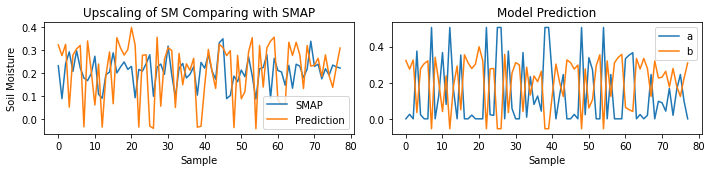

Epoch [144/5000] (LR: 0.0005):
Train loss: 0.1784 || Train physical loss: 0.0174 || Train similarity loss: 0.1610
Valid loss: 0.8221 || Valid physical loss: 0.0162 || Valid similarity loss: 0.8060


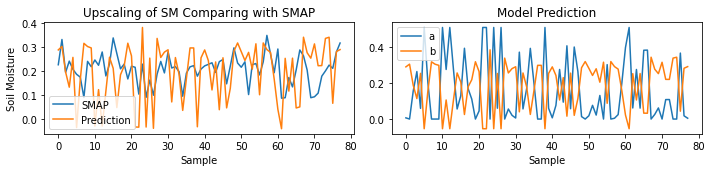

Epoch [145/5000] (LR: 0.0005):
Train loss: 0.0172 || Train physical loss: 0.0172 || Train similarity loss: 0.0000
Valid loss: 0.8207 || Valid physical loss: 0.0152 || Valid similarity loss: 0.8055


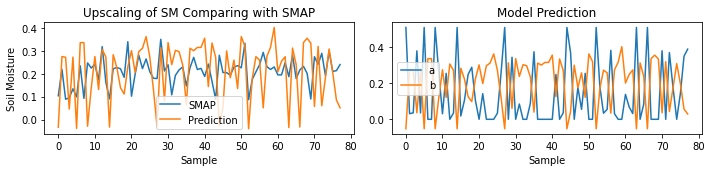

Epoch [146/5000] (LR: 0.0005):
Train loss: 0.3382 || Train physical loss: 0.0170 || Train similarity loss: 0.3212
Valid loss: 0.8204 || Valid physical loss: 0.0161 || Valid similarity loss: 0.8043


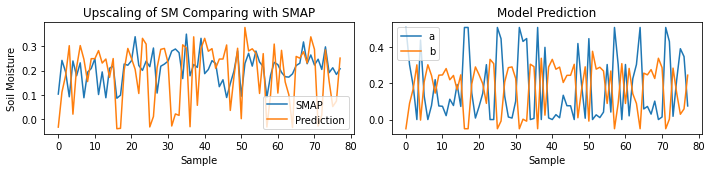

Epoch [147/5000] (LR: 0.0005):
Train loss: 0.4978 || Train physical loss: 0.0175 || Train similarity loss: 0.4804
Valid loss: 0.8162 || Valid physical loss: 0.0159 || Valid similarity loss: 0.8002


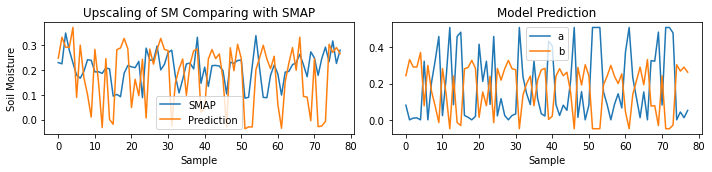

Epoch [148/5000] (LR: 0.0005):
Train loss: 0.0184 || Train physical loss: 0.0184 || Train similarity loss: 0.0000
Valid loss: 0.0165 || Valid physical loss: 0.0165 || Valid similarity loss: 0.0000
Saving model with loss 0.017...


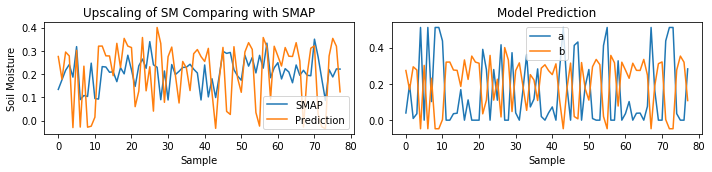

Epoch [149/5000] (LR: 0.0005):
Train loss: 0.0184 || Train physical loss: 0.0184 || Train similarity loss: 0.0000
Valid loss: 0.0168 || Valid physical loss: 0.0168 || Valid similarity loss: 0.0000


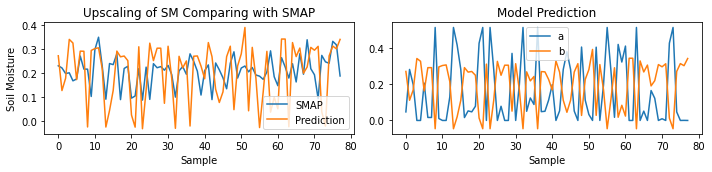

Epoch [150/5000] (LR: 0.0005):
Train loss: 0.1787 || Train physical loss: 0.0176 || Train similarity loss: 0.1611
Valid loss: 0.8167 || Valid physical loss: 0.0156 || Valid similarity loss: 0.8011


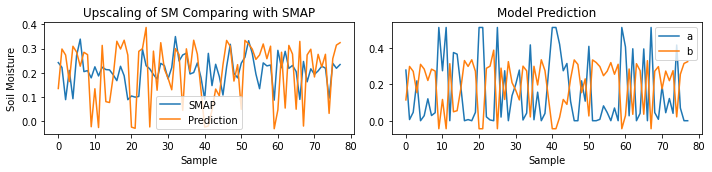

Epoch [151/5000] (LR: 0.0005):
Train loss: 0.3385 || Train physical loss: 0.0169 || Train similarity loss: 0.3217
Valid loss: 0.8179 || Valid physical loss: 0.0153 || Valid similarity loss: 0.8026


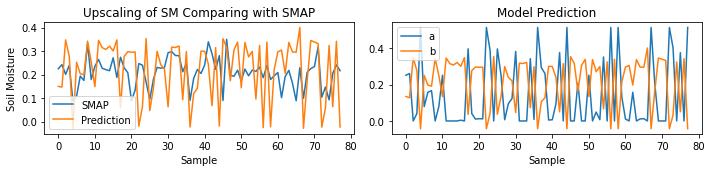

Epoch [152/5000] (LR: 0.0005):
Train loss: 0.1778 || Train physical loss: 0.0172 || Train similarity loss: 0.1606
Valid loss: 0.8186 || Valid physical loss: 0.0164 || Valid similarity loss: 0.8022


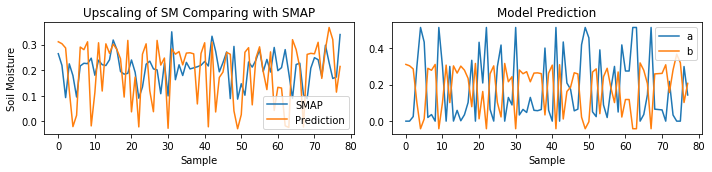

Epoch [153/5000] (LR: 0.0005):
Train loss: 0.0170 || Train physical loss: 0.0170 || Train similarity loss: 0.0000
Valid loss: 0.8177 || Valid physical loss: 0.0147 || Valid similarity loss: 0.8030


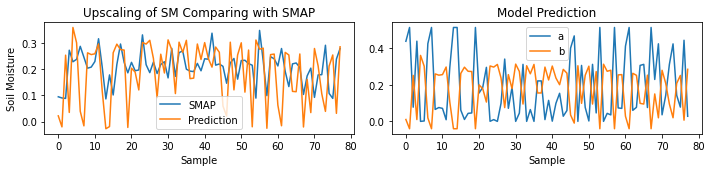

Epoch [154/5000] (LR: 0.0005):
Train loss: 0.1779 || Train physical loss: 0.0165 || Train similarity loss: 0.1613
Valid loss: 0.8179 || Valid physical loss: 0.0145 || Valid similarity loss: 0.8034


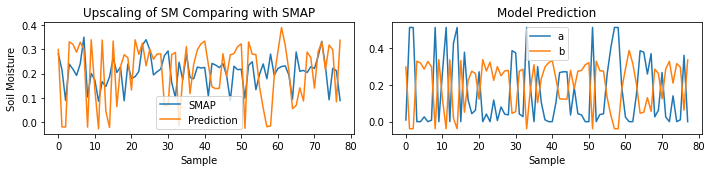

Epoch [155/5000] (LR: 0.0005):
Train loss: 0.1768 || Train physical loss: 0.0162 || Train similarity loss: 0.1607
Valid loss: 0.8186 || Valid physical loss: 0.0149 || Valid similarity loss: 0.8037


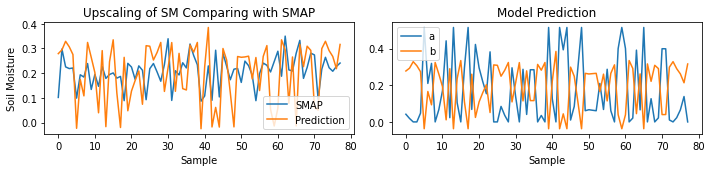

Epoch [156/5000] (LR: 0.0005):
Train loss: 0.3383 || Train physical loss: 0.0160 || Train similarity loss: 0.3223
Valid loss: 0.8171 || Valid physical loss: 0.0145 || Valid similarity loss: 0.8026


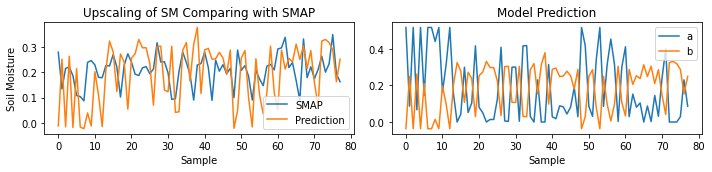

Epoch [157/5000] (LR: 0.00025):
Train loss: 0.1771 || Train physical loss: 0.0159 || Train similarity loss: 0.1612
Valid loss: 0.8166 || Valid physical loss: 0.0143 || Valid similarity loss: 0.8023


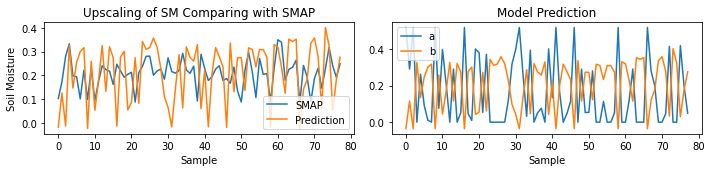

Epoch [158/5000] (LR: 0.00025):
Train loss: 0.3372 || Train physical loss: 0.0160 || Train similarity loss: 0.3212
Valid loss: 0.0155 || Valid physical loss: 0.0155 || Valid similarity loss: 0.0000
Saving model with loss 0.015...


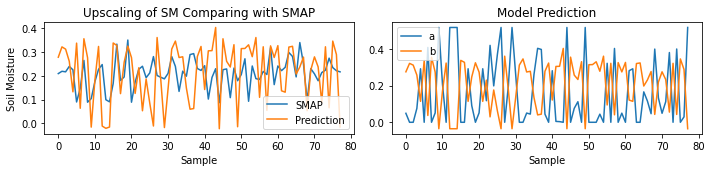

Epoch [159/5000] (LR: 0.00025):
Train loss: 0.1766 || Train physical loss: 0.0165 || Train similarity loss: 0.1601
Valid loss: 0.0157 || Valid physical loss: 0.0157 || Valid similarity loss: 0.0000


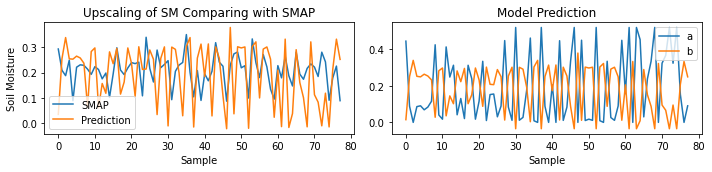

Epoch [160/5000] (LR: 0.00025):
Train loss: 0.1780 || Train physical loss: 0.0165 || Train similarity loss: 0.1615
Valid loss: 0.0151 || Valid physical loss: 0.0151 || Valid similarity loss: 0.0000
Saving model with loss 0.015...


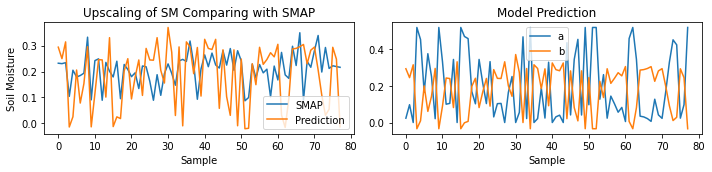

Epoch [161/5000] (LR: 0.00025):
Train loss: 0.0168 || Train physical loss: 0.0168 || Train similarity loss: 0.0000
Valid loss: 0.0148 || Valid physical loss: 0.0148 || Valid similarity loss: 0.0000
Saving model with loss 0.015...


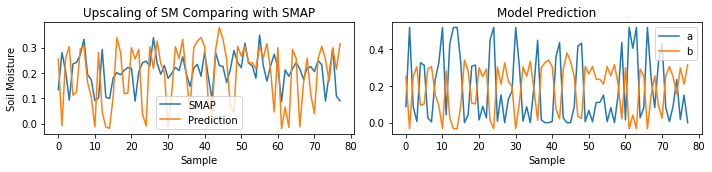

Epoch [162/5000] (LR: 0.00025):
Train loss: 0.1767 || Train physical loss: 0.0167 || Train similarity loss: 0.1601
Valid loss: 0.0147 || Valid physical loss: 0.0147 || Valid similarity loss: 0.0000
Saving model with loss 0.015...


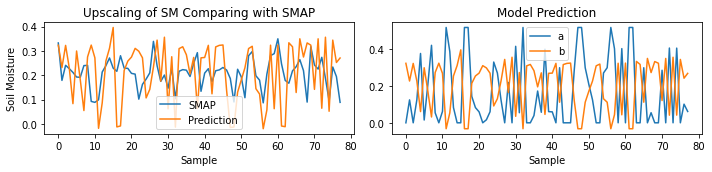

Epoch [163/5000] (LR: 0.00025):
Train loss: 0.0161 || Train physical loss: 0.0161 || Train similarity loss: 0.0000
Valid loss: 0.0152 || Valid physical loss: 0.0152 || Valid similarity loss: 0.0000


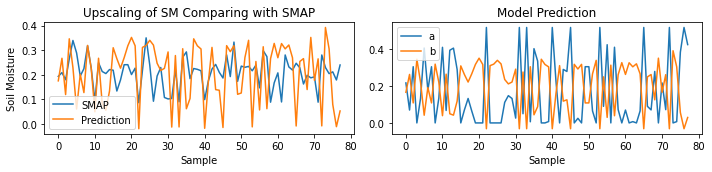

Epoch [164/5000] (LR: 0.00025):
Train loss: 0.3367 || Train physical loss: 0.0159 || Train similarity loss: 0.3208
Valid loss: 0.0148 || Valid physical loss: 0.0148 || Valid similarity loss: 0.0000


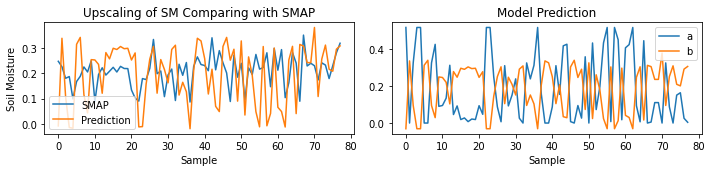

Epoch [165/5000] (LR: 0.00025):
Train loss: 0.1759 || Train physical loss: 0.0158 || Train similarity loss: 0.1601
Valid loss: 0.0144 || Valid physical loss: 0.0144 || Valid similarity loss: 0.0000
Saving model with loss 0.014...


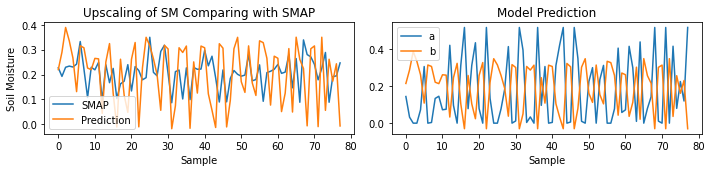

Epoch [166/5000] (LR: 0.00025):
Train loss: 0.1764 || Train physical loss: 0.0160 || Train similarity loss: 0.1604
Valid loss: 0.0149 || Valid physical loss: 0.0149 || Valid similarity loss: 0.0000


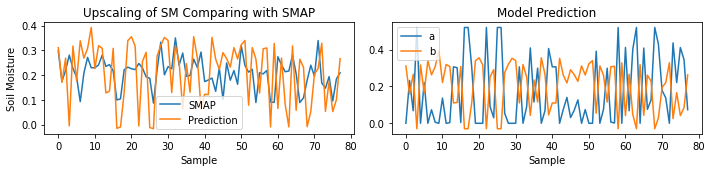

Epoch [167/5000] (LR: 0.00025):
Train loss: 0.1769 || Train physical loss: 0.0159 || Train similarity loss: 0.1610
Valid loss: 0.0149 || Valid physical loss: 0.0149 || Valid similarity loss: 0.0000


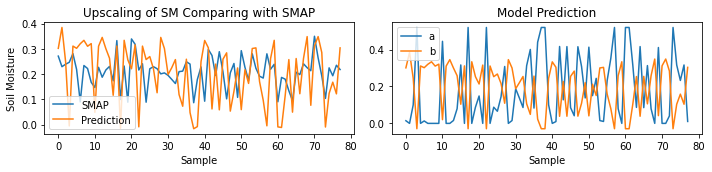

Epoch [168/5000] (LR: 0.00025):
Train loss: 0.0158 || Train physical loss: 0.0158 || Train similarity loss: 0.0000
Valid loss: 0.0146 || Valid physical loss: 0.0146 || Valid similarity loss: 0.0000


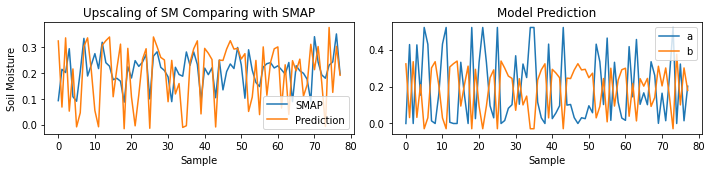

Epoch [169/5000] (LR: 0.00025):
Train loss: 0.1764 || Train physical loss: 0.0156 || Train similarity loss: 0.1608
Valid loss: 0.0142 || Valid physical loss: 0.0142 || Valid similarity loss: 0.0000
Saving model with loss 0.014...


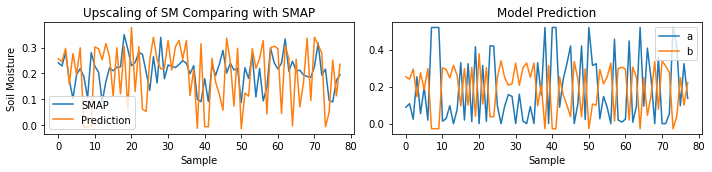

Epoch [170/5000] (LR: 0.00025):
Train loss: 0.1762 || Train physical loss: 0.0154 || Train similarity loss: 0.1608
Valid loss: 0.0141 || Valid physical loss: 0.0141 || Valid similarity loss: 0.0000
Saving model with loss 0.014...


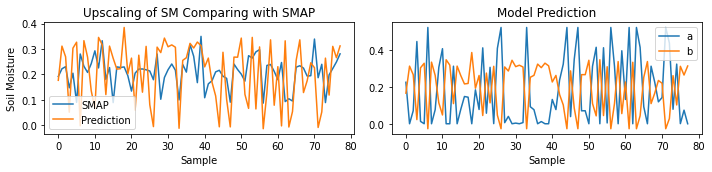

Epoch [171/5000] (LR: 0.00025):
Train loss: 0.1766 || Train physical loss: 0.0154 || Train similarity loss: 0.1613
Valid loss: 0.0145 || Valid physical loss: 0.0145 || Valid similarity loss: 0.0000


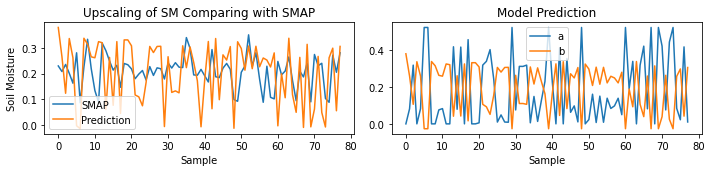

Epoch [172/5000] (LR: 0.00025):
Train loss: 0.1764 || Train physical loss: 0.0154 || Train similarity loss: 0.1611
Valid loss: 0.0142 || Valid physical loss: 0.0142 || Valid similarity loss: 0.0000


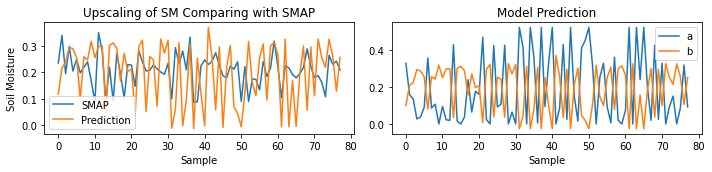

Epoch [173/5000] (LR: 0.00025):
Train loss: 0.0153 || Train physical loss: 0.0153 || Train similarity loss: 0.0000
Valid loss: 0.0139 || Valid physical loss: 0.0139 || Valid similarity loss: 0.0000
Saving model with loss 0.014...


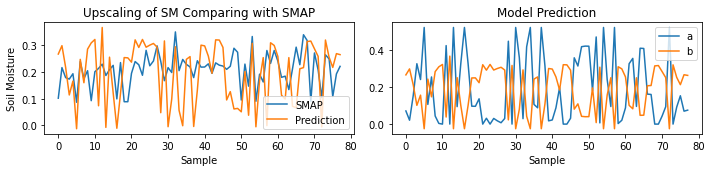

Epoch [174/5000] (LR: 0.00025):
Train loss: 0.0149 || Train physical loss: 0.0149 || Train similarity loss: 0.0000
Valid loss: 0.8148 || Valid physical loss: 0.0135 || Valid similarity loss: 0.8013


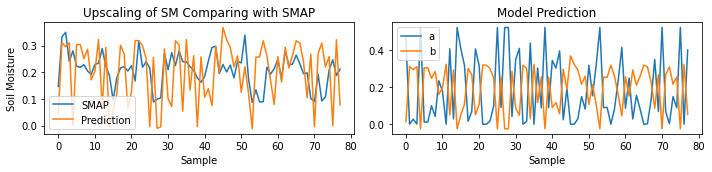

Epoch [175/5000] (LR: 0.00025):
Train loss: 0.1760 || Train physical loss: 0.0147 || Train similarity loss: 0.1613
Valid loss: 0.8157 || Valid physical loss: 0.0132 || Valid similarity loss: 0.8025


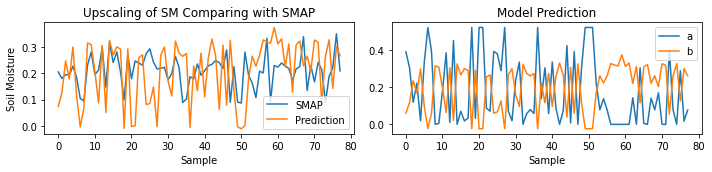

Epoch [176/5000] (LR: 0.00025):
Train loss: 0.1746 || Train physical loss: 0.0144 || Train similarity loss: 0.1602
Valid loss: 0.8164 || Valid physical loss: 0.0132 || Valid similarity loss: 0.8032


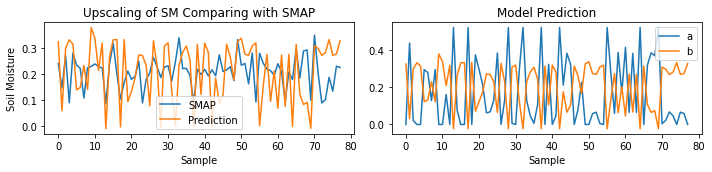

Epoch [177/5000] (LR: 0.00025):
Train loss: 0.3357 || Train physical loss: 0.0146 || Train similarity loss: 0.3212
Valid loss: 0.8166 || Valid physical loss: 0.0135 || Valid similarity loss: 0.8031


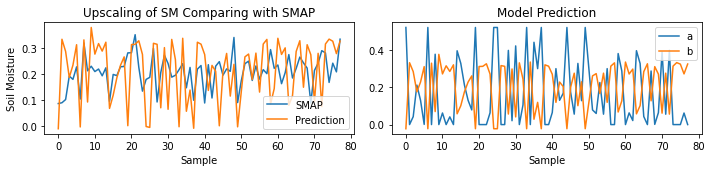

Epoch [178/5000] (LR: 0.00025):
Train loss: 0.3351 || Train physical loss: 0.0146 || Train similarity loss: 0.3206
Valid loss: 0.8149 || Valid physical loss: 0.0138 || Valid similarity loss: 0.8012


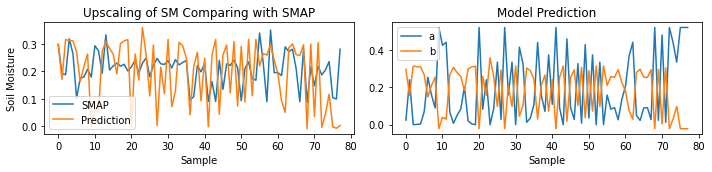

Epoch [179/5000] (LR: 0.00025):
Train loss: 0.3358 || Train physical loss: 0.0148 || Train similarity loss: 0.3210
Valid loss: 0.0136 || Valid physical loss: 0.0136 || Valid similarity loss: 0.0000
Saving model with loss 0.014...


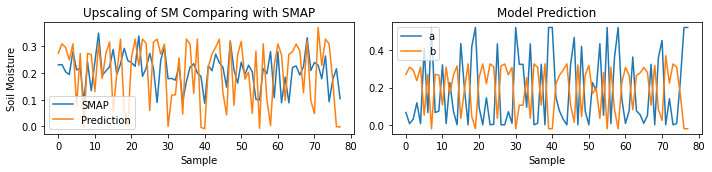

Epoch [180/5000] (LR: 0.00025):
Train loss: 0.1753 || Train physical loss: 0.0152 || Train similarity loss: 0.1601
Valid loss: 0.0143 || Valid physical loss: 0.0143 || Valid similarity loss: 0.0000


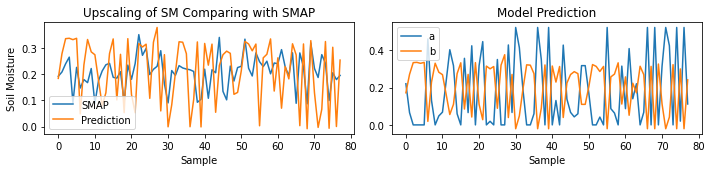

Epoch [181/5000] (LR: 0.00025):
Train loss: 0.0154 || Train physical loss: 0.0154 || Train similarity loss: 0.0000
Valid loss: 0.0145 || Valid physical loss: 0.0145 || Valid similarity loss: 0.0000


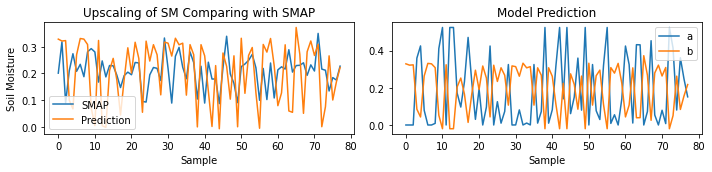

Epoch [182/5000] (LR: 0.00025):
Train loss: 0.1755 || Train physical loss: 0.0152 || Train similarity loss: 0.1603
Valid loss: 0.0140 || Valid physical loss: 0.0140 || Valid similarity loss: 0.0000


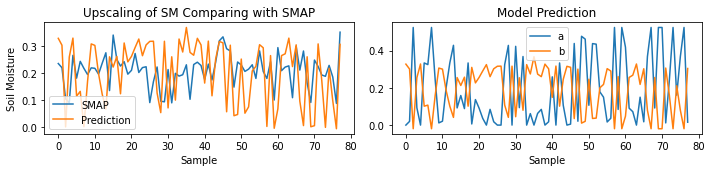

Epoch [183/5000] (LR: 0.00025):
Train loss: 0.1751 || Train physical loss: 0.0149 || Train similarity loss: 0.1601
Valid loss: 0.0137 || Valid physical loss: 0.0137 || Valid similarity loss: 0.0000


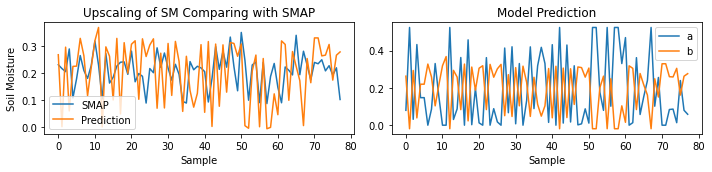

Epoch [184/5000] (LR: 0.00025):
Train loss: 0.0148 || Train physical loss: 0.0148 || Train similarity loss: 0.0000
Valid loss: 0.0137 || Valid physical loss: 0.0137 || Valid similarity loss: 0.0000


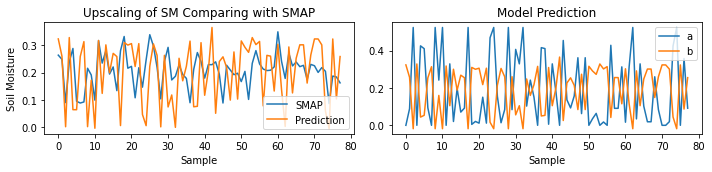

Epoch [185/5000] (LR: 0.00025):
Train loss: 0.0146 || Train physical loss: 0.0146 || Train similarity loss: 0.0000
Valid loss: 0.0133 || Valid physical loss: 0.0133 || Valid similarity loss: 0.0000
Saving model with loss 0.013...


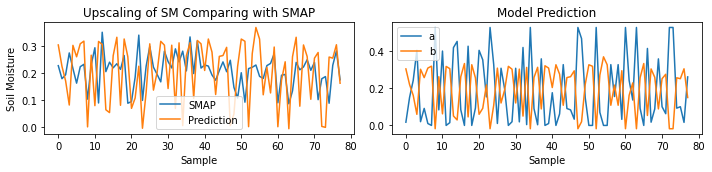

Epoch [186/5000] (LR: 0.00025):
Train loss: 0.1746 || Train physical loss: 0.0142 || Train similarity loss: 0.1603
Valid loss: 0.8137 || Valid physical loss: 0.0131 || Valid similarity loss: 0.8006


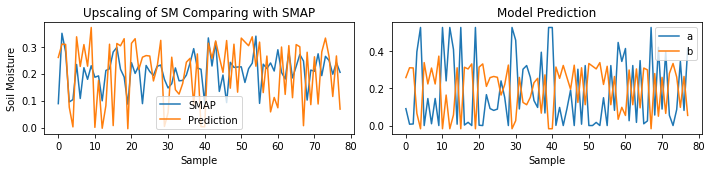

Epoch [187/5000] (LR: 0.00025):
Train loss: 0.1744 || Train physical loss: 0.0142 || Train similarity loss: 0.1602
Valid loss: 0.8137 || Valid physical loss: 0.0131 || Valid similarity loss: 0.8006


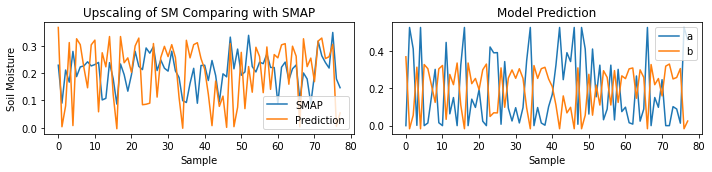

Epoch [188/5000] (LR: 0.00025):
Train loss: 0.0140 || Train physical loss: 0.0140 || Train similarity loss: 0.0000
Valid loss: 0.8148 || Valid physical loss: 0.0127 || Valid similarity loss: 0.8021


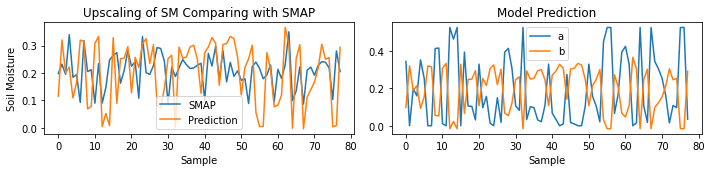

Epoch [189/5000] (LR: 0.00025):
Train loss: 0.1746 || Train physical loss: 0.0138 || Train similarity loss: 0.1608
Valid loss: 0.8151 || Valid physical loss: 0.0126 || Valid similarity loss: 0.8026


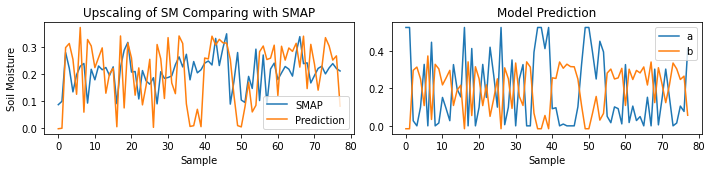

Epoch [190/5000] (LR: 0.00025):
Train loss: 0.3362 || Train physical loss: 0.0137 || Train similarity loss: 0.3225
Valid loss: 0.8135 || Valid physical loss: 0.0130 || Valid similarity loss: 0.8005


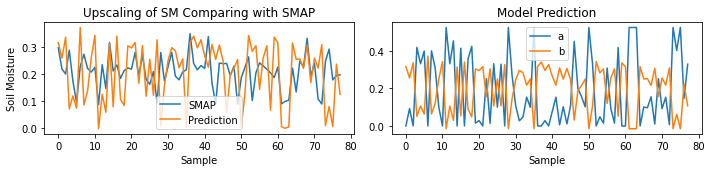

Epoch [191/5000] (LR: 0.00025):
Train loss: 0.1740 || Train physical loss: 0.0140 || Train similarity loss: 0.1601
Valid loss: 0.0131 || Valid physical loss: 0.0131 || Valid similarity loss: 0.0000
Saving model with loss 0.013...


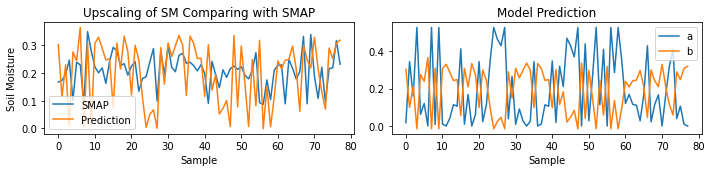

Epoch [192/5000] (LR: 0.00025):
Train loss: 0.1757 || Train physical loss: 0.0139 || Train similarity loss: 0.1618
Valid loss: 0.8130 || Valid physical loss: 0.0128 || Valid similarity loss: 0.8002


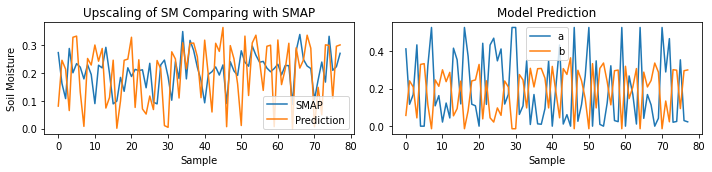

Epoch [193/5000] (LR: 0.00025):
Train loss: 0.1748 || Train physical loss: 0.0139 || Train similarity loss: 0.1609
Valid loss: 0.0128 || Valid physical loss: 0.0128 || Valid similarity loss: 0.0000
Saving model with loss 0.013...


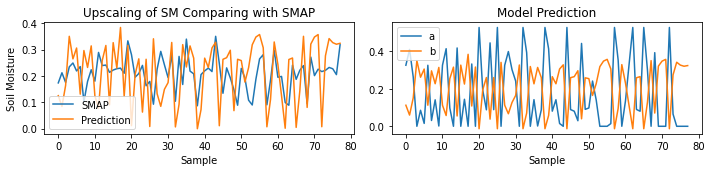

Epoch [194/5000] (LR: 0.00025):
Train loss: 0.1744 || Train physical loss: 0.0141 || Train similarity loss: 0.1603
Valid loss: 0.0137 || Valid physical loss: 0.0137 || Valid similarity loss: 0.0000


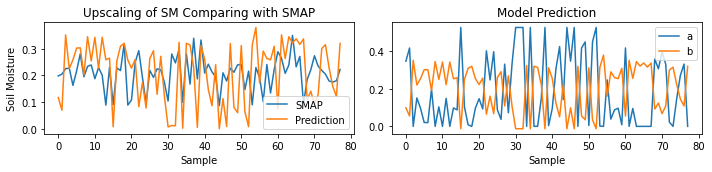

Epoch [195/5000] (LR: 0.00025):
Train loss: 0.1745 || Train physical loss: 0.0142 || Train similarity loss: 0.1603
Valid loss: 0.0134 || Valid physical loss: 0.0134 || Valid similarity loss: 0.0000


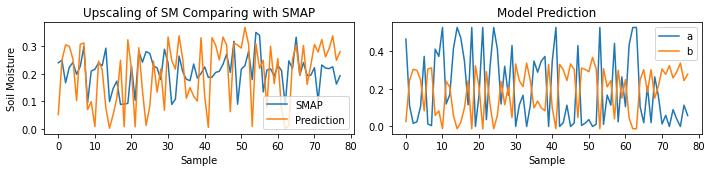

Epoch [196/5000] (LR: 0.00025):
Train loss: 0.0140 || Train physical loss: 0.0140 || Train similarity loss: 0.0000
Valid loss: 0.0129 || Valid physical loss: 0.0129 || Valid similarity loss: 0.0000


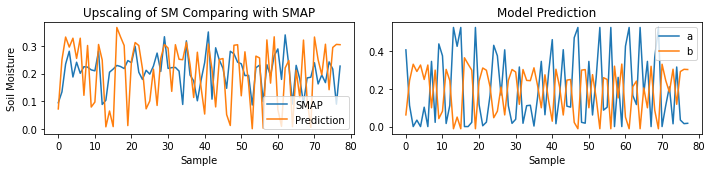

Epoch [197/5000] (LR: 0.00025):
Train loss: 0.1740 || Train physical loss: 0.0138 || Train similarity loss: 0.1602
Valid loss: 0.0127 || Valid physical loss: 0.0127 || Valid similarity loss: 0.0000
Saving model with loss 0.013...


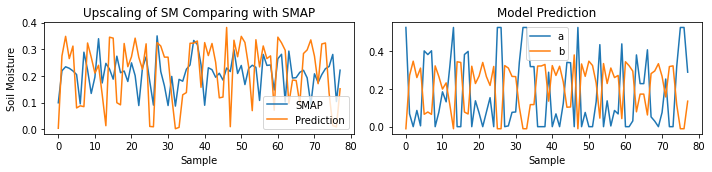

Epoch [198/5000] (LR: 0.00025):
Train loss: 0.1744 || Train physical loss: 0.0137 || Train similarity loss: 0.1606
Valid loss: 0.0134 || Valid physical loss: 0.0134 || Valid similarity loss: 0.0000


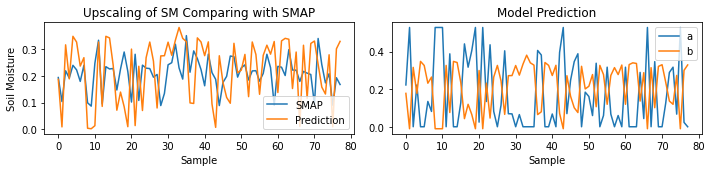

Epoch [199/5000] (LR: 0.00025):
Train loss: 0.1751 || Train physical loss: 0.0141 || Train similarity loss: 0.1610
Valid loss: 0.0136 || Valid physical loss: 0.0136 || Valid similarity loss: 0.0000


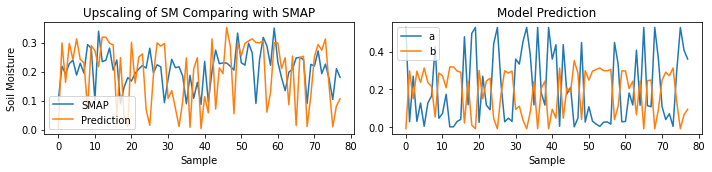

Epoch [200/5000] (LR: 0.00025):
Train loss: 0.1756 || Train physical loss: 0.0139 || Train similarity loss: 0.1616
Valid loss: 0.0125 || Valid physical loss: 0.0125 || Valid similarity loss: 0.0000
Saving model with loss 0.013...


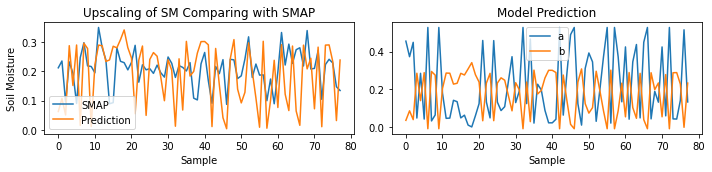

Epoch [201/5000] (LR: 0.00025):
Train loss: 0.0139 || Train physical loss: 0.0139 || Train similarity loss: 0.0000
Valid loss: 0.0123 || Valid physical loss: 0.0123 || Valid similarity loss: 0.0000
Saving model with loss 0.012...


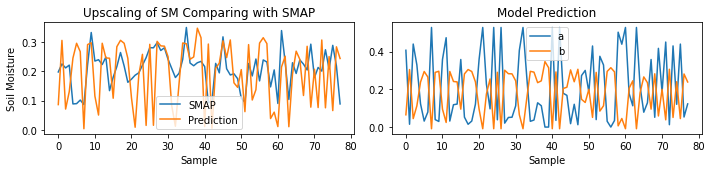

Epoch [202/5000] (LR: 0.00025):
Train loss: 0.0137 || Train physical loss: 0.0137 || Train similarity loss: 0.0000
Valid loss: 0.0120 || Valid physical loss: 0.0120 || Valid similarity loss: 0.0000
Saving model with loss 0.012...


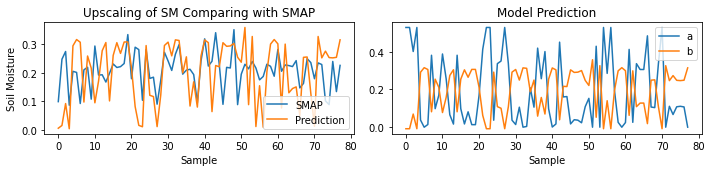

Epoch [203/5000] (LR: 0.00025):
Train loss: 0.0132 || Train physical loss: 0.0132 || Train similarity loss: 0.0000
Valid loss: 0.0118 || Valid physical loss: 0.0118 || Valid similarity loss: 0.0000
Saving model with loss 0.012...


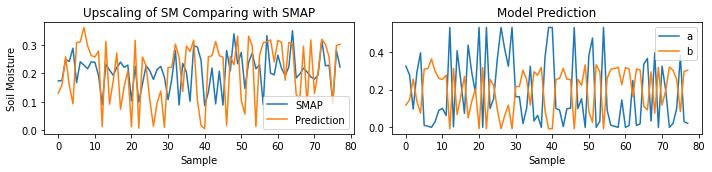

Epoch [204/5000] (LR: 0.00025):
Train loss: 0.0128 || Train physical loss: 0.0128 || Train similarity loss: 0.0000
Valid loss: 0.0116 || Valid physical loss: 0.0116 || Valid similarity loss: 0.0000
Saving model with loss 0.012...


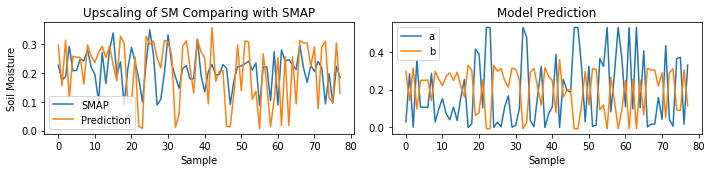

Epoch [205/5000] (LR: 0.00025):
Train loss: 0.0124 || Train physical loss: 0.0124 || Train similarity loss: 0.0000
Valid loss: 0.0111 || Valid physical loss: 0.0111 || Valid similarity loss: 0.0000
Saving model with loss 0.011...


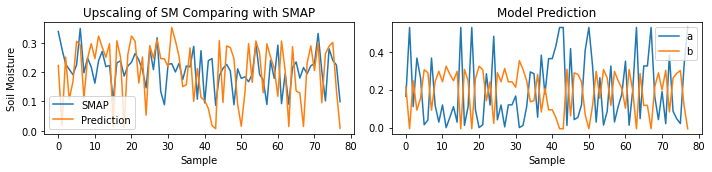

Epoch [206/5000] (LR: 0.00025):
Train loss: 0.0120 || Train physical loss: 0.0120 || Train similarity loss: 0.0000
Valid loss: 0.0106 || Valid physical loss: 0.0106 || Valid similarity loss: 0.0000
Saving model with loss 0.011...


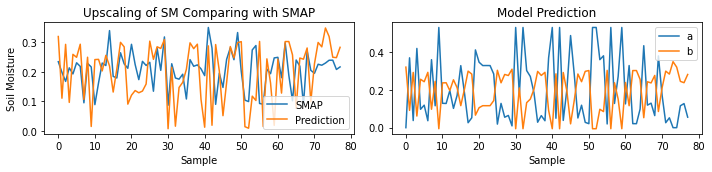

Epoch [207/5000] (LR: 0.00025):
Train loss: 0.0117 || Train physical loss: 0.0117 || Train similarity loss: 0.0000
Valid loss: 0.0102 || Valid physical loss: 0.0102 || Valid similarity loss: 0.0000
Saving model with loss 0.010...


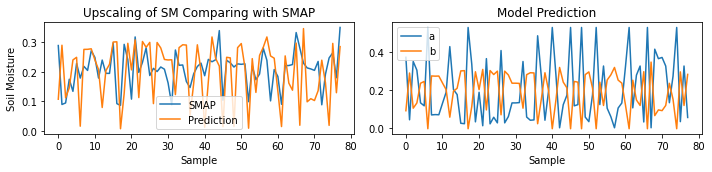

Epoch [208/5000] (LR: 0.00025):
Train loss: 0.0112 || Train physical loss: 0.0112 || Train similarity loss: 0.0000
Valid loss: 0.0099 || Valid physical loss: 0.0099 || Valid similarity loss: 0.0000
Saving model with loss 0.010...


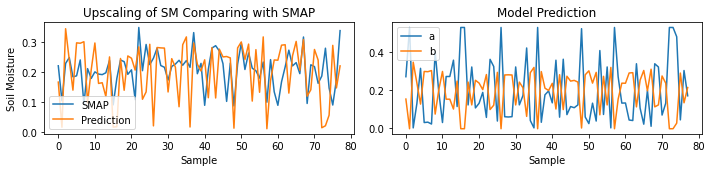

Epoch [209/5000] (LR: 0.00025):
Train loss: 0.0110 || Train physical loss: 0.0110 || Train similarity loss: 0.0000
Valid loss: 0.0097 || Valid physical loss: 0.0097 || Valid similarity loss: 0.0000
Saving model with loss 0.010...


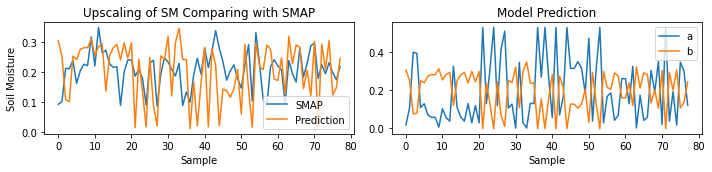

Epoch [210/5000] (LR: 0.00025):
Train loss: 0.0107 || Train physical loss: 0.0107 || Train similarity loss: 0.0000
Valid loss: 0.0095 || Valid physical loss: 0.0095 || Valid similarity loss: 0.0000
Saving model with loss 0.009...


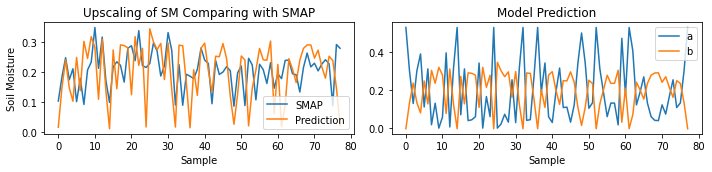

Epoch [211/5000] (LR: 0.00025):
Train loss: 0.0104 || Train physical loss: 0.0104 || Train similarity loss: 0.0000
Valid loss: 0.0092 || Valid physical loss: 0.0092 || Valid similarity loss: 0.0000
Saving model with loss 0.009...


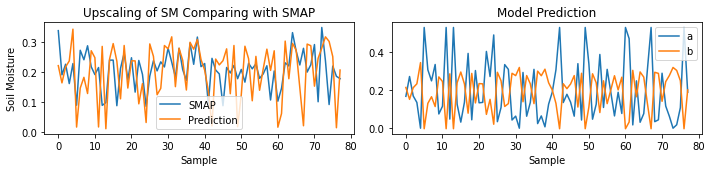

Epoch [212/5000] (LR: 0.00025):
Train loss: 0.0102 || Train physical loss: 0.0102 || Train similarity loss: 0.0000
Valid loss: 0.0089 || Valid physical loss: 0.0089 || Valid similarity loss: 0.0000
Saving model with loss 0.009...


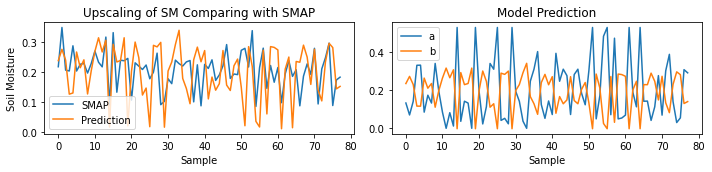

Epoch [213/5000] (LR: 0.00025):
Train loss: 0.0100 || Train physical loss: 0.0100 || Train similarity loss: 0.0000
Valid loss: 0.0087 || Valid physical loss: 0.0087 || Valid similarity loss: 0.0000
Saving model with loss 0.009...


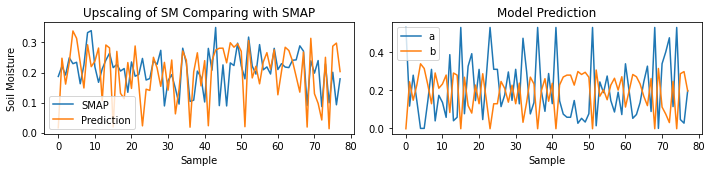

Epoch [214/5000] (LR: 0.00025):
Train loss: 0.0096 || Train physical loss: 0.0096 || Train similarity loss: 0.0000
Valid loss: 0.0085 || Valid physical loss: 0.0085 || Valid similarity loss: 0.0000
Saving model with loss 0.008...


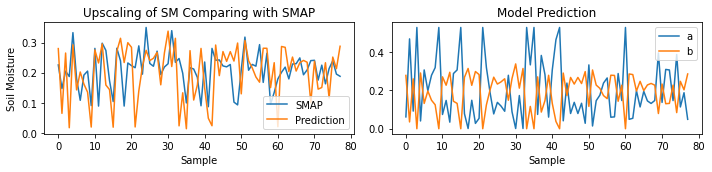

Epoch [215/5000] (LR: 0.00025):
Train loss: 0.0095 || Train physical loss: 0.0095 || Train similarity loss: 0.0000
Valid loss: 0.0083 || Valid physical loss: 0.0083 || Valid similarity loss: 0.0000
Saving model with loss 0.008...


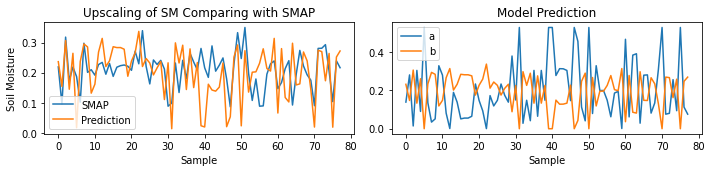

Epoch [216/5000] (LR: 0.00025):
Train loss: 0.0093 || Train physical loss: 0.0093 || Train similarity loss: 0.0000
Valid loss: 0.0081 || Valid physical loss: 0.0081 || Valid similarity loss: 0.0000
Saving model with loss 0.008...


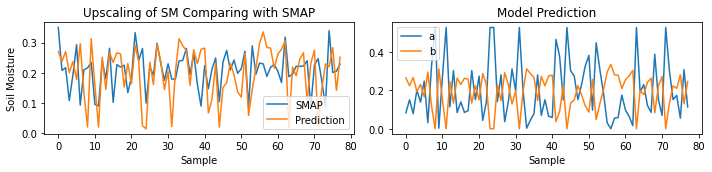

Epoch [217/5000] (LR: 0.00025):
Train loss: 0.0091 || Train physical loss: 0.0091 || Train similarity loss: 0.0000
Valid loss: 0.0080 || Valid physical loss: 0.0080 || Valid similarity loss: 0.0000
Saving model with loss 0.008...


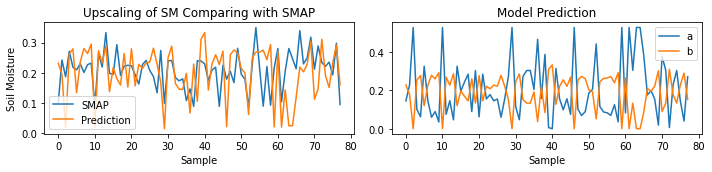

Epoch [218/5000] (LR: 0.00025):
Train loss: 0.0090 || Train physical loss: 0.0090 || Train similarity loss: 0.0000
Valid loss: 0.0078 || Valid physical loss: 0.0078 || Valid similarity loss: 0.0000
Saving model with loss 0.008...


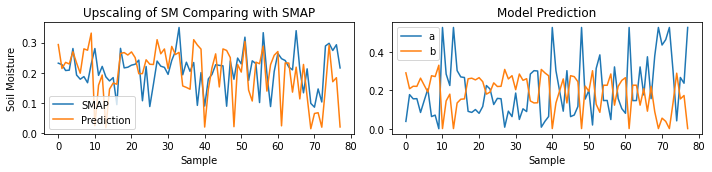

Epoch [219/5000] (LR: 0.00025):
Train loss: 0.0088 || Train physical loss: 0.0088 || Train similarity loss: 0.0000
Valid loss: 0.0077 || Valid physical loss: 0.0077 || Valid similarity loss: 0.0000
Saving model with loss 0.008...


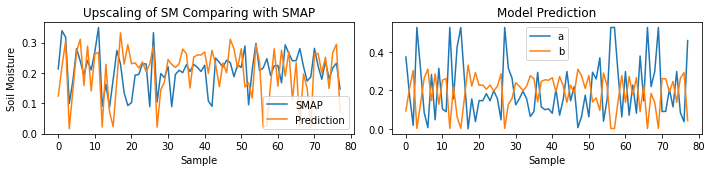

Epoch [220/5000] (LR: 0.00025):
Train loss: 0.0087 || Train physical loss: 0.0087 || Train similarity loss: 0.0000
Valid loss: 0.0076 || Valid physical loss: 0.0076 || Valid similarity loss: 0.0000
Saving model with loss 0.008...


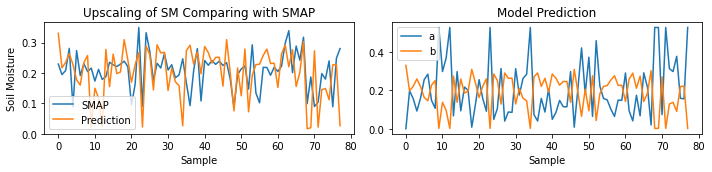

Epoch [221/5000] (LR: 0.00025):
Train loss: 0.0086 || Train physical loss: 0.0086 || Train similarity loss: 0.0000
Valid loss: 0.0074 || Valid physical loss: 0.0074 || Valid similarity loss: 0.0000
Saving model with loss 0.007...


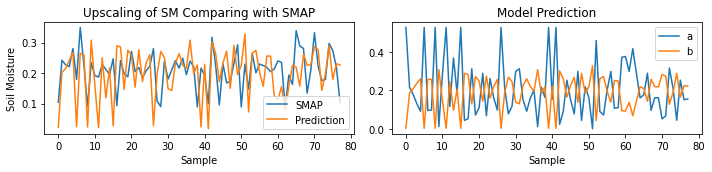

Epoch [222/5000] (LR: 0.00025):
Train loss: 0.0084 || Train physical loss: 0.0084 || Train similarity loss: 0.0000
Valid loss: 0.0073 || Valid physical loss: 0.0073 || Valid similarity loss: 0.0000
Saving model with loss 0.007...


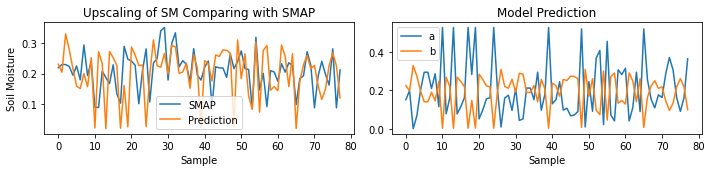

Epoch [223/5000] (LR: 0.00025):
Train loss: 0.0083 || Train physical loss: 0.0083 || Train similarity loss: 0.0000
Valid loss: 0.0072 || Valid physical loss: 0.0072 || Valid similarity loss: 0.0000
Saving model with loss 0.007...


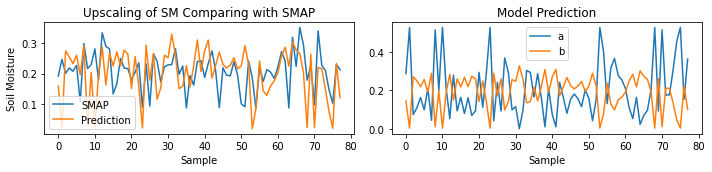

Epoch [224/5000] (LR: 0.00025):
Train loss: 0.0082 || Train physical loss: 0.0082 || Train similarity loss: 0.0000
Valid loss: 0.0071 || Valid physical loss: 0.0071 || Valid similarity loss: 0.0000
Saving model with loss 0.007...


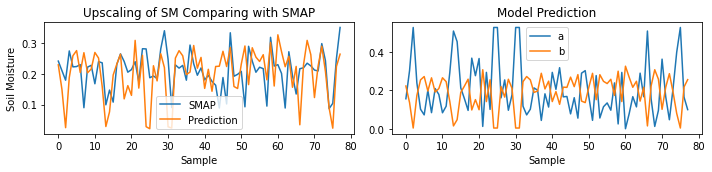

Epoch [225/5000] (LR: 0.00025):
Train loss: 0.0081 || Train physical loss: 0.0081 || Train similarity loss: 0.0000
Valid loss: 0.0070 || Valid physical loss: 0.0070 || Valid similarity loss: 0.0000
Saving model with loss 0.007...


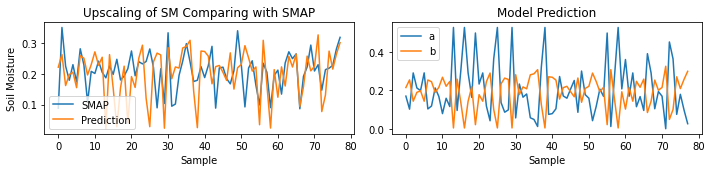

Epoch [226/5000] (LR: 0.00025):
Train loss: 0.0080 || Train physical loss: 0.0080 || Train similarity loss: 0.0000
Valid loss: 0.0068 || Valid physical loss: 0.0068 || Valid similarity loss: 0.0000
Saving model with loss 0.007...


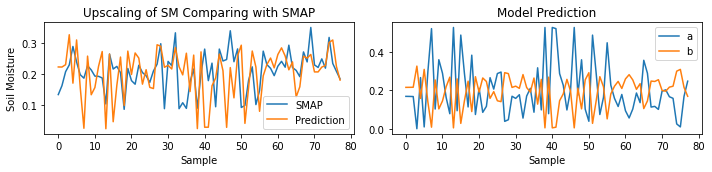

Epoch [227/5000] (LR: 0.00025):
Train loss: 0.0078 || Train physical loss: 0.0078 || Train similarity loss: 0.0000
Valid loss: 0.0067 || Valid physical loss: 0.0067 || Valid similarity loss: 0.0000
Saving model with loss 0.007...


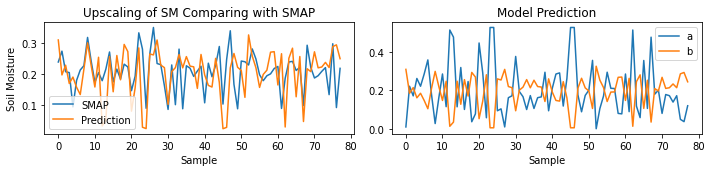

Epoch [228/5000] (LR: 0.00025):
Train loss: 0.0077 || Train physical loss: 0.0077 || Train similarity loss: 0.0000
Valid loss: 0.0066 || Valid physical loss: 0.0066 || Valid similarity loss: 0.0000
Saving model with loss 0.007...


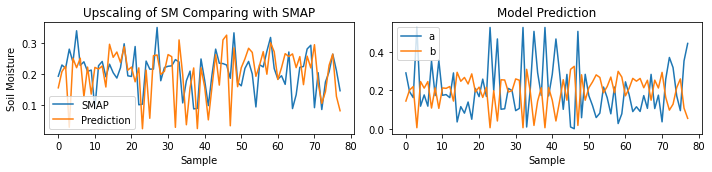

Epoch [229/5000] (LR: 0.00025):
Train loss: 0.0076 || Train physical loss: 0.0076 || Train similarity loss: 0.0000
Valid loss: 0.0065 || Valid physical loss: 0.0065 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


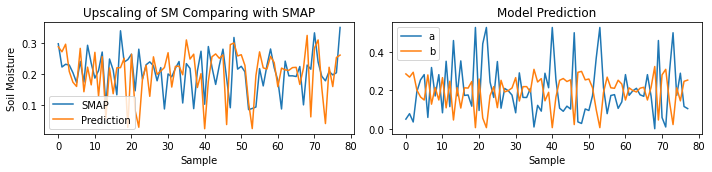

Epoch [230/5000] (LR: 0.00025):
Train loss: 0.0075 || Train physical loss: 0.0075 || Train similarity loss: 0.0000
Valid loss: 0.0064 || Valid physical loss: 0.0064 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


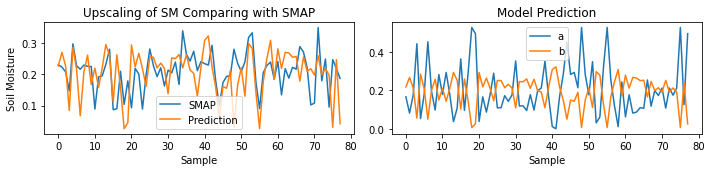

Epoch [231/5000] (LR: 0.00025):
Train loss: 0.0073 || Train physical loss: 0.0073 || Train similarity loss: 0.0000
Valid loss: 0.0062 || Valid physical loss: 0.0062 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


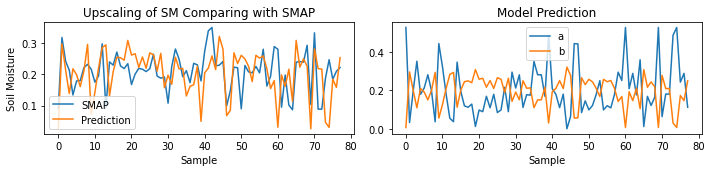

Epoch [232/5000] (LR: 0.00025):
Train loss: 0.0073 || Train physical loss: 0.0073 || Train similarity loss: 0.0000
Valid loss: 0.0061 || Valid physical loss: 0.0061 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


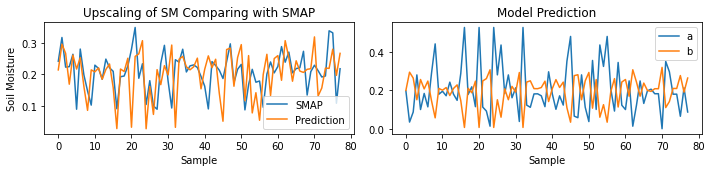

Epoch [233/5000] (LR: 0.00025):
Train loss: 0.0072 || Train physical loss: 0.0072 || Train similarity loss: 0.0000
Valid loss: 0.0060 || Valid physical loss: 0.0060 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


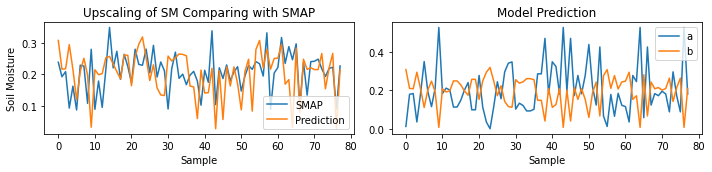

Epoch [234/5000] (LR: 0.00025):
Train loss: 0.0072 || Train physical loss: 0.0072 || Train similarity loss: 0.0000
Valid loss: 0.0059 || Valid physical loss: 0.0059 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


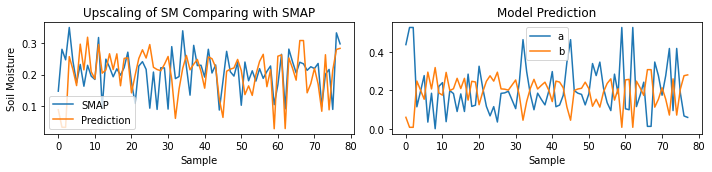

Epoch [235/5000] (LR: 0.00025):
Train loss: 0.0070 || Train physical loss: 0.0070 || Train similarity loss: 0.0000
Valid loss: 0.0058 || Valid physical loss: 0.0058 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


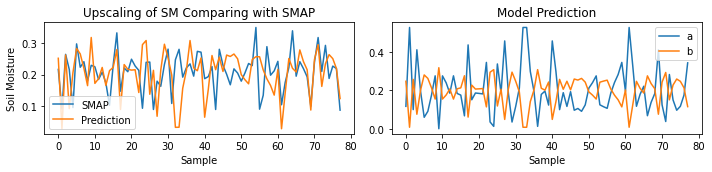

Epoch [236/5000] (LR: 0.00025):
Train loss: 0.0069 || Train physical loss: 0.0069 || Train similarity loss: 0.0000
Valid loss: 0.0057 || Valid physical loss: 0.0057 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


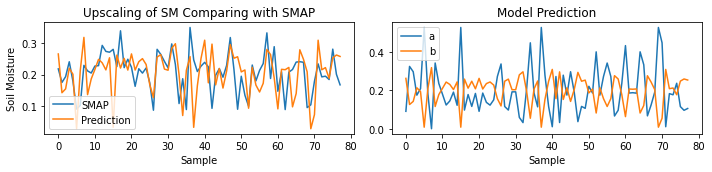

Epoch [237/5000] (LR: 0.00025):
Train loss: 0.0068 || Train physical loss: 0.0068 || Train similarity loss: 0.0000
Valid loss: 0.0057 || Valid physical loss: 0.0057 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


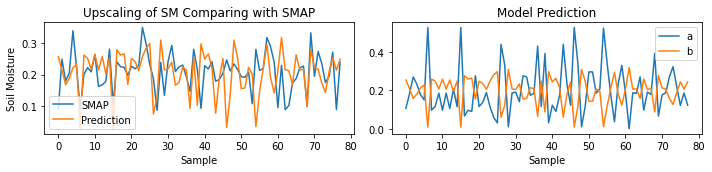

Epoch [238/5000] (LR: 0.00025):
Train loss: 0.0067 || Train physical loss: 0.0067 || Train similarity loss: 0.0000
Valid loss: 0.0056 || Valid physical loss: 0.0056 || Valid similarity loss: 0.0000
Saving model with loss 0.006...


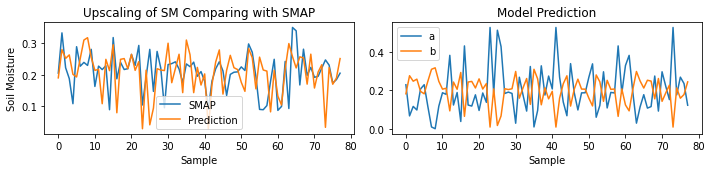

Epoch [239/5000] (LR: 0.00025):
Train loss: 0.0067 || Train physical loss: 0.0067 || Train similarity loss: 0.0000
Valid loss: 0.0055 || Valid physical loss: 0.0055 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


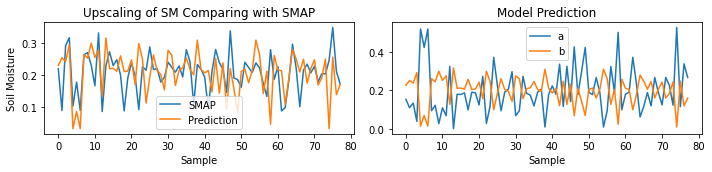

Epoch [240/5000] (LR: 0.00025):
Train loss: 0.0066 || Train physical loss: 0.0066 || Train similarity loss: 0.0000
Valid loss: 0.0054 || Valid physical loss: 0.0054 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


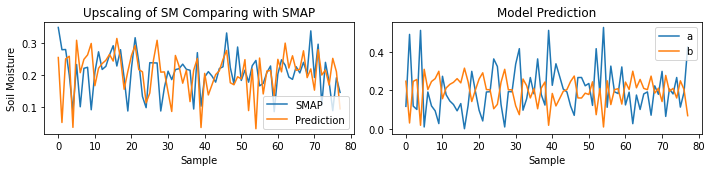

Epoch [241/5000] (LR: 0.00025):
Train loss: 0.0064 || Train physical loss: 0.0064 || Train similarity loss: 0.0000
Valid loss: 0.0053 || Valid physical loss: 0.0053 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


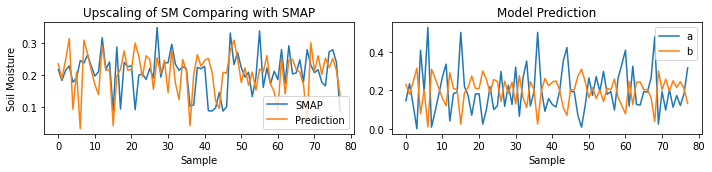

Epoch [242/5000] (LR: 0.00025):
Train loss: 0.0063 || Train physical loss: 0.0063 || Train similarity loss: 0.0000
Valid loss: 0.0051 || Valid physical loss: 0.0051 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


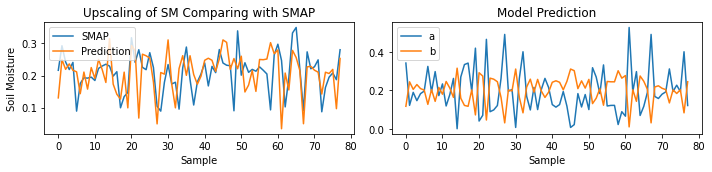

Epoch [243/5000] (LR: 0.00025):
Train loss: 0.0063 || Train physical loss: 0.0063 || Train similarity loss: 0.0000
Valid loss: 0.0051 || Valid physical loss: 0.0051 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


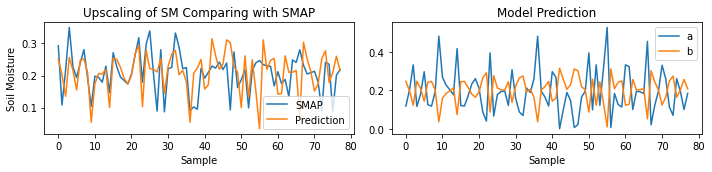

Epoch [244/5000] (LR: 0.00025):
Train loss: 0.0061 || Train physical loss: 0.0061 || Train similarity loss: 0.0000
Valid loss: 0.0050 || Valid physical loss: 0.0050 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


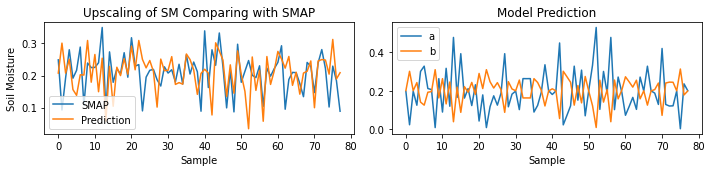

Epoch [245/5000] (LR: 0.00025):
Train loss: 0.0060 || Train physical loss: 0.0060 || Train similarity loss: 0.0000
Valid loss: 0.0049 || Valid physical loss: 0.0049 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


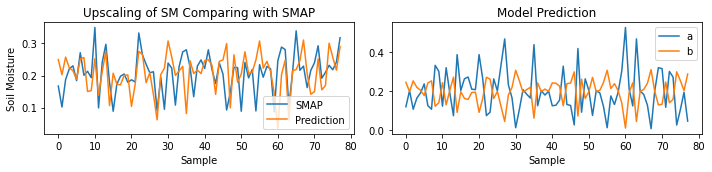

Epoch [246/5000] (LR: 0.00025):
Train loss: 0.0060 || Train physical loss: 0.0060 || Train similarity loss: 0.0000
Valid loss: 0.0048 || Valid physical loss: 0.0048 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


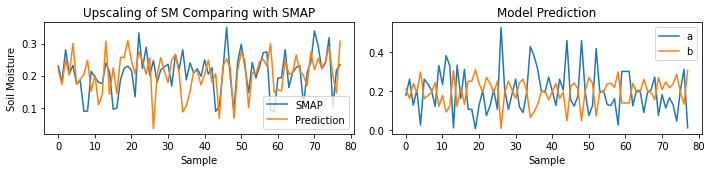

Epoch [247/5000] (LR: 0.00025):
Train loss: 0.0059 || Train physical loss: 0.0059 || Train similarity loss: 0.0000
Valid loss: 0.0047 || Valid physical loss: 0.0047 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


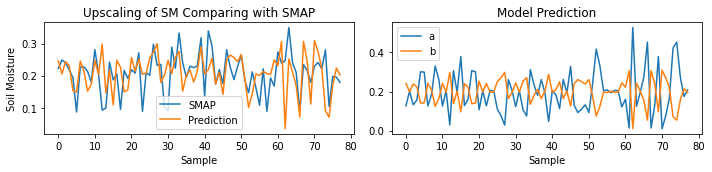

Epoch [248/5000] (LR: 0.00025):
Train loss: 0.0058 || Train physical loss: 0.0058 || Train similarity loss: 0.0000
Valid loss: 0.0046 || Valid physical loss: 0.0046 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


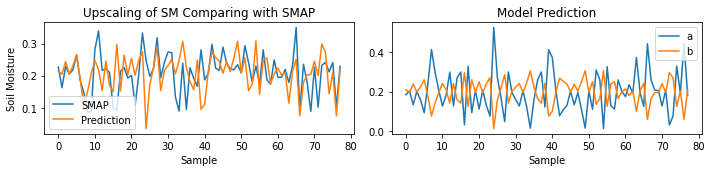

Epoch [249/5000] (LR: 0.00025):
Train loss: 0.0057 || Train physical loss: 0.0057 || Train similarity loss: 0.0000
Valid loss: 0.0046 || Valid physical loss: 0.0046 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


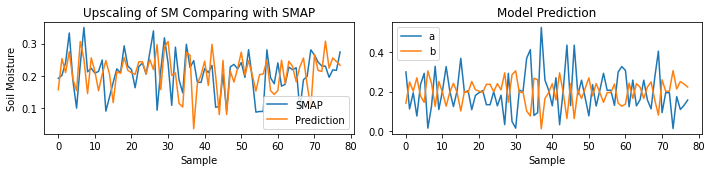

Epoch [250/5000] (LR: 0.00025):
Train loss: 0.0057 || Train physical loss: 0.0057 || Train similarity loss: 0.0000
Valid loss: 0.0045 || Valid physical loss: 0.0045 || Valid similarity loss: 0.0000
Saving model with loss 0.005...


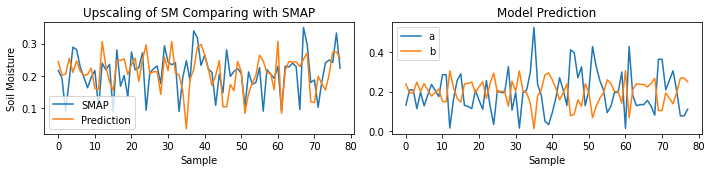

Epoch [251/5000] (LR: 0.00025):
Train loss: 0.0056 || Train physical loss: 0.0056 || Train similarity loss: 0.0000
Valid loss: 0.0045 || Valid physical loss: 0.0045 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


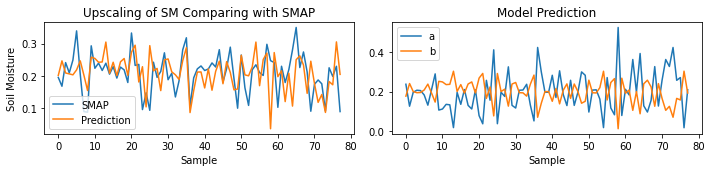

Epoch [252/5000] (LR: 0.00025):
Train loss: 0.0056 || Train physical loss: 0.0056 || Train similarity loss: 0.0000
Valid loss: 0.0044 || Valid physical loss: 0.0044 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


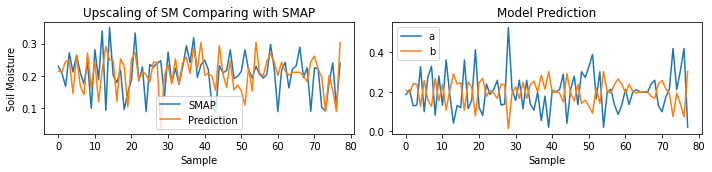

Epoch [253/5000] (LR: 0.00025):
Train loss: 0.0055 || Train physical loss: 0.0055 || Train similarity loss: 0.0000
Valid loss: 0.0043 || Valid physical loss: 0.0043 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


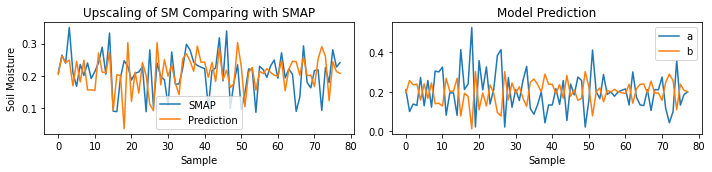

Epoch [254/5000] (LR: 0.00025):
Train loss: 0.0054 || Train physical loss: 0.0054 || Train similarity loss: 0.0000
Valid loss: 0.0043 || Valid physical loss: 0.0043 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


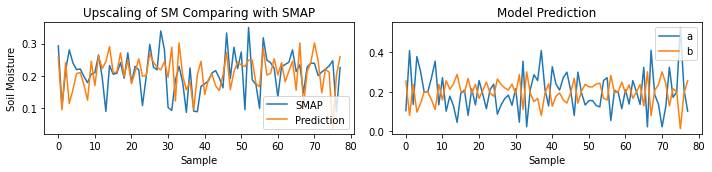

Epoch [255/5000] (LR: 0.00025):
Train loss: 0.0054 || Train physical loss: 0.0054 || Train similarity loss: 0.0000
Valid loss: 0.0043 || Valid physical loss: 0.0043 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


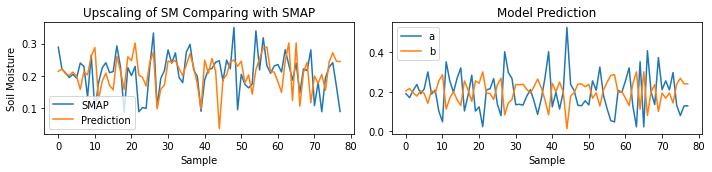

Epoch [256/5000] (LR: 0.00025):
Train loss: 0.0053 || Train physical loss: 0.0053 || Train similarity loss: 0.0000
Valid loss: 0.0042 || Valid physical loss: 0.0042 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


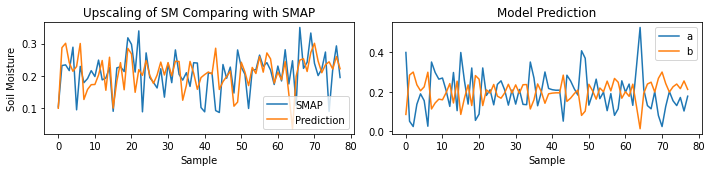

Epoch [257/5000] (LR: 0.00025):
Train loss: 0.0053 || Train physical loss: 0.0053 || Train similarity loss: 0.0000
Valid loss: 0.0042 || Valid physical loss: 0.0042 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


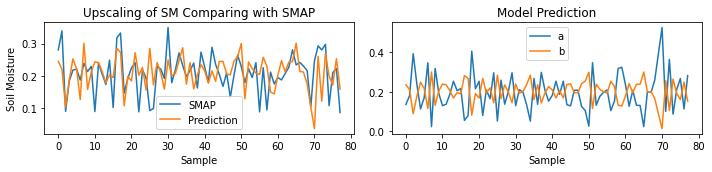

Epoch [258/5000] (LR: 0.00025):
Train loss: 0.0052 || Train physical loss: 0.0052 || Train similarity loss: 0.0000
Valid loss: 0.0041 || Valid physical loss: 0.0041 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


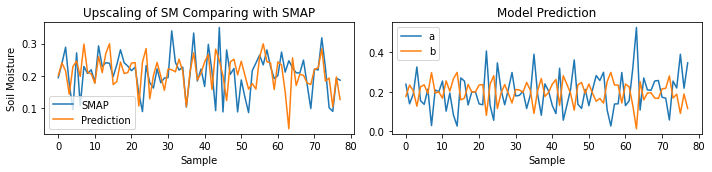

Epoch [259/5000] (LR: 0.00025):
Train loss: 0.0052 || Train physical loss: 0.0052 || Train similarity loss: 0.0000
Valid loss: 0.0041 || Valid physical loss: 0.0041 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


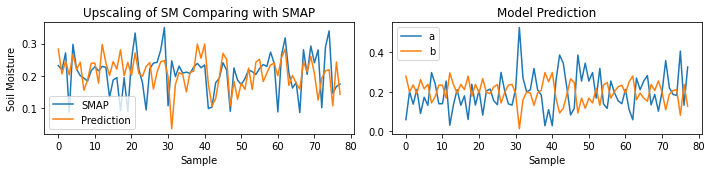

Epoch [260/5000] (LR: 0.00025):
Train loss: 0.0052 || Train physical loss: 0.0052 || Train similarity loss: 0.0000
Valid loss: 0.0041 || Valid physical loss: 0.0041 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


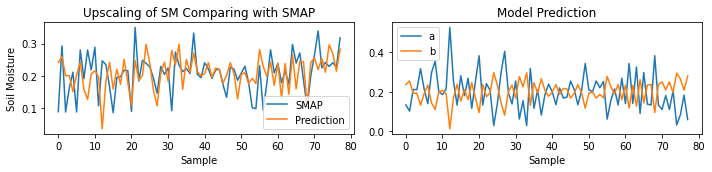

Epoch [261/5000] (LR: 0.00025):
Train loss: 0.0051 || Train physical loss: 0.0051 || Train similarity loss: 0.0000
Valid loss: 0.0040 || Valid physical loss: 0.0040 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


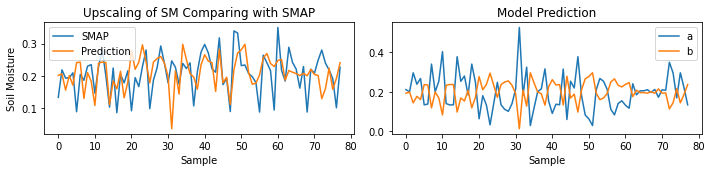

Epoch [262/5000] (LR: 0.00025):
Train loss: 0.0051 || Train physical loss: 0.0051 || Train similarity loss: 0.0000
Valid loss: 0.0040 || Valid physical loss: 0.0040 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


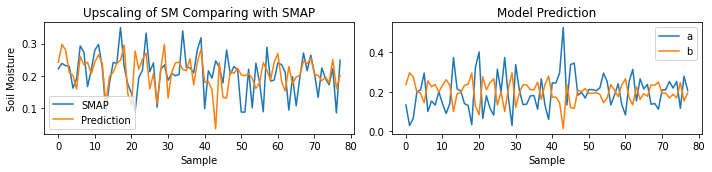

Epoch [263/5000] (LR: 0.00025):
Train loss: 0.0051 || Train physical loss: 0.0051 || Train similarity loss: 0.0000
Valid loss: 0.0040 || Valid physical loss: 0.0040 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


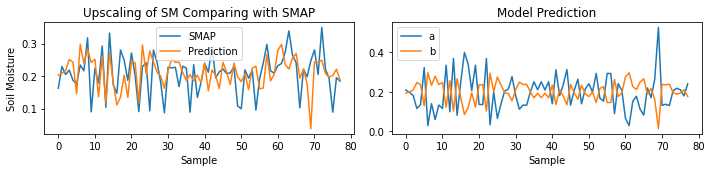

Epoch [264/5000] (LR: 0.00025):
Train loss: 0.0050 || Train physical loss: 0.0050 || Train similarity loss: 0.0000
Valid loss: 0.0040 || Valid physical loss: 0.0040 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


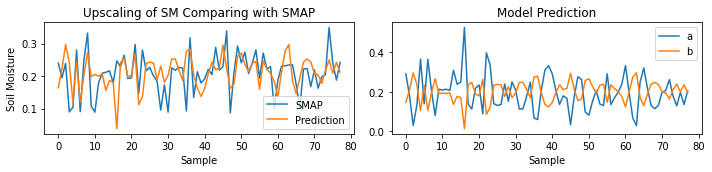

Epoch [265/5000] (LR: 0.00025):
Train loss: 0.0051 || Train physical loss: 0.0051 || Train similarity loss: 0.0000
Valid loss: 0.0039 || Valid physical loss: 0.0039 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


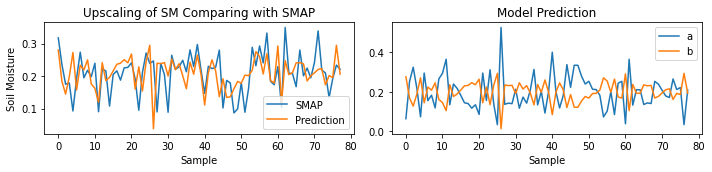

Epoch [266/5000] (LR: 0.00025):
Train loss: 0.0050 || Train physical loss: 0.0050 || Train similarity loss: 0.0000
Valid loss: 0.0039 || Valid physical loss: 0.0039 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


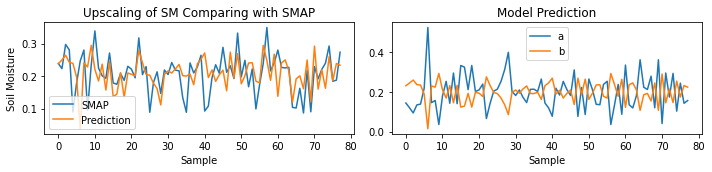

Epoch [267/5000] (LR: 0.00025):
Train loss: 0.0049 || Train physical loss: 0.0049 || Train similarity loss: 0.0000
Valid loss: 0.0039 || Valid physical loss: 0.0039 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


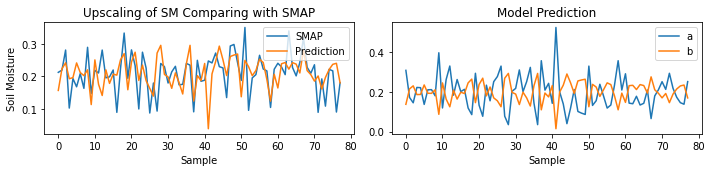

Epoch [268/5000] (LR: 0.00025):
Train loss: 0.0049 || Train physical loss: 0.0049 || Train similarity loss: 0.0000
Valid loss: 0.0039 || Valid physical loss: 0.0039 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


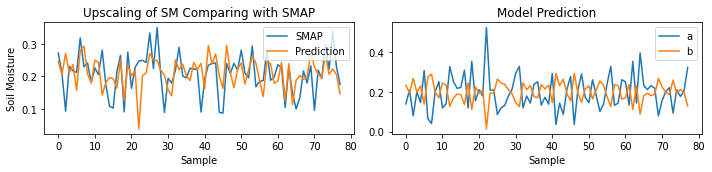

Epoch [269/5000] (LR: 0.00025):
Train loss: 0.0049 || Train physical loss: 0.0049 || Train similarity loss: 0.0000
Valid loss: 0.0038 || Valid physical loss: 0.0038 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


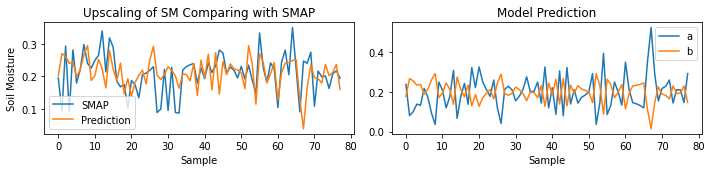

Epoch [270/5000] (LR: 0.00025):
Train loss: 0.0049 || Train physical loss: 0.0049 || Train similarity loss: 0.0000
Valid loss: 0.0038 || Valid physical loss: 0.0038 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


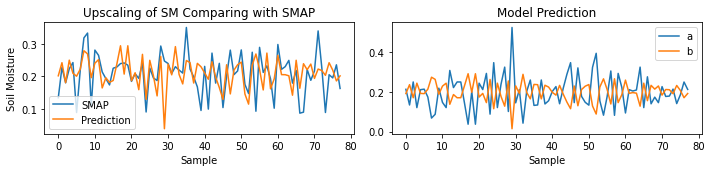

Epoch [271/5000] (LR: 0.00025):
Train loss: 0.0048 || Train physical loss: 0.0048 || Train similarity loss: 0.0000
Valid loss: 0.0038 || Valid physical loss: 0.0038 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


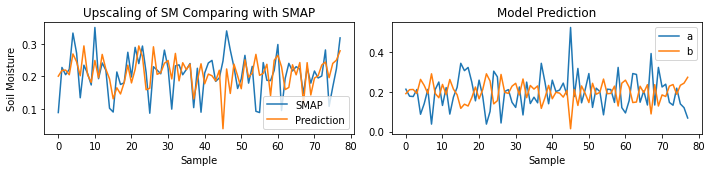

Epoch [272/5000] (LR: 0.00025):
Train loss: 0.0049 || Train physical loss: 0.0049 || Train similarity loss: 0.0000
Valid loss: 0.0038 || Valid physical loss: 0.0038 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


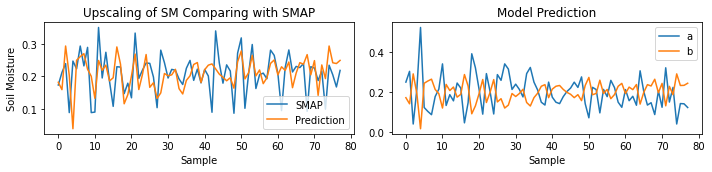

Epoch [273/5000] (LR: 0.00025):
Train loss: 0.0048 || Train physical loss: 0.0048 || Train similarity loss: 0.0000
Valid loss: 0.0038 || Valid physical loss: 0.0038 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


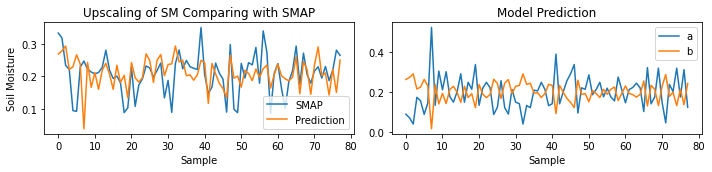

Epoch [274/5000] (LR: 0.00025):
Train loss: 0.0048 || Train physical loss: 0.0048 || Train similarity loss: 0.0000
Valid loss: 0.0037 || Valid physical loss: 0.0037 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


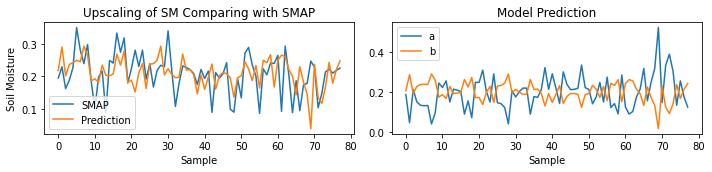

Epoch [275/5000] (LR: 0.00025):
Train loss: 0.0048 || Train physical loss: 0.0048 || Train similarity loss: 0.0000
Valid loss: 0.0037 || Valid physical loss: 0.0037 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


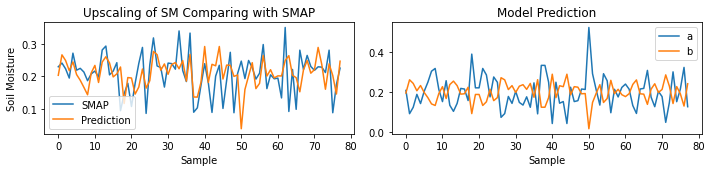

Epoch [276/5000] (LR: 0.00025):
Train loss: 0.0047 || Train physical loss: 0.0047 || Train similarity loss: 0.0000
Valid loss: 0.0037 || Valid physical loss: 0.0037 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


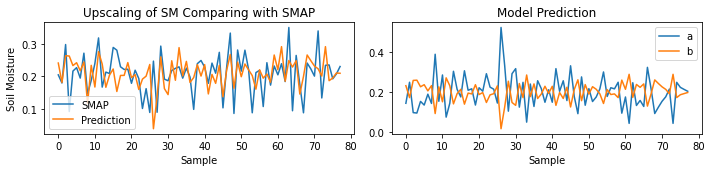

Epoch [277/5000] (LR: 0.00025):
Train loss: 0.0047 || Train physical loss: 0.0047 || Train similarity loss: 0.0000
Valid loss: 0.0037 || Valid physical loss: 0.0037 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


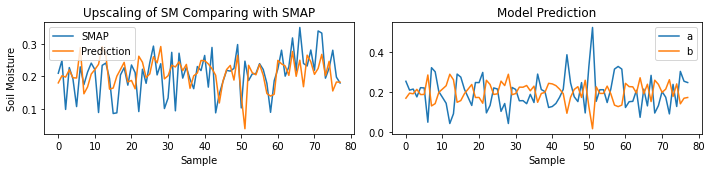

Epoch [278/5000] (LR: 0.00025):
Train loss: 0.0047 || Train physical loss: 0.0047 || Train similarity loss: 0.0000
Valid loss: 0.0037 || Valid physical loss: 0.0037 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


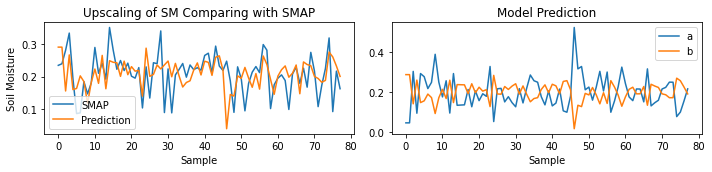

Epoch [279/5000] (LR: 0.00025):
Train loss: 0.0047 || Train physical loss: 0.0047 || Train similarity loss: 0.0000
Valid loss: 0.0037 || Valid physical loss: 0.0037 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


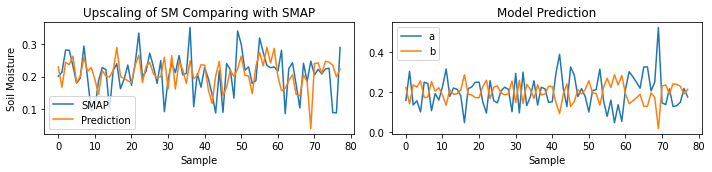

Epoch [280/5000] (LR: 0.00025):
Train loss: 0.0047 || Train physical loss: 0.0047 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


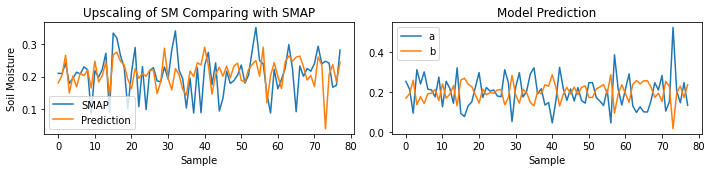

Epoch [281/5000] (LR: 0.00025):
Train loss: 0.0047 || Train physical loss: 0.0047 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


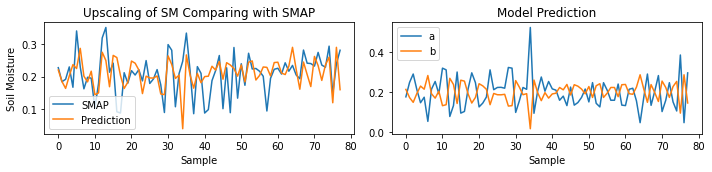

Epoch [282/5000] (LR: 0.00025):
Train loss: 0.0046 || Train physical loss: 0.0046 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


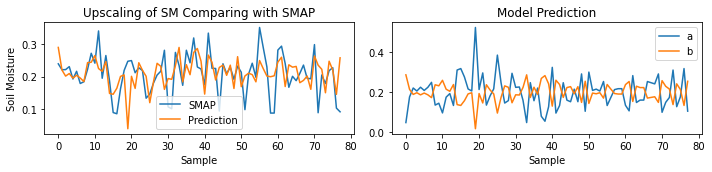

Epoch [283/5000] (LR: 0.00025):
Train loss: 0.0046 || Train physical loss: 0.0046 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


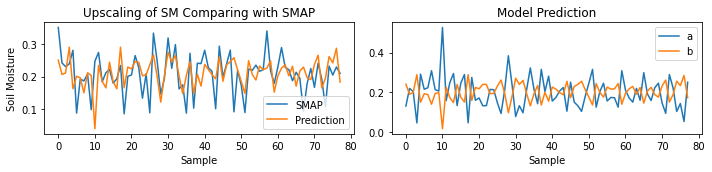

Epoch [284/5000] (LR: 0.00025):
Train loss: 0.0046 || Train physical loss: 0.0046 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000


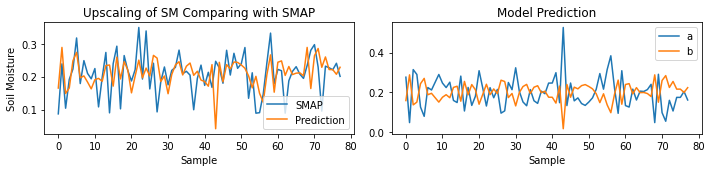

Epoch [285/5000] (LR: 0.00025):
Train loss: 0.0046 || Train physical loss: 0.0046 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


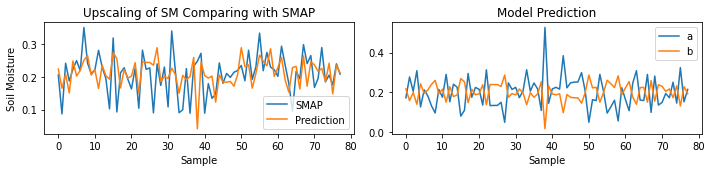

Epoch [286/5000] (LR: 0.00025):
Train loss: 0.0046 || Train physical loss: 0.0046 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


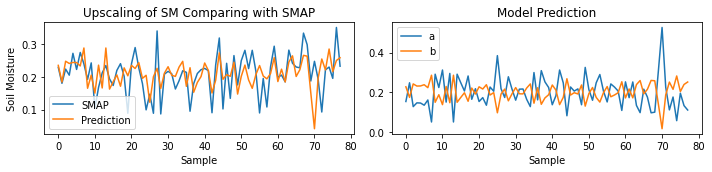

Epoch [287/5000] (LR: 0.00025):
Train loss: 0.0046 || Train physical loss: 0.0046 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


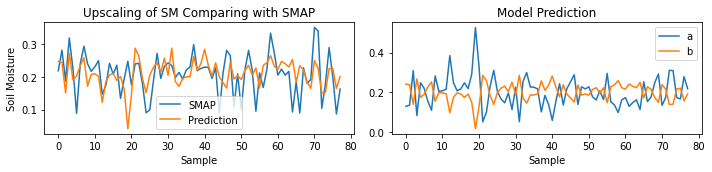

Epoch [288/5000] (LR: 0.00025):
Train loss: 0.0045 || Train physical loss: 0.0045 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


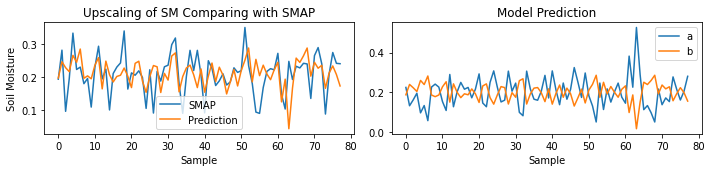

Epoch [289/5000] (LR: 0.00025):
Train loss: 0.0046 || Train physical loss: 0.0046 || Train similarity loss: 0.0000
Valid loss: 0.0036 || Valid physical loss: 0.0036 || Valid similarity loss: 0.0000


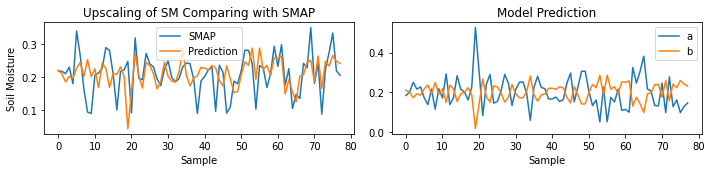

Epoch [290/5000] (LR: 0.00025):
Train loss: 0.0045 || Train physical loss: 0.0045 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


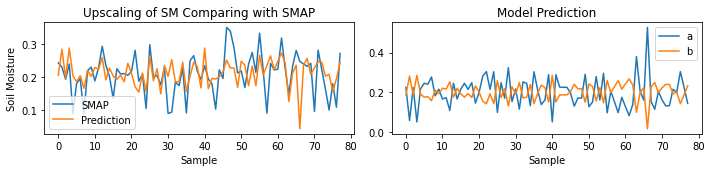

Epoch [291/5000] (LR: 0.00025):
Train loss: 0.0045 || Train physical loss: 0.0045 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


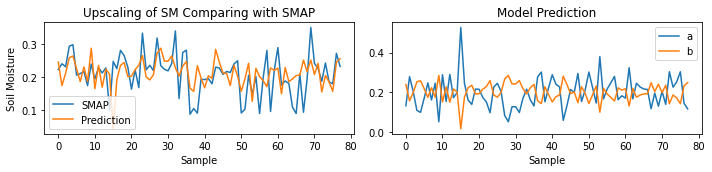

Epoch [292/5000] (LR: 0.00025):
Train loss: 0.0046 || Train physical loss: 0.0046 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


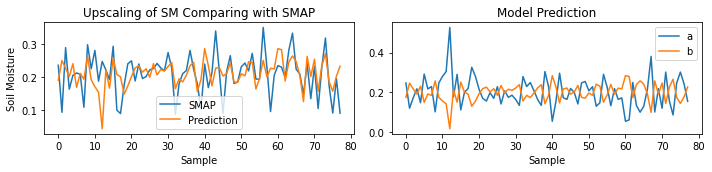

Epoch [293/5000] (LR: 0.00025):
Train loss: 0.0045 || Train physical loss: 0.0045 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.004...


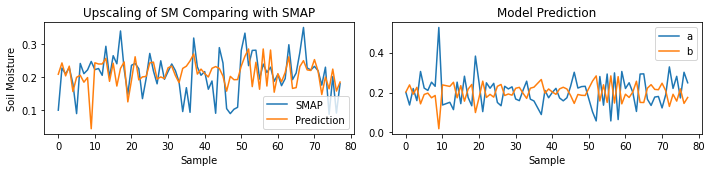

Epoch [294/5000] (LR: 0.00025):
Train loss: 0.0045 || Train physical loss: 0.0045 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


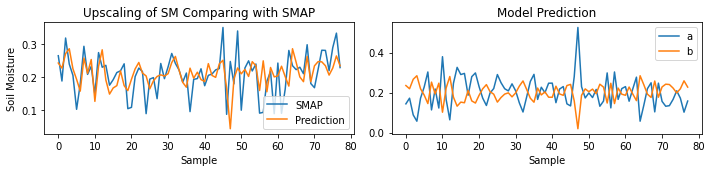

Epoch [295/5000] (LR: 0.00025):
Train loss: 0.0045 || Train physical loss: 0.0045 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000


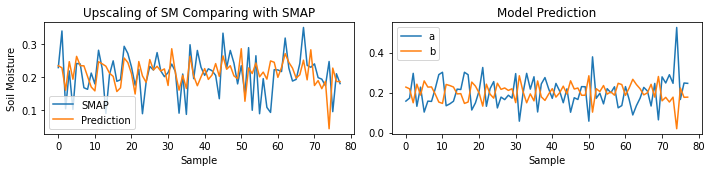

Epoch [296/5000] (LR: 0.00025):
Train loss: 0.0045 || Train physical loss: 0.0045 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000


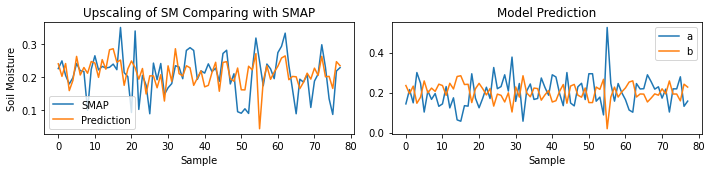

Epoch [297/5000] (LR: 0.00025):
Train loss: 0.0045 || Train physical loss: 0.0045 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


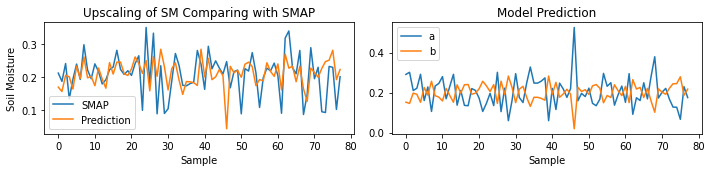

Epoch [298/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


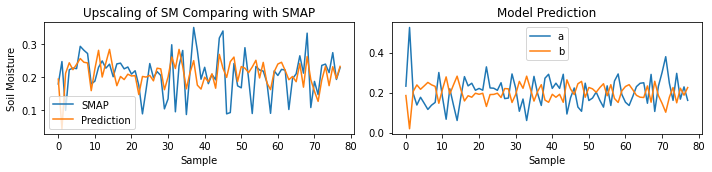

Epoch [299/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


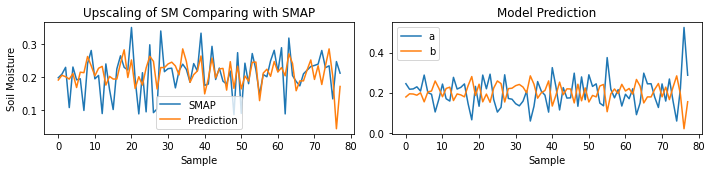

Epoch [300/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000


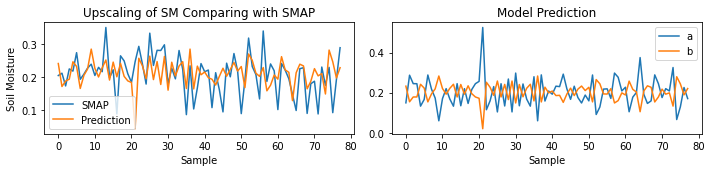

Epoch [301/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000


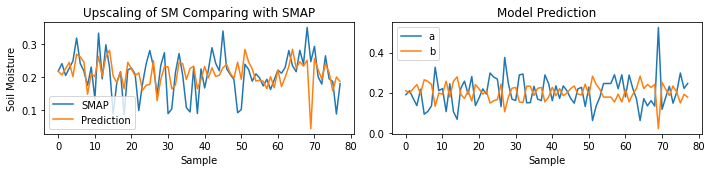

Epoch [302/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0035 || Valid physical loss: 0.0035 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


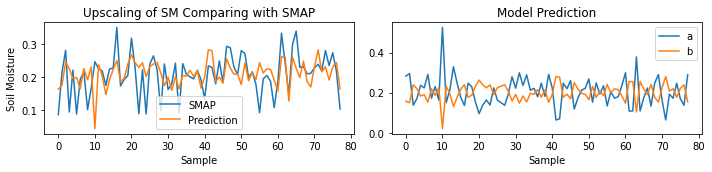

Epoch [303/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


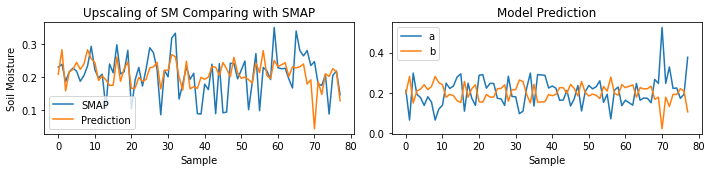

Epoch [304/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


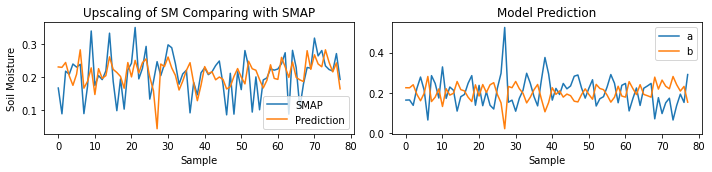

Epoch [305/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


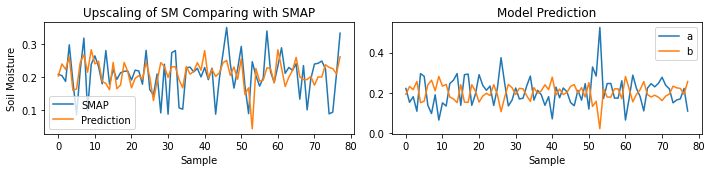

Epoch [306/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


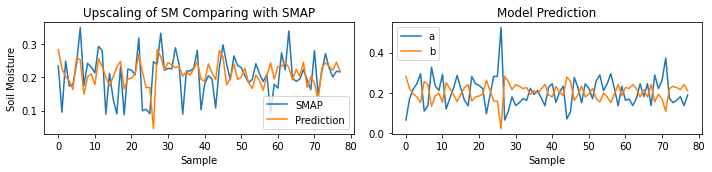

Epoch [307/5000] (LR: 0.00025):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


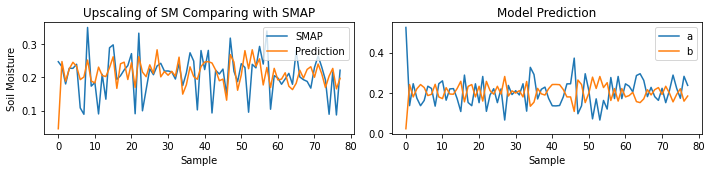

Epoch [308/5000] (LR: 0.000125):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


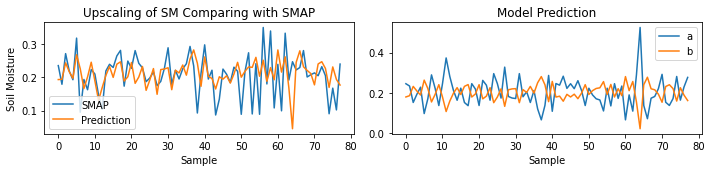

Epoch [309/5000] (LR: 0.000125):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


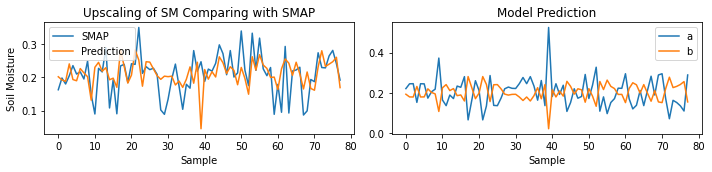

Epoch [310/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


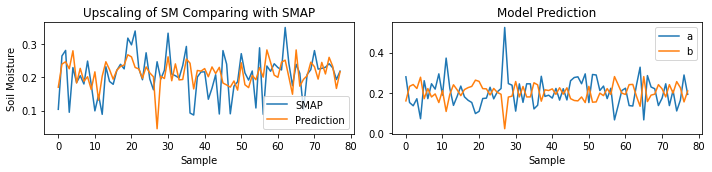

Epoch [311/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


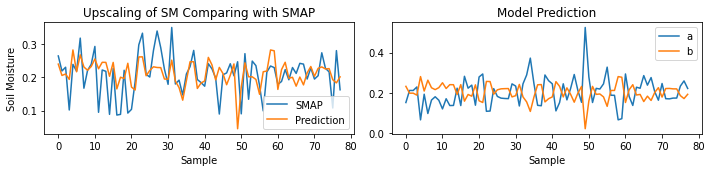

Epoch [312/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


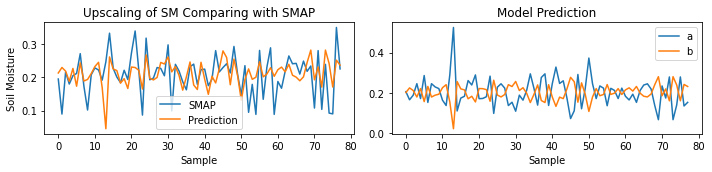

Epoch [313/5000] (LR: 0.000125):
Train loss: 0.0044 || Train physical loss: 0.0044 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


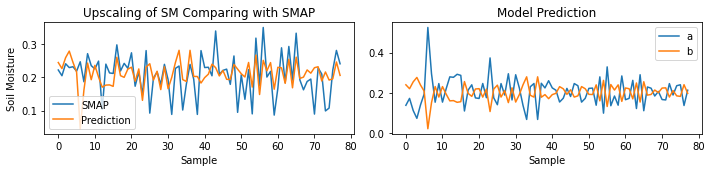

Epoch [314/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


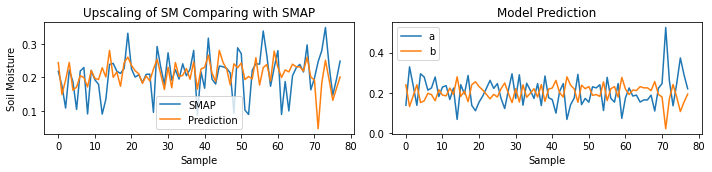

Epoch [315/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


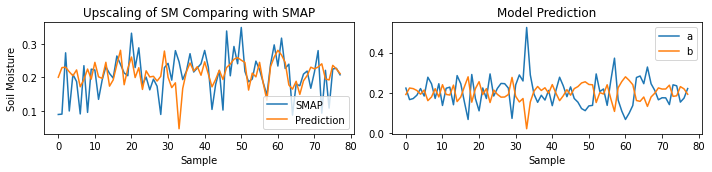

Epoch [316/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


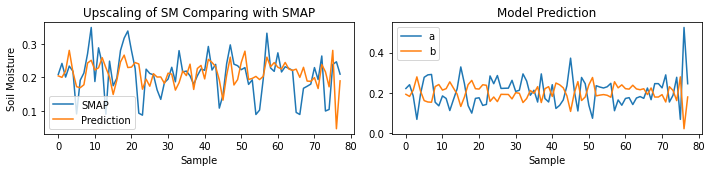

Epoch [317/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


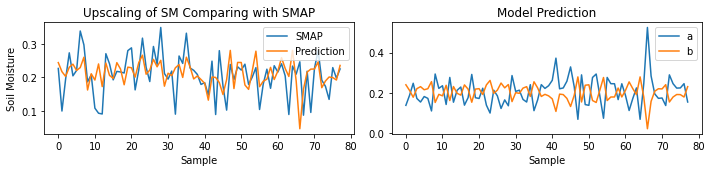

Epoch [318/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


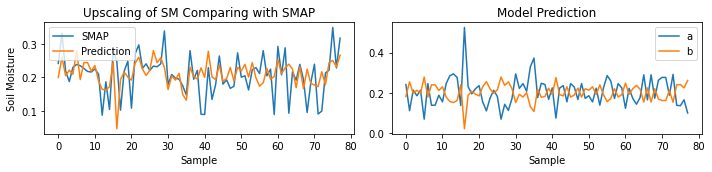

Epoch [319/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


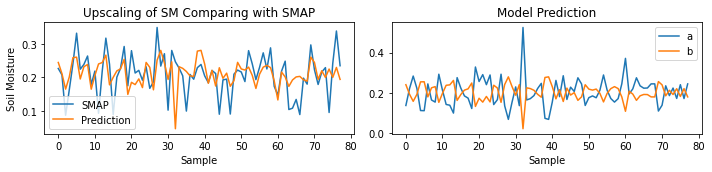

Epoch [320/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


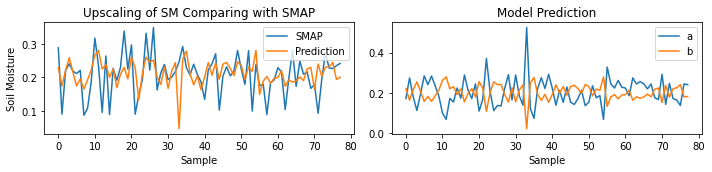

Epoch [321/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


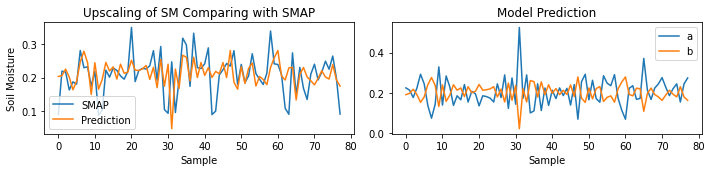

Epoch [322/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


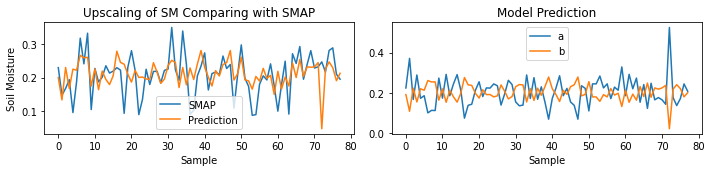

Epoch [323/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


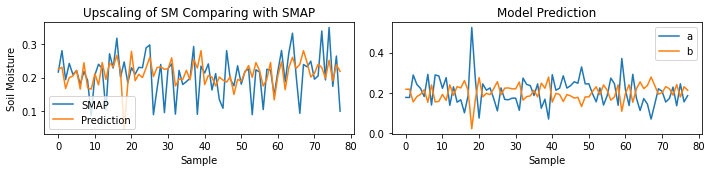

Epoch [324/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


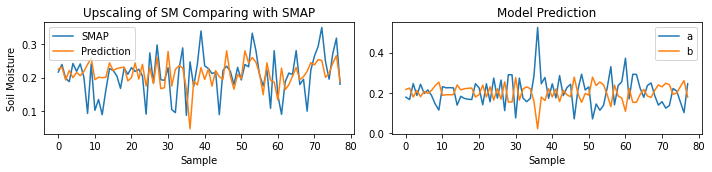

Epoch [325/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


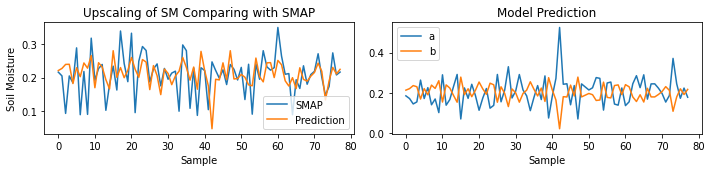

Epoch [326/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


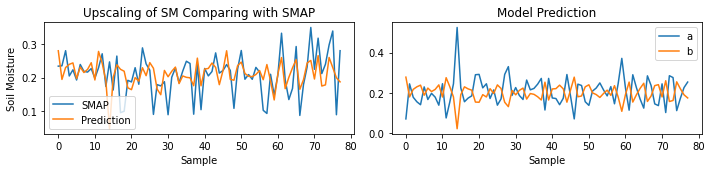

Epoch [327/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


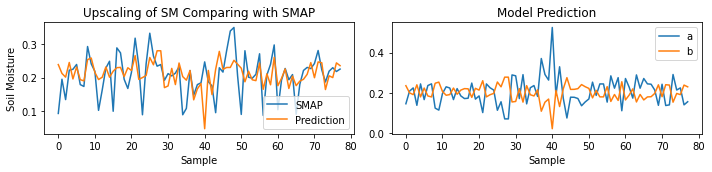

Epoch [328/5000] (LR: 0.000125):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


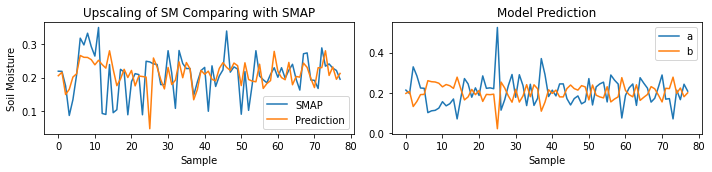

Epoch [329/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


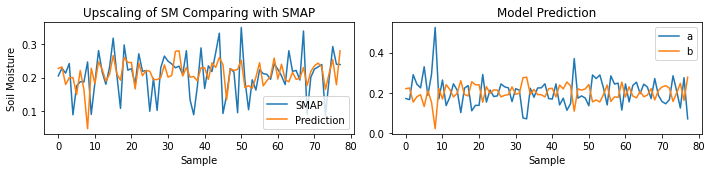

Epoch [330/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


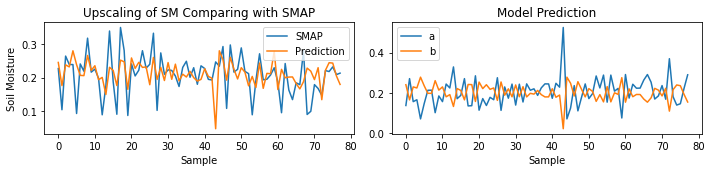

Epoch [331/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


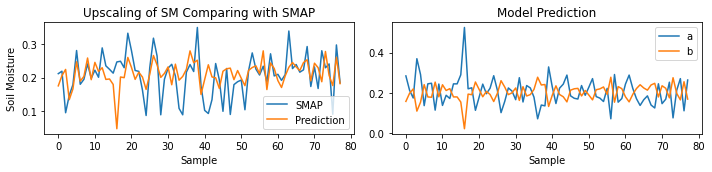

Epoch [332/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


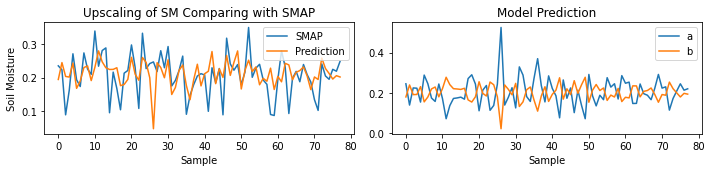

Epoch [333/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


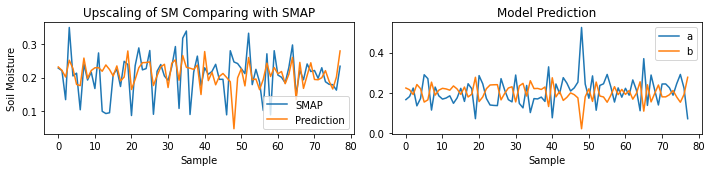

Epoch [334/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


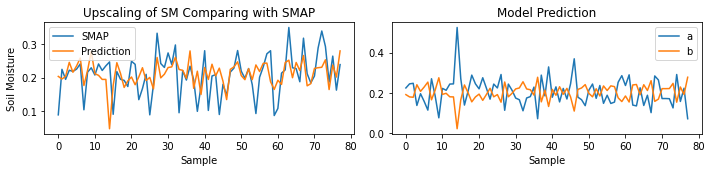

Epoch [335/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


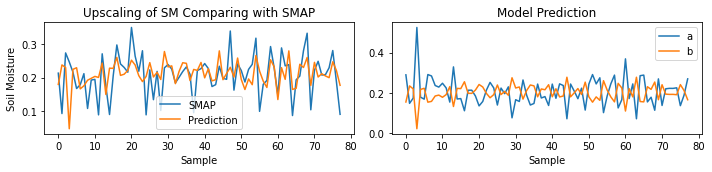

Epoch [336/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


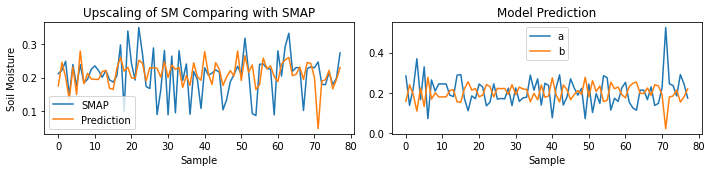

Epoch [337/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


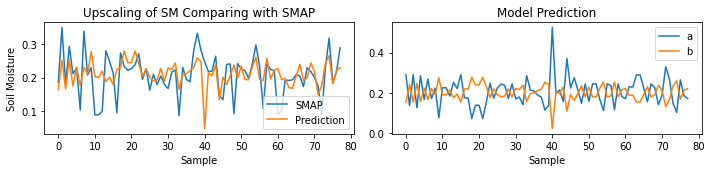

Epoch [338/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


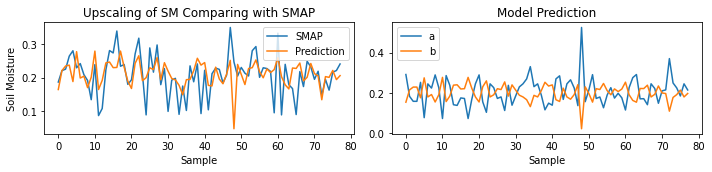

Epoch [339/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


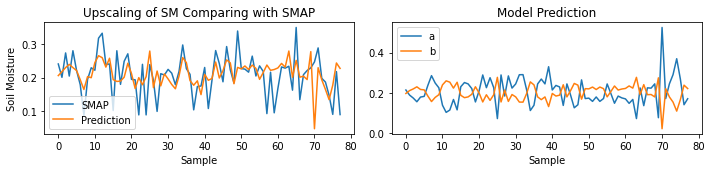

Epoch [340/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


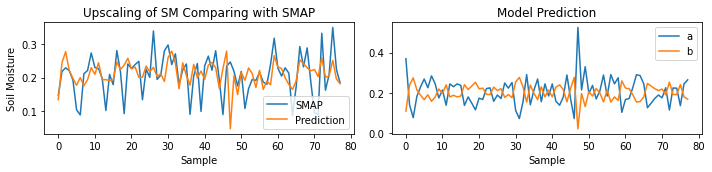

Epoch [341/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


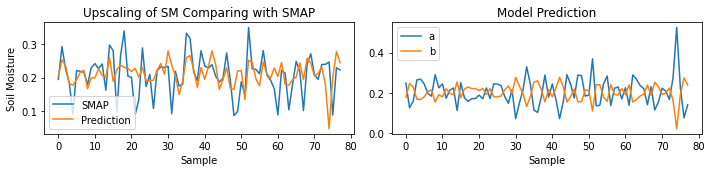

Epoch [342/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


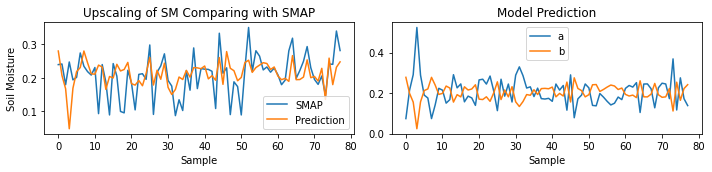

Epoch [343/5000] (LR: 6.25e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


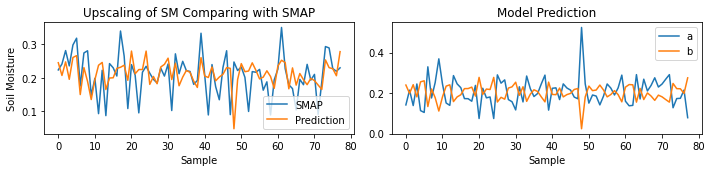

Epoch [344/5000] (LR: 6.25e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


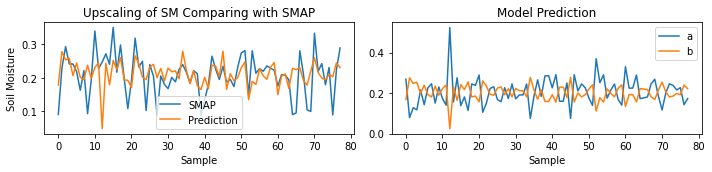

Epoch [345/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


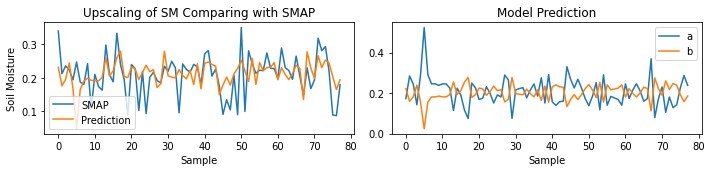

Epoch [346/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


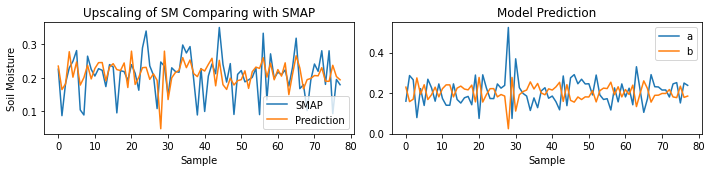

Epoch [347/5000] (LR: 3.125e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


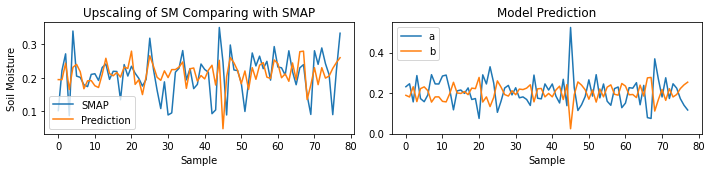

Epoch [348/5000] (LR: 3.125e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


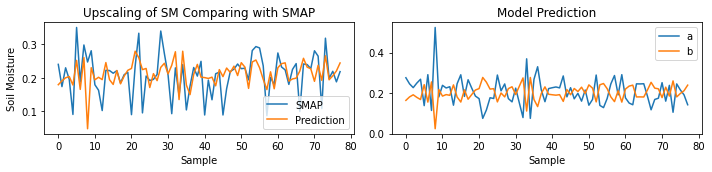

Epoch [349/5000] (LR: 3.125e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


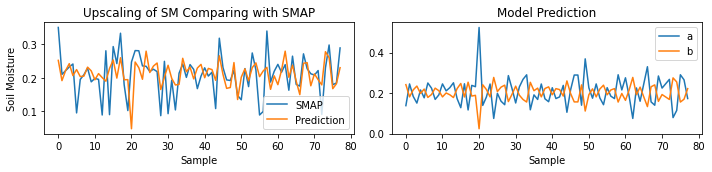

Epoch [350/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


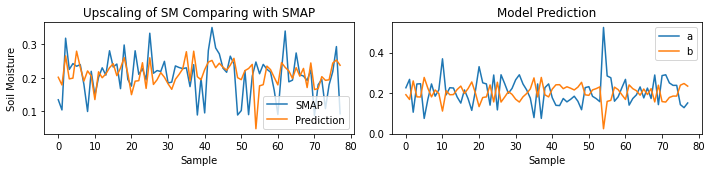

Epoch [351/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


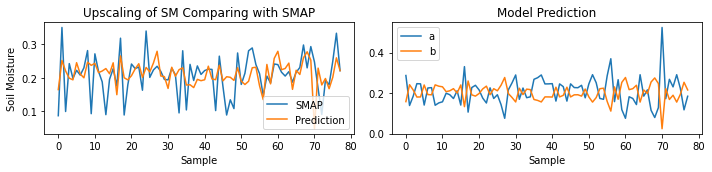

Epoch [352/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


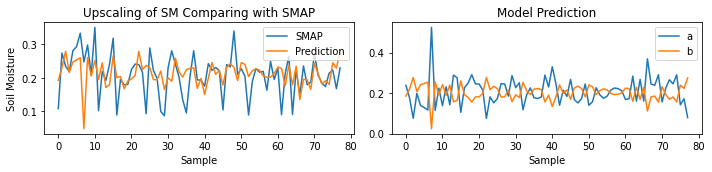

Epoch [353/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


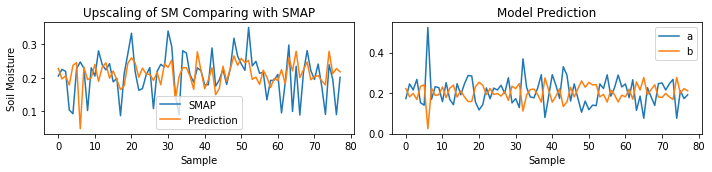

Epoch [354/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


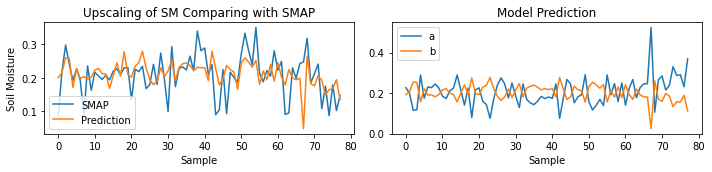

Epoch [355/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


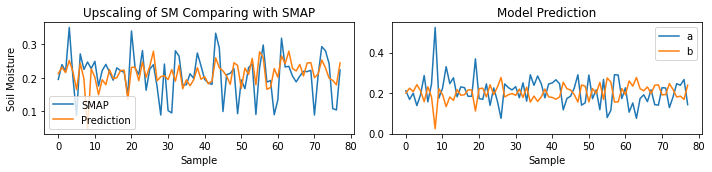

Epoch [356/5000] (LR: 3.125e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


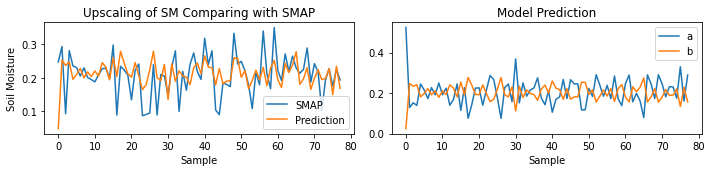

Epoch [357/5000] (LR: 3.125e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


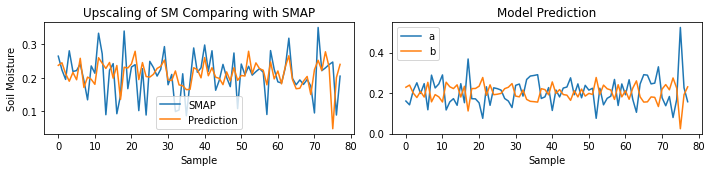

Epoch [358/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


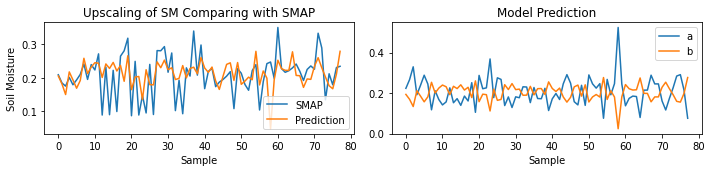

Epoch [359/5000] (LR: 3.125e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


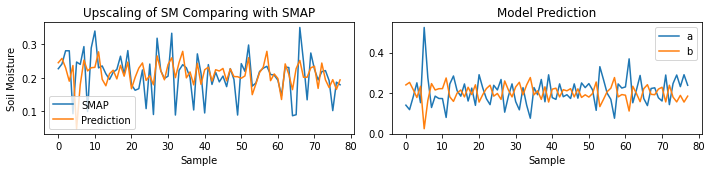

Epoch [360/5000] (LR: 3.125e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


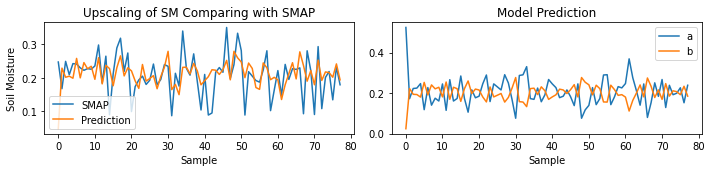

Epoch [361/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


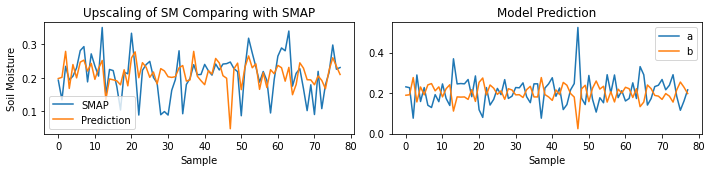

Epoch [362/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


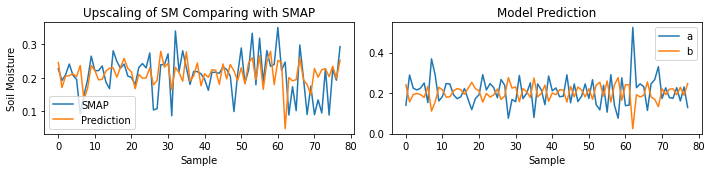

Epoch [363/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


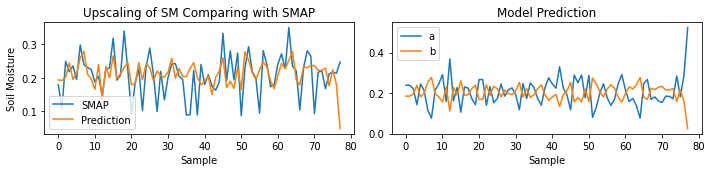

Epoch [364/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


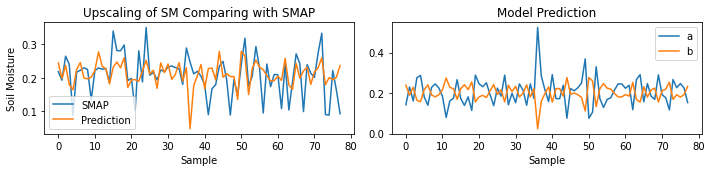

Epoch [365/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


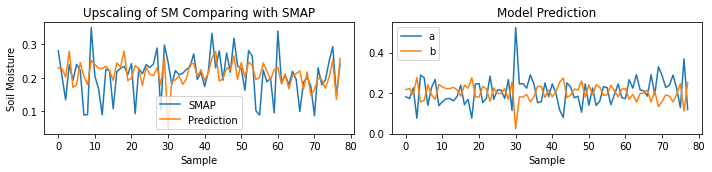

Epoch [366/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


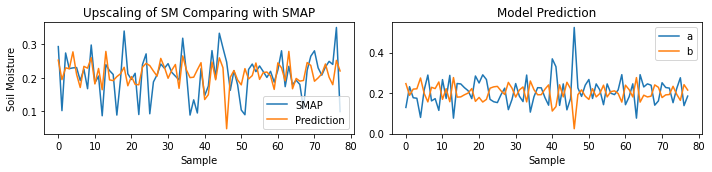

Epoch [367/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


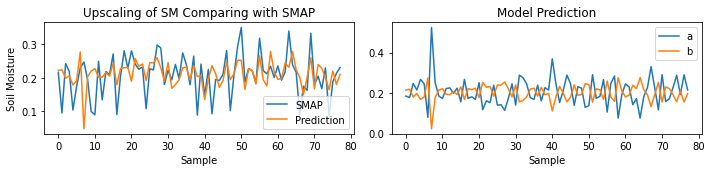

Epoch [368/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


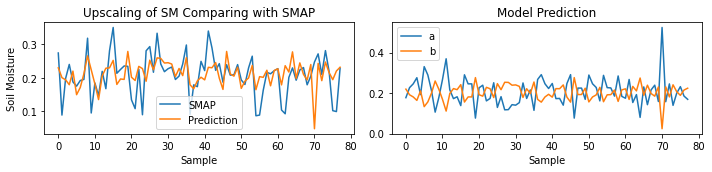

Epoch [369/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


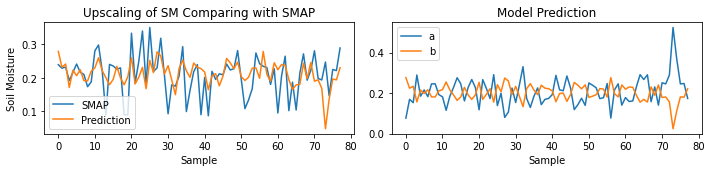

Epoch [370/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


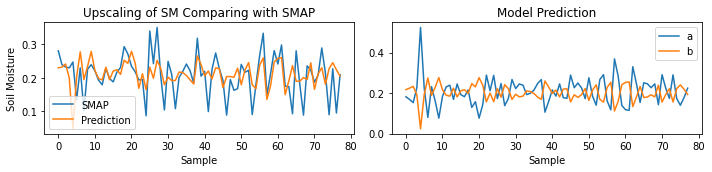

Epoch [371/5000] (LR: 1.5625e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


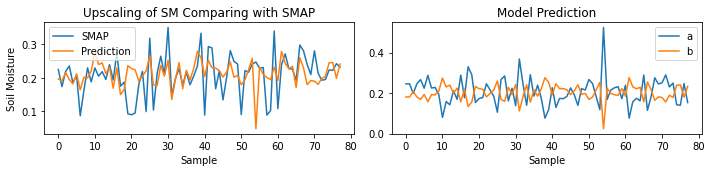

Epoch [372/5000] (LR: 1.5625e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


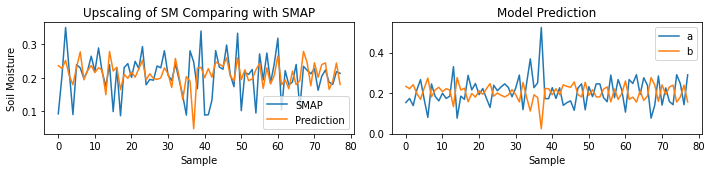

Epoch [373/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


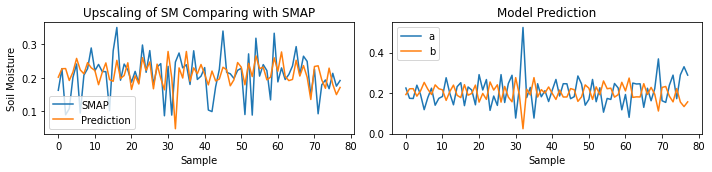

Epoch [374/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


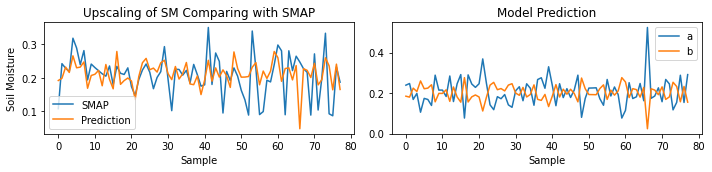

Epoch [375/5000] (LR: 1.5625e-05):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


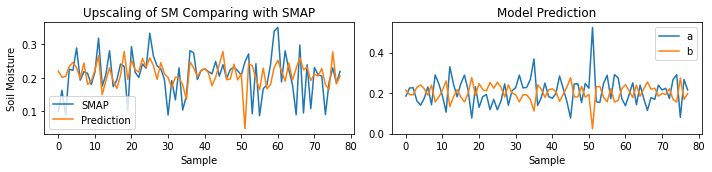

Epoch [376/5000] (LR: 1.5625e-05):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


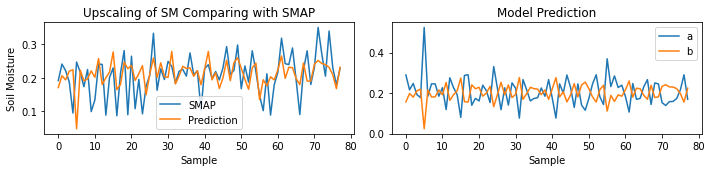

Epoch [377/5000] (LR: 7.8125e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


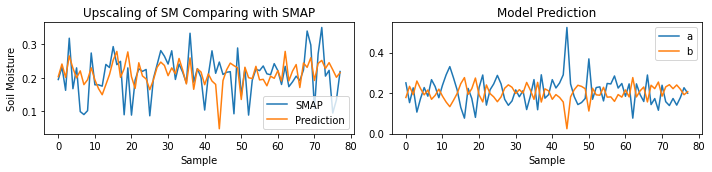

Epoch [378/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


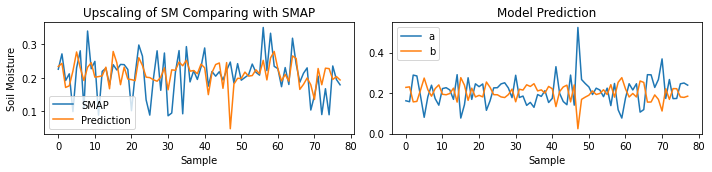

Epoch [379/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


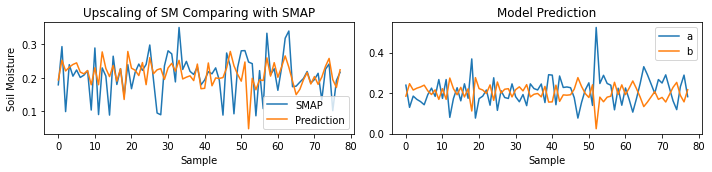

Epoch [380/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


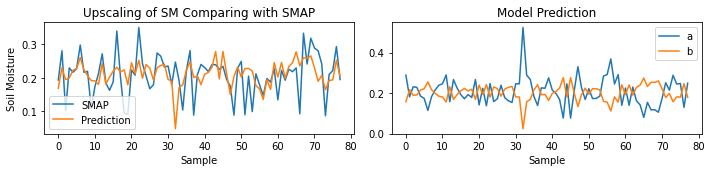

Epoch [381/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


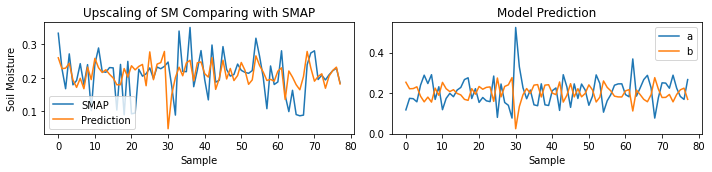

Epoch [382/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


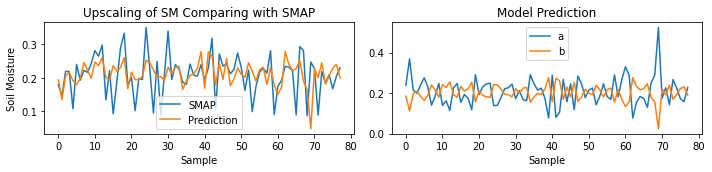

Epoch [383/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


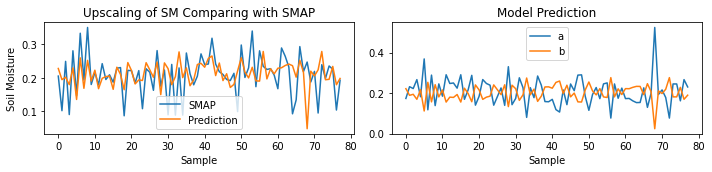

Epoch [384/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


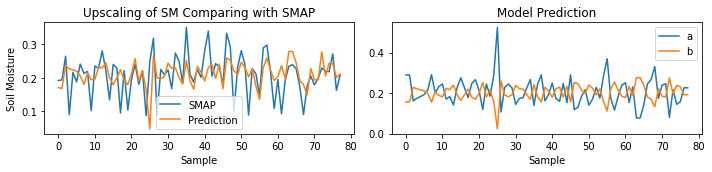

Epoch [385/5000] (LR: 7.8125e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


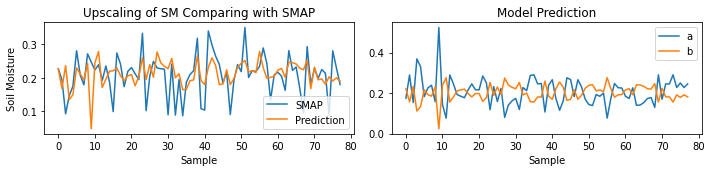

Epoch [386/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


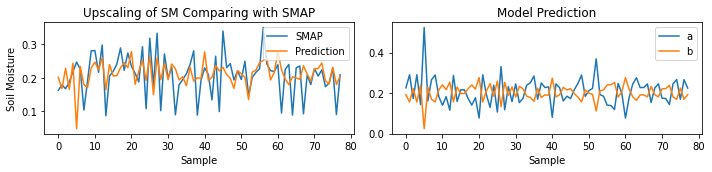

Epoch [387/5000] (LR: 7.8125e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


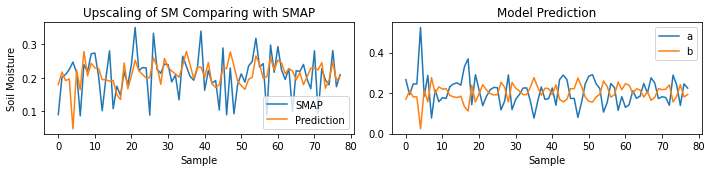

Epoch [388/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


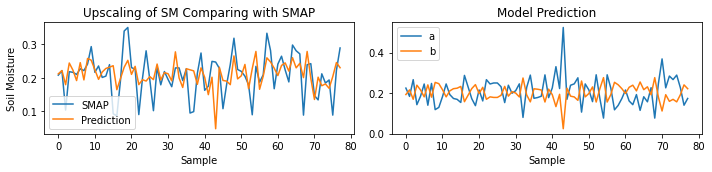

Epoch [389/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


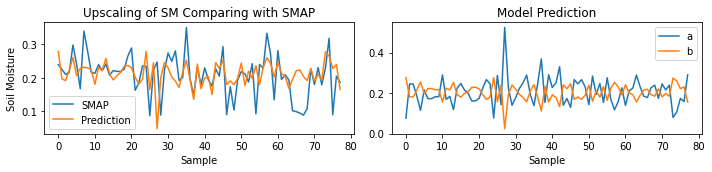

Epoch [390/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


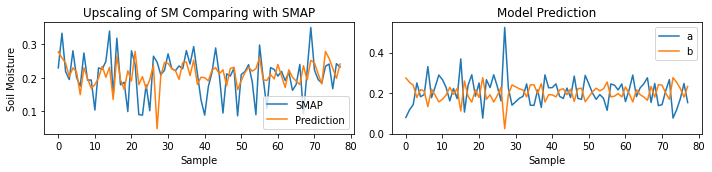

Epoch [391/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


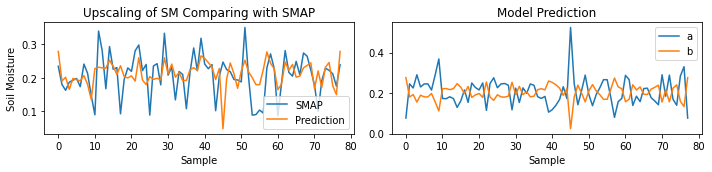

Epoch [392/5000] (LR: 7.8125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


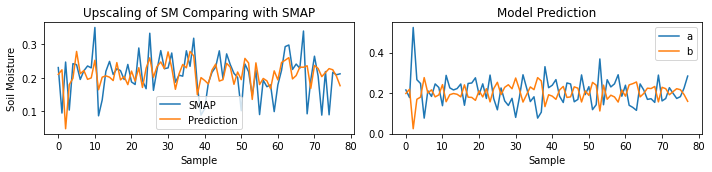

Epoch [393/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


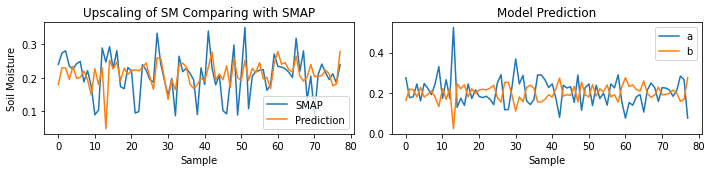

Epoch [394/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


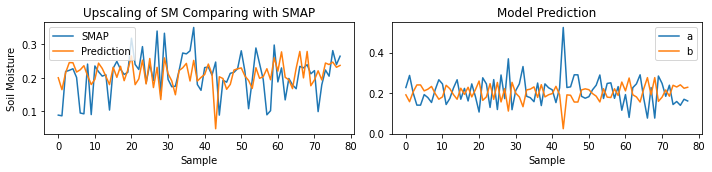

Epoch [395/5000] (LR: 3.90625e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


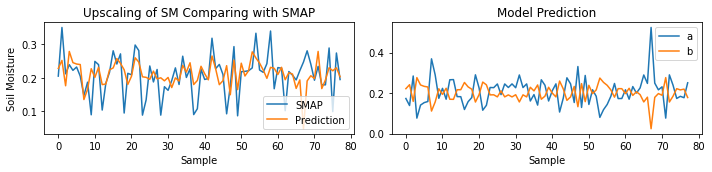

Epoch [396/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


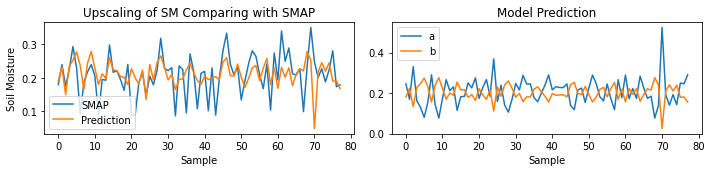

Epoch [397/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


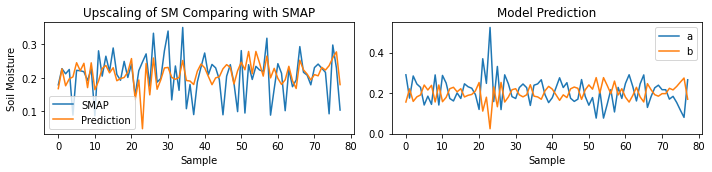

Epoch [398/5000] (LR: 3.90625e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


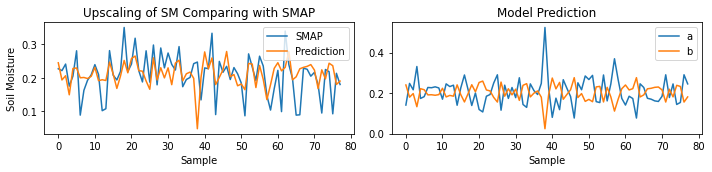

Epoch [399/5000] (LR: 3.90625e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


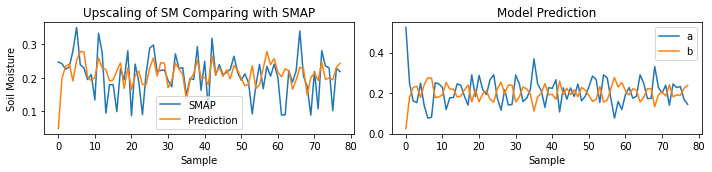

Epoch [400/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


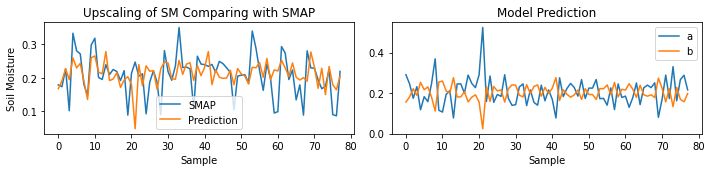

Epoch [401/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


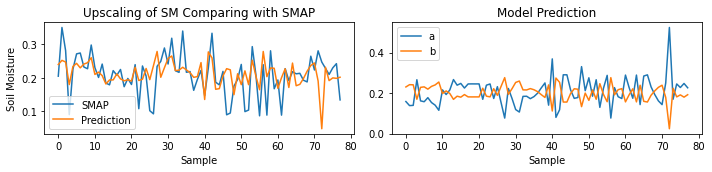

Epoch [402/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


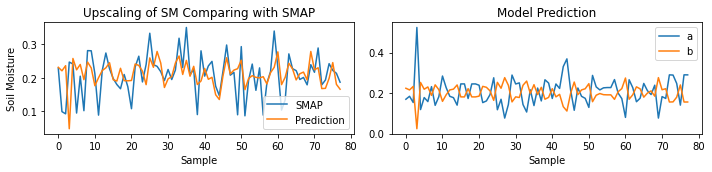

Epoch [403/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


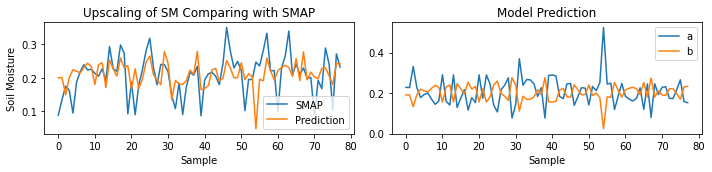

Epoch [404/5000] (LR: 3.90625e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


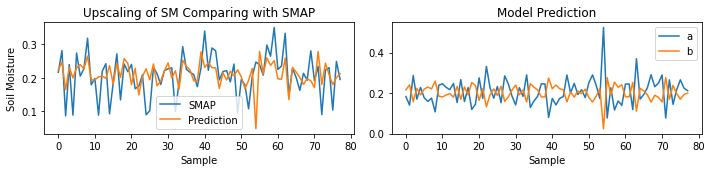

Epoch [405/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


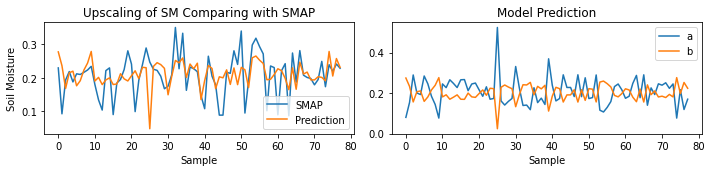

Epoch [406/5000] (LR: 3.90625e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


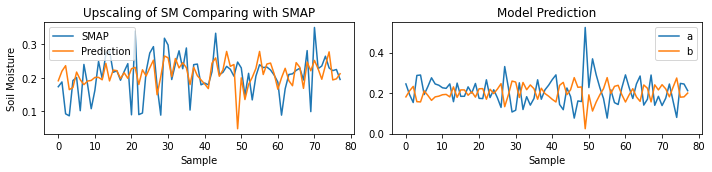

Epoch [407/5000] (LR: 3.90625e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


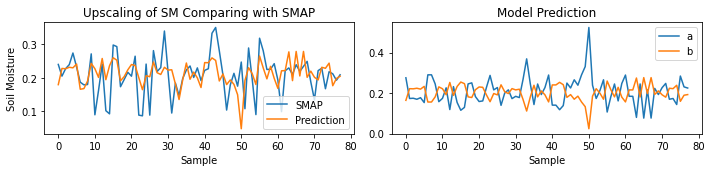

Epoch [408/5000] (LR: 3.90625e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


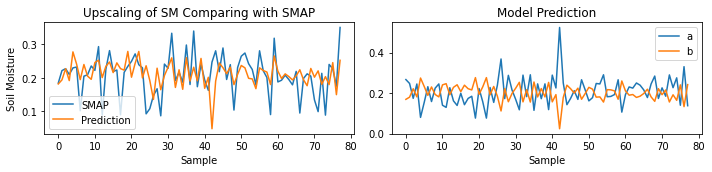

Epoch [409/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


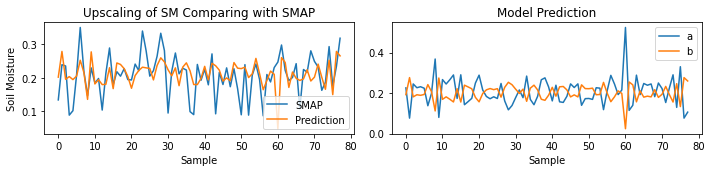

Epoch [410/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


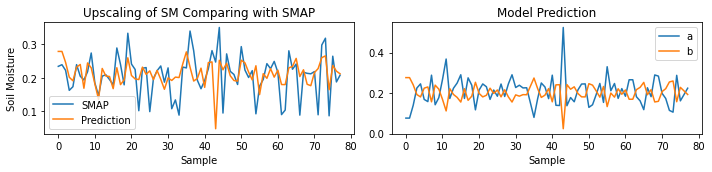

Epoch [411/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


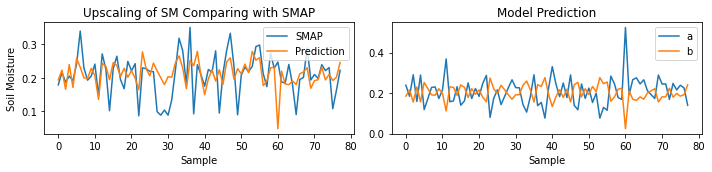

Epoch [412/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


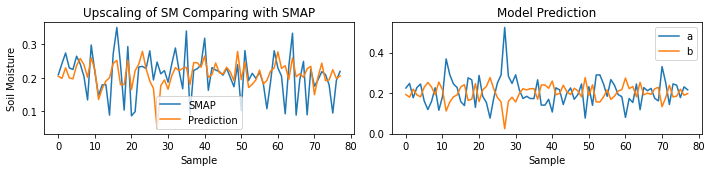

Epoch [413/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


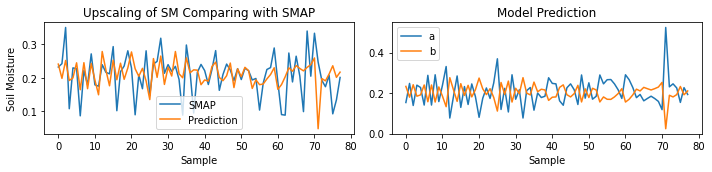

Epoch [414/5000] (LR: 1.953125e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


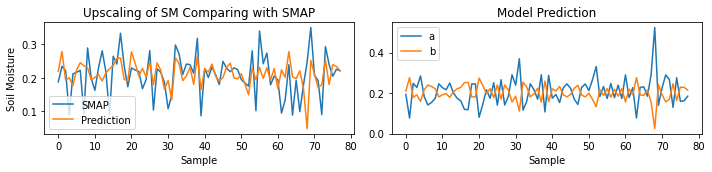

Epoch [415/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


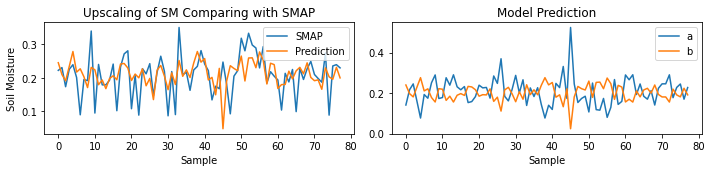

Epoch [416/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


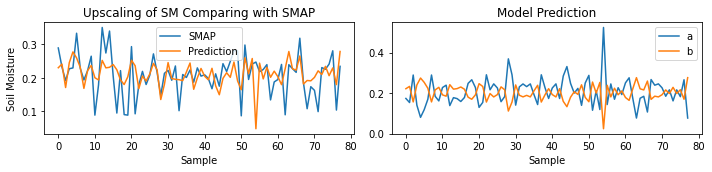

Epoch [417/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


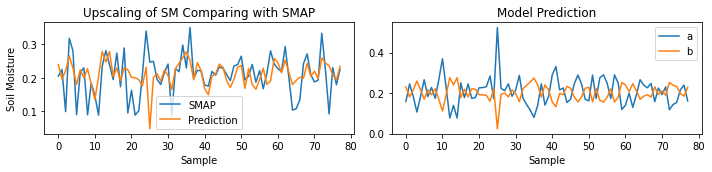

Epoch [418/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


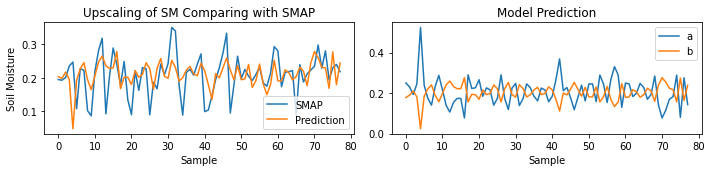

Epoch [419/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


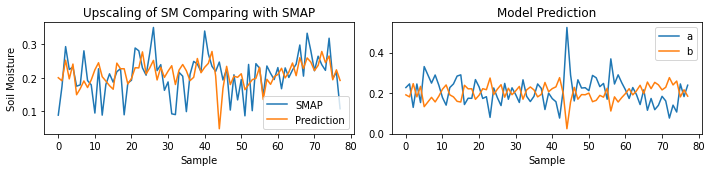

Epoch [420/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


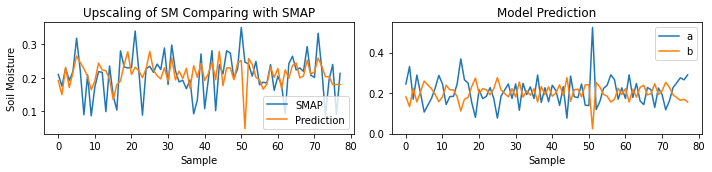

Epoch [421/5000] (LR: 1.953125e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


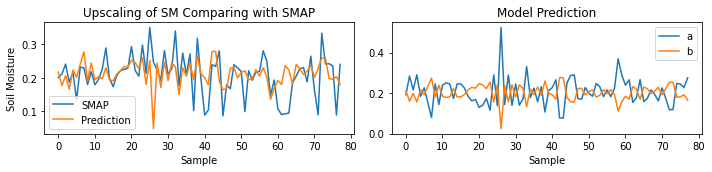

Epoch [422/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


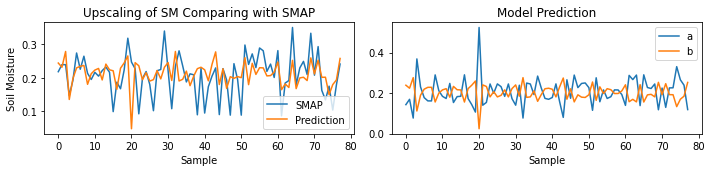

Epoch [423/5000] (LR: 1.953125e-06):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


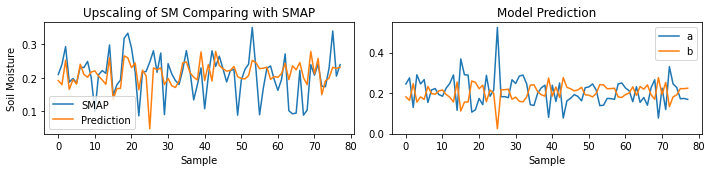

Epoch [424/5000] (LR: 1.953125e-06):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


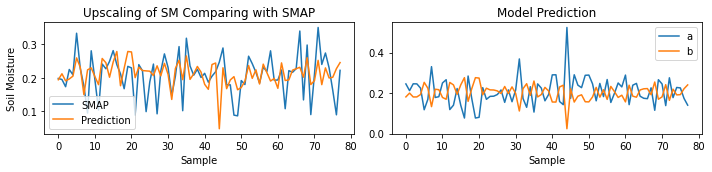

Epoch [425/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


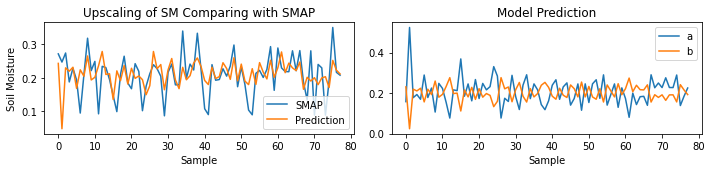

Epoch [426/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


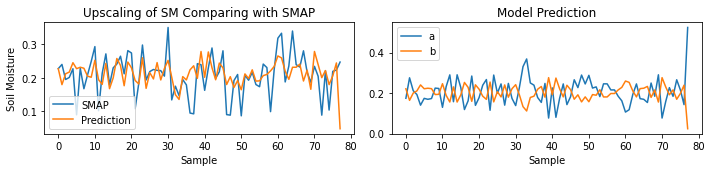

Epoch [427/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


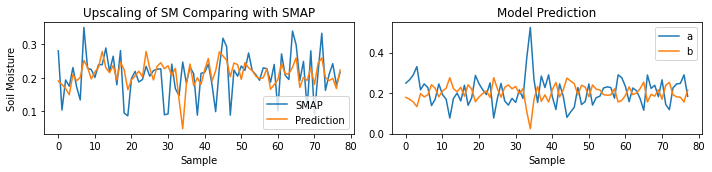

Epoch [428/5000] (LR: 9.765625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


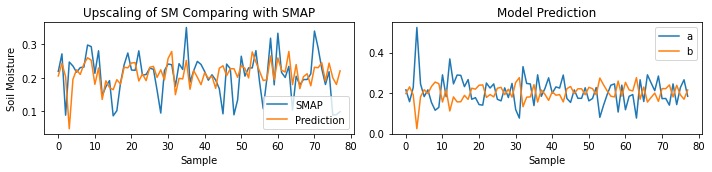

Epoch [429/5000] (LR: 9.765625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


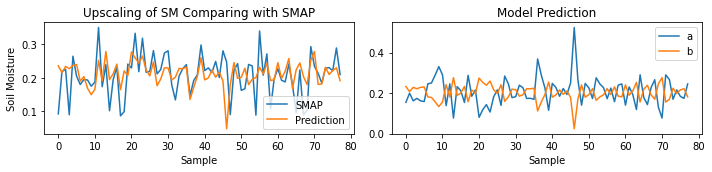

Epoch [430/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


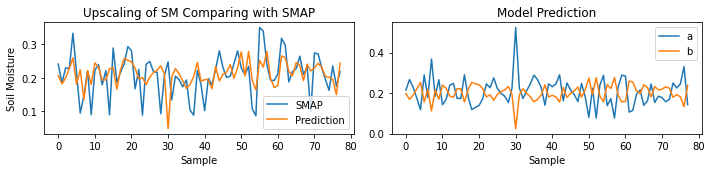

Epoch [431/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


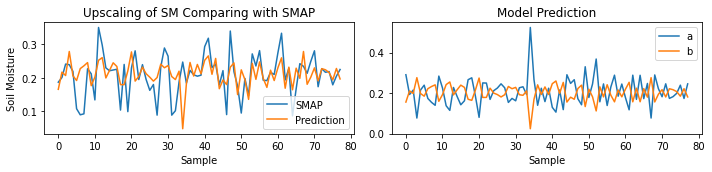

Epoch [432/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


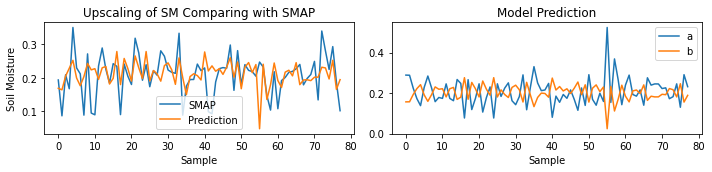

Epoch [433/5000] (LR: 9.765625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


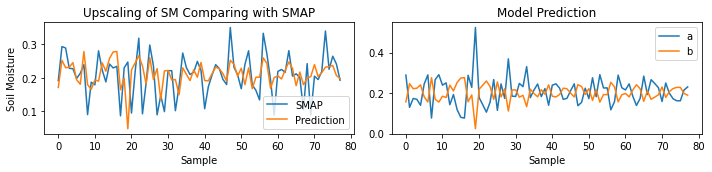

Epoch [434/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


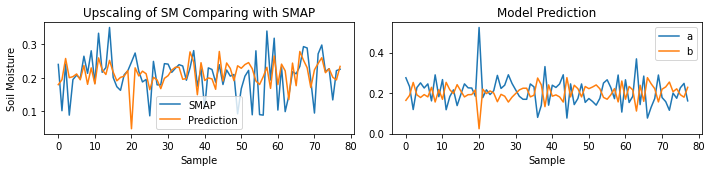

Epoch [435/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


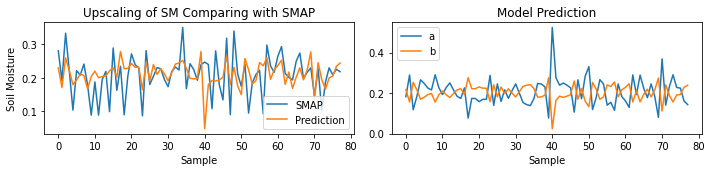

Epoch [436/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


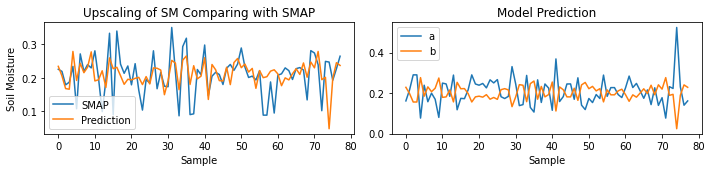

Epoch [437/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


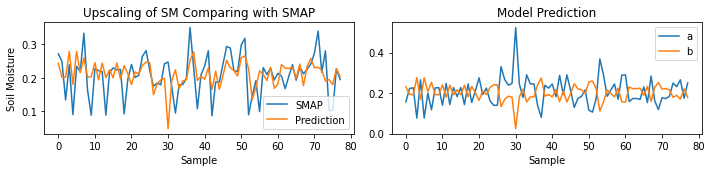

Epoch [438/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


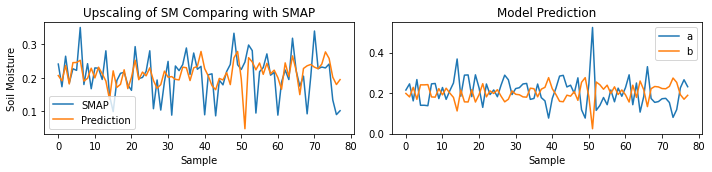

Epoch [439/5000] (LR: 9.765625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


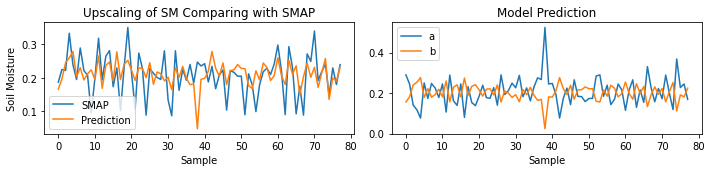

Epoch [440/5000] (LR: 9.765625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


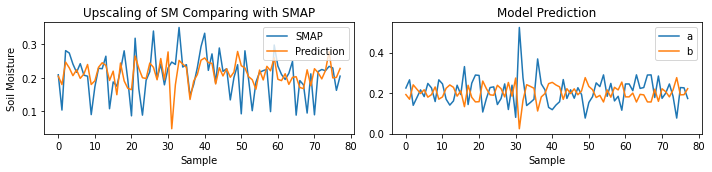

Epoch [441/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


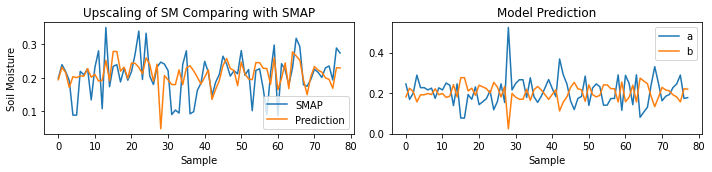

Epoch [442/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


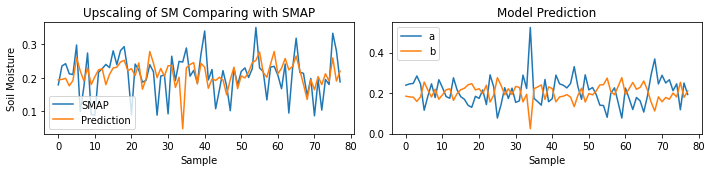

Epoch [443/5000] (LR: 4.8828125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


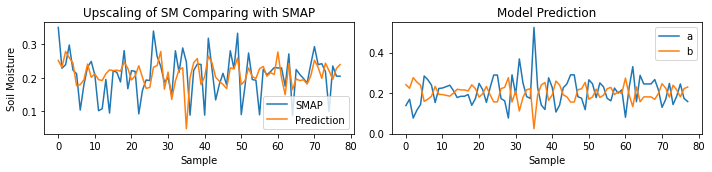

Epoch [444/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


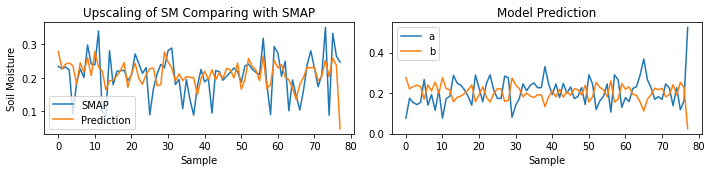

Epoch [445/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


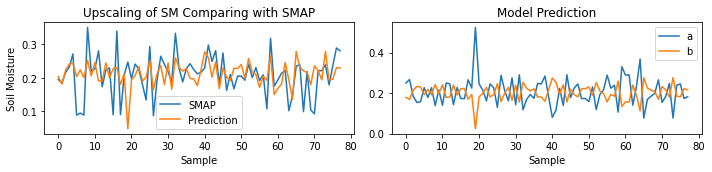

Epoch [446/5000] (LR: 4.8828125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


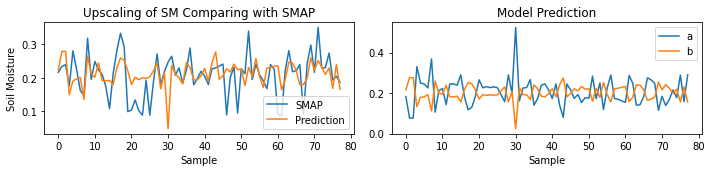

Epoch [447/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


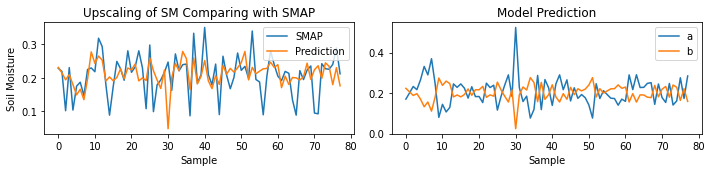

Epoch [448/5000] (LR: 4.8828125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


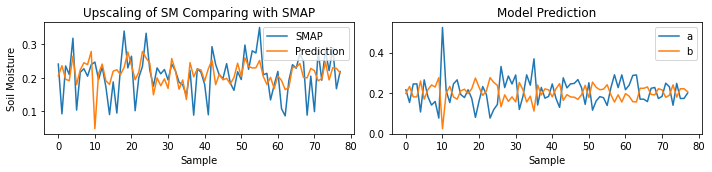

Epoch [449/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


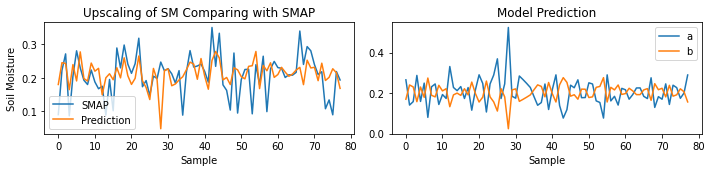

Epoch [450/5000] (LR: 4.8828125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


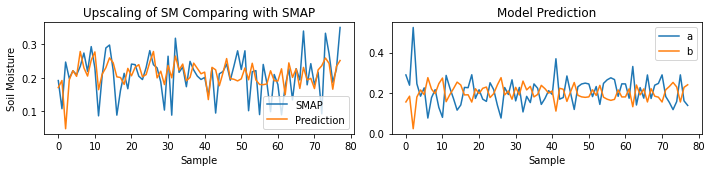

Epoch [451/5000] (LR: 4.8828125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


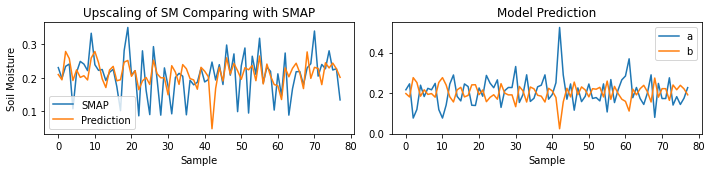

Epoch [452/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


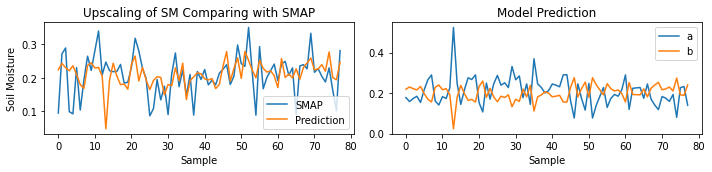

Epoch [453/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


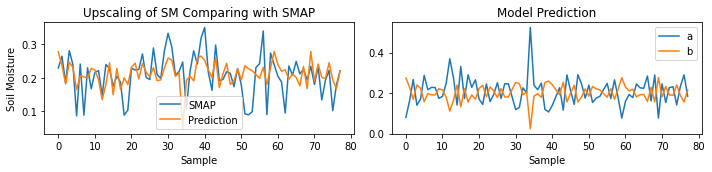

Epoch [454/5000] (LR: 4.8828125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


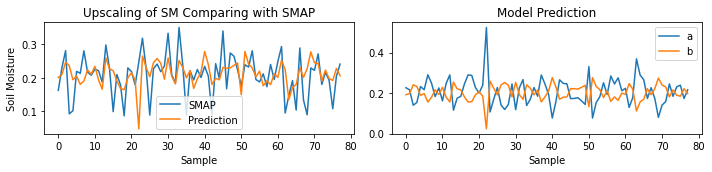

Epoch [455/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


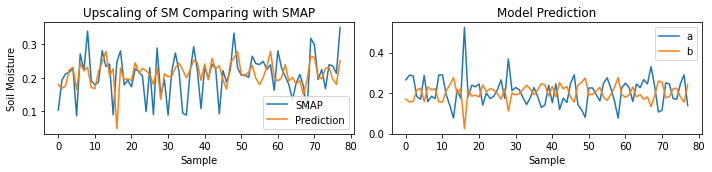

Epoch [456/5000] (LR: 4.8828125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


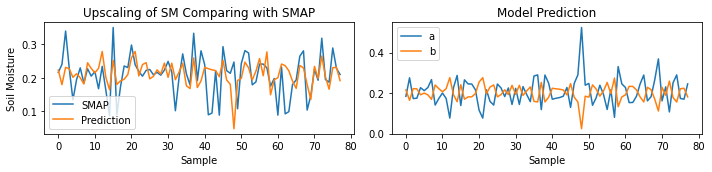

Epoch [457/5000] (LR: 2.44140625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


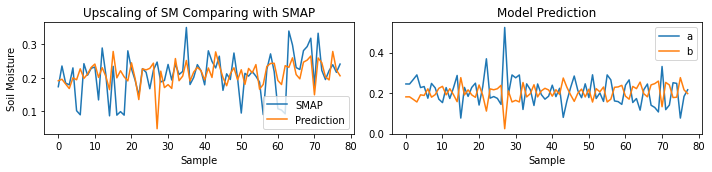

Epoch [458/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


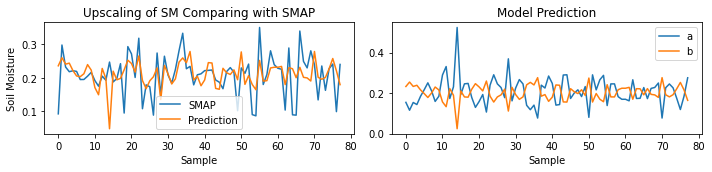

Epoch [459/5000] (LR: 2.44140625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


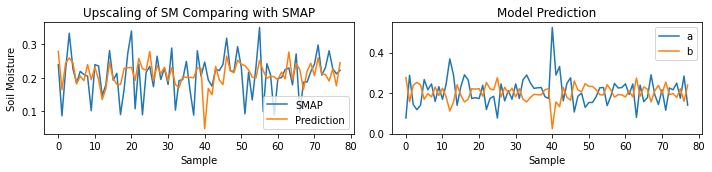

Epoch [460/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


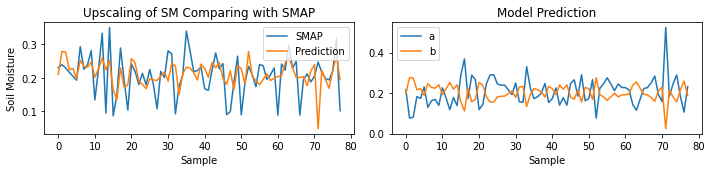

Epoch [461/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


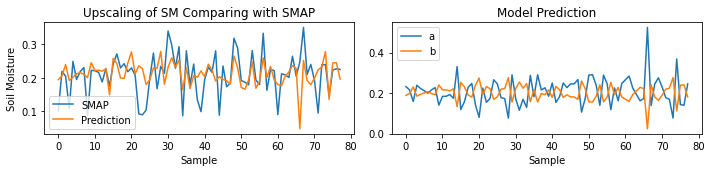

Epoch [462/5000] (LR: 2.44140625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


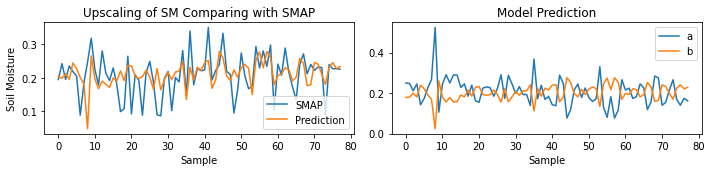

Epoch [463/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


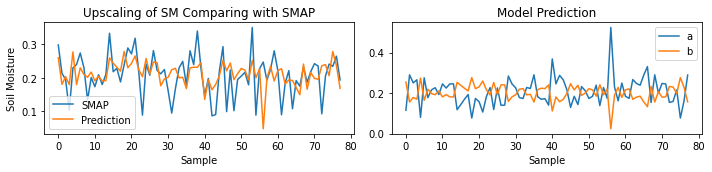

Epoch [464/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


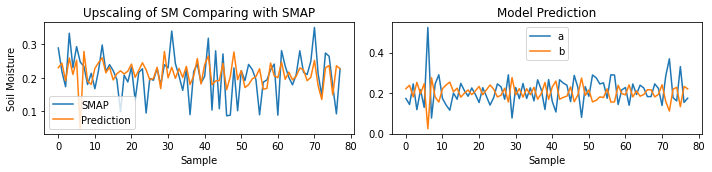

Epoch [465/5000] (LR: 2.44140625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


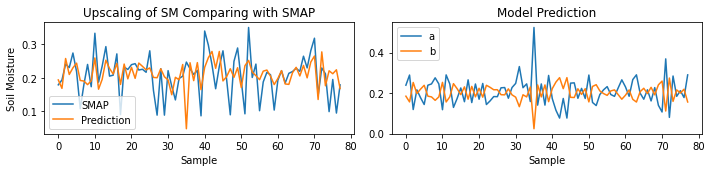

Epoch [466/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


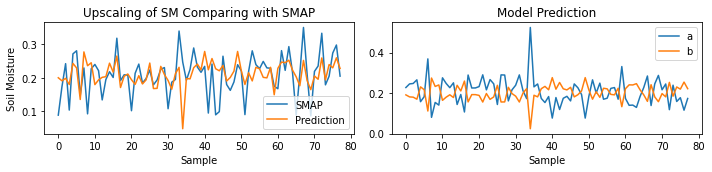

Epoch [467/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


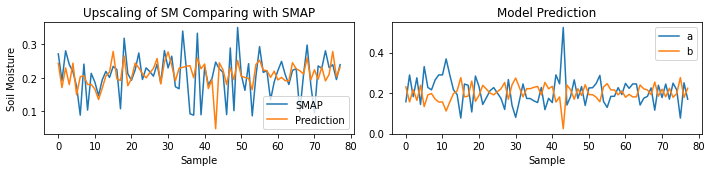

Epoch [468/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


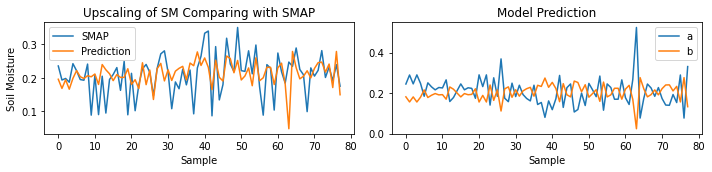

Epoch [469/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


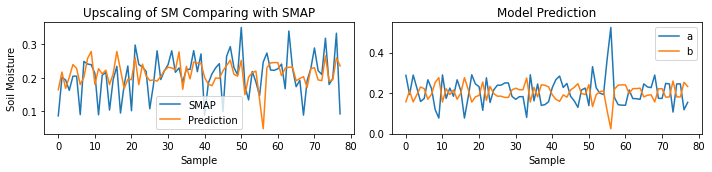

Epoch [470/5000] (LR: 2.44140625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


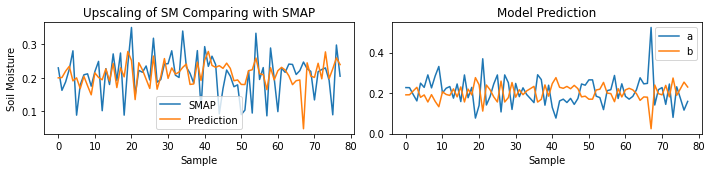

Epoch [471/5000] (LR: 2.44140625e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


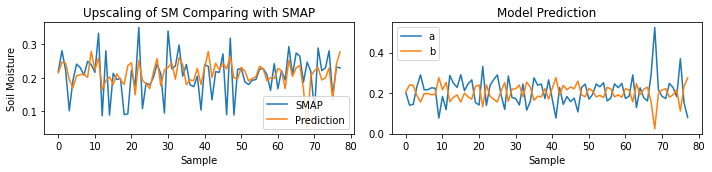

Epoch [472/5000] (LR: 2.44140625e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


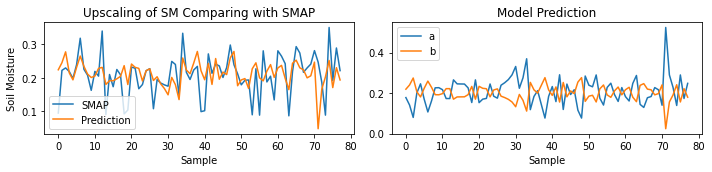

Epoch [473/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


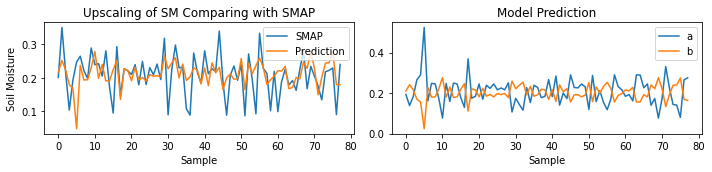

Epoch [474/5000] (LR: 1.220703125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


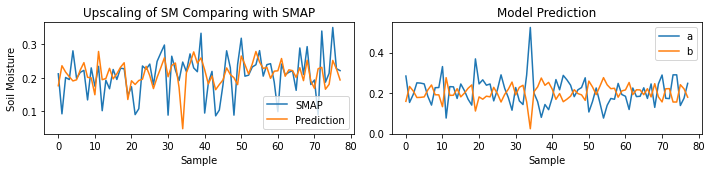

Epoch [475/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


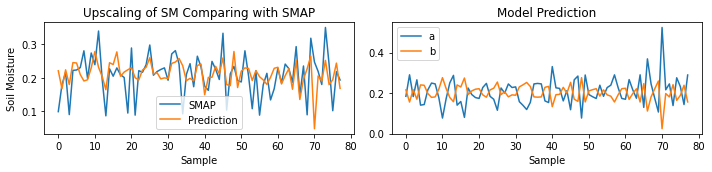

Epoch [476/5000] (LR: 1.220703125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


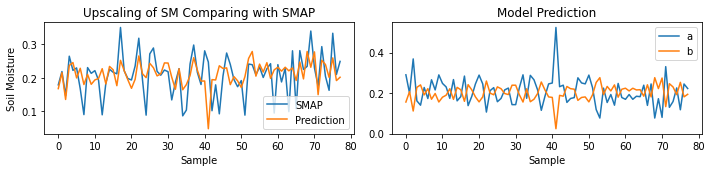

Epoch [477/5000] (LR: 1.220703125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


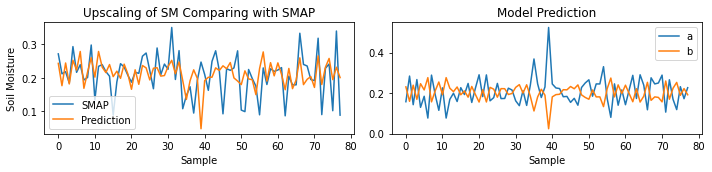

Epoch [478/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


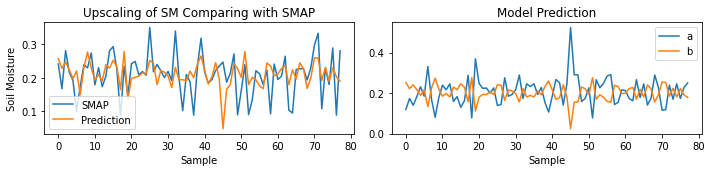

Epoch [479/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000
Saving model with loss 0.003...


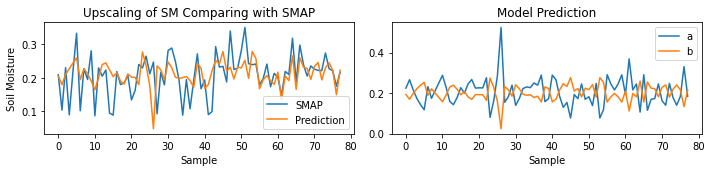

Epoch [480/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


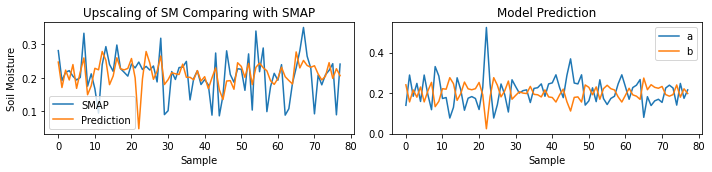

Epoch [481/5000] (LR: 1.220703125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


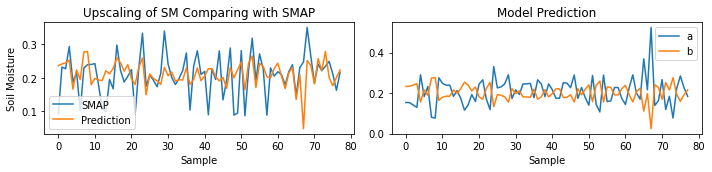

Epoch [482/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


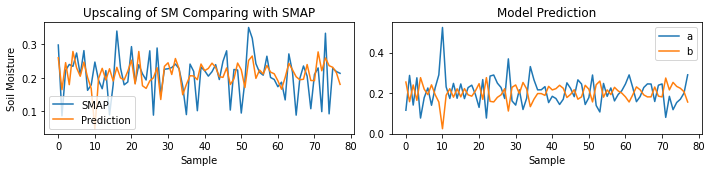

Epoch [483/5000] (LR: 1.220703125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


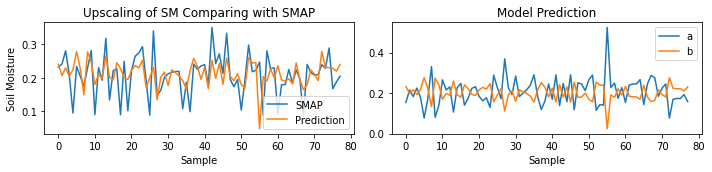

Epoch [484/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


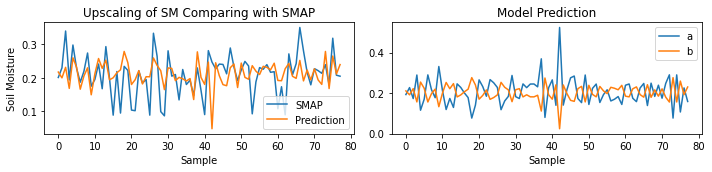

Epoch [485/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


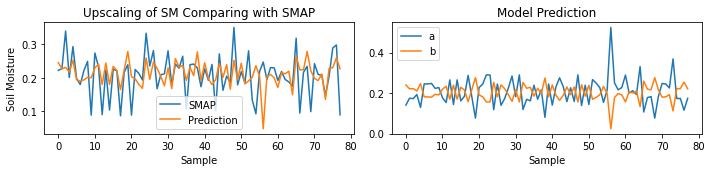

Epoch [486/5000] (LR: 1.220703125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


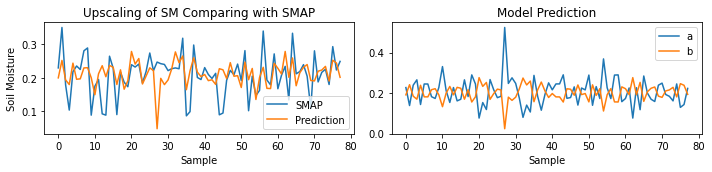

Epoch [487/5000] (LR: 1.220703125e-07):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


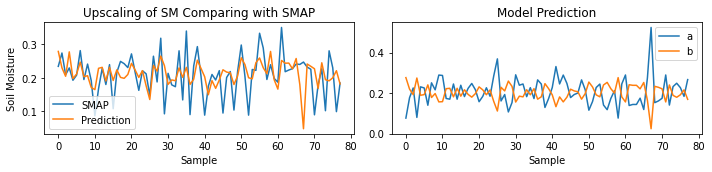

Epoch [488/5000] (LR: 1.220703125e-07):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


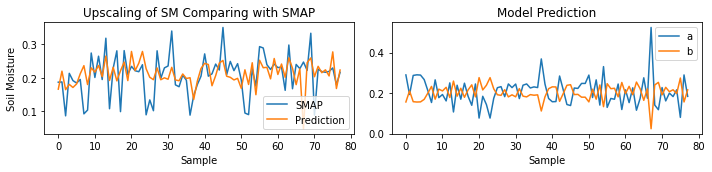

Epoch [489/5000] (LR: 6.103515625e-08):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


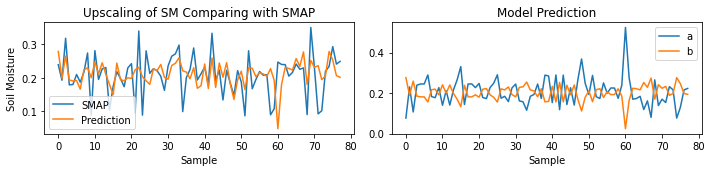

Epoch [490/5000] (LR: 6.103515625e-08):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


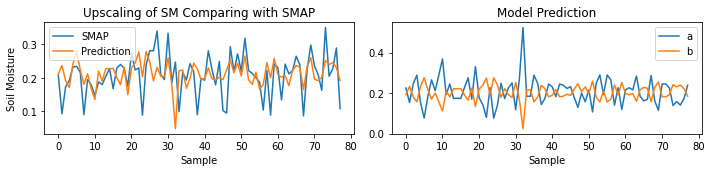

Epoch [491/5000] (LR: 6.103515625e-08):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


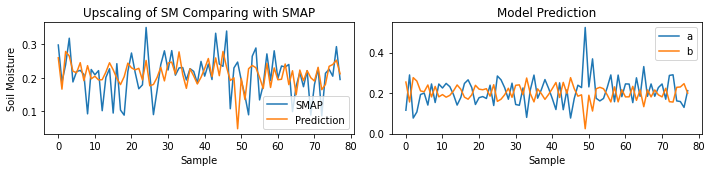

Epoch [492/5000] (LR: 6.103515625e-08):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


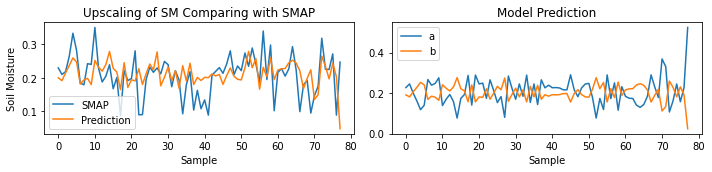

Epoch [493/5000] (LR: 6.103515625e-08):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


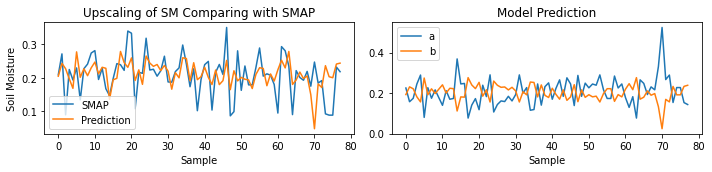

Epoch [494/5000] (LR: 6.103515625e-08):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


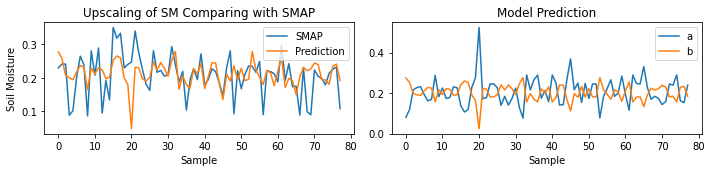

Epoch [495/5000] (LR: 6.103515625e-08):
Train loss: 0.0042 || Train physical loss: 0.0042 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


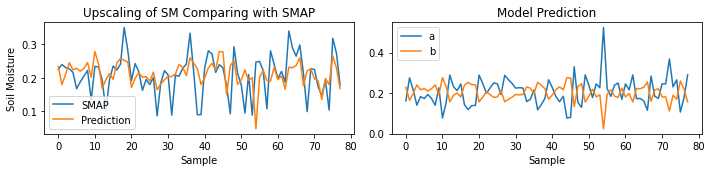

Epoch [496/5000] (LR: 6.103515625e-08):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


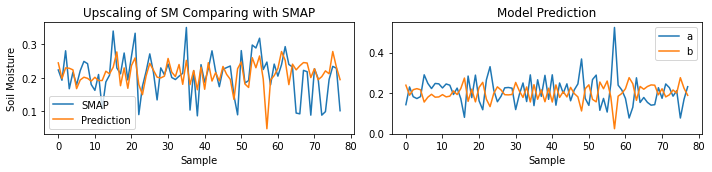

Epoch [497/5000] (LR: 6.103515625e-08):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


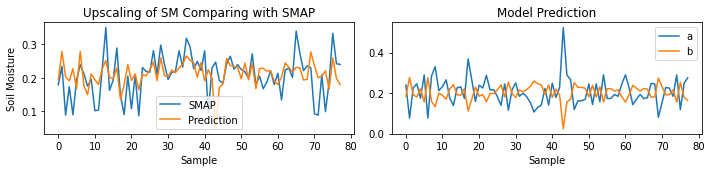

Epoch [498/5000] (LR: 6.103515625e-08):
Train loss: 0.0043 || Train physical loss: 0.0043 || Train similarity loss: 0.0000
Valid loss: 0.0034 || Valid physical loss: 0.0034 || Valid similarity loss: 0.0000


PermissionError: [Errno 13] Permission denied: 'validing.png'

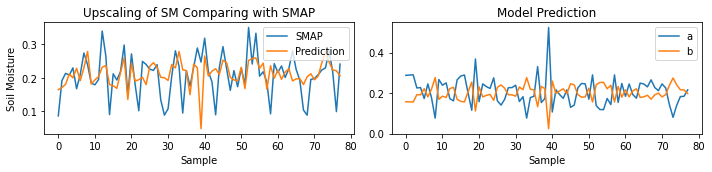

In [8]:
# 创建模型保存目录
if os.path.exists(config['model_save_dir'])==False:
    os.makedirs(config['model_save_dir'], exist_ok=True)
    
if config['is_train']==True:
    print(dataset.get_input_shape(0))
    model = SMCNN(input_channel=dataset.get_input_shape(0)[2]).to(device) # put your model and data on the same computation device.
    print(model)
    trainer(train_loader, valid_loader, model, config, device)

## Testing

In [ ]:
def tester(test_loader, model, config, device):
    relu = torch.nn.ReLU(inplace=True)
    criterion = physics_loss
    model.eval()
    loss_record = []
    pred_list = np.zeros((len(test_loader), 2))
    model.eval() 
    loss_record = []
    physical_loss_record = []
    sim_loss_record = []
    for data_pkg in valid_loader:
        x = data_pkg['processed_data']
        with torch.no_grad():
            pred = model(x)
            relu(pred[:, 0])
#             x, pred = x.to(device), pred.to(device)  
            physical_loss, sim_loss = criterion(pred, data_pkg['label_data'], 'Validing', config['sim_threshold'])
            loss = physical_loss + sim_loss

        physical_loss_record.append(physical_loss.item())
        sim_loss_record.append(sim_loss.item())
        loss_record.append(loss.item())

    mean_valid_physical_loss = sum(physical_loss_record)/len(physical_loss_record)
    mean_valid_sim_loss = sum(sim_loss_record)/len(sim_loss_record)
    mean_valid_loss = sum(loss_record)/len(loss_record)

    current_lr = (optimizer.param_groups[0])['lr']
    print(f'Epoch [{epoch+1}/{n_epochs}] (LR: {current_lr}):')
    print(f'Train loss: {mean_train_loss:.4f} || Train physical loss: {mean_train_physical_loss:.4f} || Train similarity loss: {mean_train_sim_loss:.4f}')
    print(f'Valid loss: {mean_valid_loss:.4f} || Valid physical loss: {mean_valid_physical_loss:.4f} || Valid similarity loss: {mean_valid_sim_loss:.4f}') 
    return loss_record, pred_list

In [ ]:
param_path = os.path.join(config['root'],'OUTPUT\\MODELS\\CNN\\first.ckpt' )
print(dataset.get_input_shape(0))
model = SMCNN(input_channel=dataset.get_input_shape(0)[2]).to(device)
print(model)
model.load_state_dict(torch.load(param_path))
loss_record, pred_list = tester(test_loader, model, config, device) 

In [ ]:
plt.plot(pred_list[:, 0], label='a')
plt.plot(pred_list[:, 1], label='b')
# 添加标题和标签
plt.title('Prediction of AB')
# plt.xlabel('Index of Model')
plt.legend()